# Connexion à l'environement Google

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Import des dépendances et des images

In [ ]:
import os
import numpy as np
import random
from PIL import Image
import matplotlib.pyplot as plt
from math import floor


def zero():
    return np.random.uniform(0.0, 0.01, size = [1])

def one():
    return np.random.uniform(0.99, 1.0, size = [1])

def noise(n):
    return np.random.uniform(-1.0, 1.0, size = [n, 4096])

import os
import zipfile
from PIL import Image
import numpy as np

print("Importing Images...")

Images = []
zip_file_path = "/content/drive/MyDrive/data/gan/images/birme_sport_tshirt_images_256x256.zip"
extracted_folder_path = "/content/drive/MyDrive/data/gan/images/birme_sport_tshirt_images_256x256"  # Chemin où les images d'entraînement seront extraites

# Extraction du fichier zip
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extracted_folder_path)

# Chargement des images
files = sorted([f for f in os.listdir(extracted_folder_path) if f.endswith('.jpg')])
for file_name in files:
    temp1 = Image.open(os.path.join(extracted_folder_path, file_name))
    temp = np.array(temp1.convert('RGB'), dtype='float32')
    Images.append(temp / 255)
    Images.append(np.flip(Images[-1], 1))


from keras.layers import Conv2D, LeakyReLU, BatchNormalization, Dense, AveragePooling2D, GaussianNoise
from keras.layers import Reshape, UpSampling2D, Activation, Dropout, Flatten, Conv2DTranspose
from keras.models import model_from_json, Sequential
from keras.optimizers import Adam
from keras.models import load_model





Importing Images...


# Création des classes GAN

In [ ]:

class GAN(object):

    def __init__(self):

        #Models
        self.D = None
        self.G = None

        self.OD = None

        self.DM = None
        self.AM = None

        #Config
        self.LR = 0.0001
        self.steps = 1

    def discriminator(self):

        if self.D:
            return self.D

        self.D = Sequential()

        #add Gaussian noise to prevent Discriminator overfitting
        self.D.add(GaussianNoise(0.2, input_shape = [256, 256, 3]))

        #256x256x3 Image
        self.D.add(Conv2D(filters = 8, kernel_size = 3, padding = 'same'))
        self.D.add(LeakyReLU(0.2))
        self.D.add(Dropout(0.25))
        self.D.add(AveragePooling2D())

        #128x128x8
        self.D.add(Conv2D(filters = 16, kernel_size = 3, padding = 'same'))
        self.D.add(BatchNormalization(momentum = 0.7))
        self.D.add(LeakyReLU(0.2))
        self.D.add(Dropout(0.25))
        self.D.add(AveragePooling2D())

        #64x64x16
        self.D.add(Conv2D(filters = 32, kernel_size = 3, padding = 'same'))
        self.D.add(BatchNormalization(momentum = 0.7))
        self.D.add(LeakyReLU(0.2))
        self.D.add(Dropout(0.25))
        self.D.add(AveragePooling2D())

        #32x32x32
        self.D.add(Conv2D(filters = 64, kernel_size = 3, padding = 'same'))
        self.D.add(BatchNormalization(momentum = 0.7))
        self.D.add(LeakyReLU(0.2))
        self.D.add(Dropout(0.25))
        self.D.add(AveragePooling2D())

        #16x16x64
        self.D.add(Conv2D(filters = 128, kernel_size = 3, padding = 'same'))
        self.D.add(BatchNormalization(momentum = 0.7))
        self.D.add(LeakyReLU(0.2))
        self.D.add(Dropout(0.25))
        self.D.add(AveragePooling2D())

        #8x8x128
        self.D.add(Conv2D(filters = 256, kernel_size = 3, padding = 'same'))
        self.D.add(BatchNormalization(momentum = 0.7))
        self.D.add(LeakyReLU(0.2))
        self.D.add(Dropout(0.25))
        self.D.add(AveragePooling2D())

        #4x4x256
        self.D.add(Flatten())

        #256
        self.D.add(Dense(128))
        self.D.add(LeakyReLU(0.2))

        self.D.add(Dense(1, activation = 'sigmoid'))

        return self.D

    def generator(self):

        if self.G:
            return self.G

        self.G = Sequential()

        self.G.add(Reshape(target_shape = [1, 1, 4096], input_shape = [4096]))

        #1x1x4096
        self.G.add(Conv2DTranspose(filters = 256, kernel_size = 4))
        self.G.add(Activation('relu'))

        #4x4x256 - kernel sized increased by 1
        self.G.add(Conv2D(filters = 256, kernel_size = 4, padding = 'same'))
        self.G.add(BatchNormalization(momentum = 0.7))
        self.G.add(Activation('relu'))
        self.G.add(UpSampling2D())

        #8x8x256 - kernel sized increased by 1
        self.G.add(Conv2D(filters = 128, kernel_size = 4, padding = 'same'))
        self.G.add(BatchNormalization(momentum = 0.7))
        self.G.add(Activation('relu'))
        self.G.add(UpSampling2D())

        #16x16x128
        self.G.add(Conv2D(filters = 64, kernel_size = 3, padding = 'same'))
        self.G.add(BatchNormalization(momentum = 0.7))
        self.G.add(Activation('relu'))
        self.G.add(UpSampling2D())

        #32x32x64
        self.G.add(Conv2D(filters = 32, kernel_size = 3, padding = 'same'))
        self.G.add(BatchNormalization(momentum = 0.7))
        self.G.add(Activation('relu'))
        self.G.add(UpSampling2D())

        #64x64x32
        self.G.add(Conv2D(filters = 16, kernel_size = 3, padding = 'same'))
        self.G.add(BatchNormalization(momentum = 0.7))
        self.G.add(Activation('relu'))
        self.G.add(UpSampling2D())

        #128x128x16
        self.G.add(Conv2D(filters = 8, kernel_size = 3, padding = 'same'))
        self.G.add(Activation('relu'))
        self.G.add(UpSampling2D())

        #256x256x8
        self.G.add(Conv2D(filters = 3, kernel_size = 3, padding = 'same'))
        self.G.add(Activation('sigmoid'))

        return self.G

    def DisModel(self):

        if self.DM == None:
            self.DM = Sequential()
            self.DM.add(self.discriminator())

        self.DM.compile(optimizer = Adam(lr = self.LR * (0.85 ** floor(self.steps / 10000))), loss = 'binary_crossentropy')

        return self.DM

    def AdModel(self):

        if self.AM == None:
            self.AM = Sequential()
            self.AM.add(self.generator())
            self.AM.add(self.discriminator())

        self.AM.compile(optimizer = Adam(lr = self.LR * (0.85 ** floor(self.steps / 10000))), loss = 'binary_crossentropy')

        return self.AM

    def sod(self):

        self.OD = self.D.get_weights()

    def lod(self):

        self.D.set_weights(self.OD)


In [ ]:
class Model_GAN(object):

    def __init__(self):
        self.GAN = GAN()
        self.DisModel = self.GAN.DisModel()
        self.AdModel = self.GAN.AdModel()
        self.generator = self.GAN.generator()

    def train(self, batch = 16):
        (a, b) = self.train_dis(batch)
        c = self.train_gen(batch)

        print(f"D Real: {str(a)}, D Fake: {str(b)}, G All: {str(c)}")

        if self.GAN.steps % 500 == 0:
            self.save(floor(self.GAN.steps / 1000))
            self.evaluate()

        if self.GAN.steps % 5000 == 0:
            self.GAN.AM = None
            self.GAN.DM = None
            self.AdModel = self.GAN.AdModel()
            self.DisModel = self.GAN.DisModel()

        self.GAN.steps = self.GAN.steps + 1

    def train_dis(self, batch):
        # Get Real Images
        im_no = random.randint(0, len(Images) - batch - 1)
        train_data = Images[im_no : im_no + int(batch / 2)]
        label_data = []
        for i in range(int(batch / 2)):
            label_data.append(zero())

        d_loss_real = self.DisModel.train_on_batch(np.array(train_data), np.array(label_data))

        # Get Fake Images
        train_data = self.generator.predict(noise(int(batch / 2)))
        label_data = []
        for i in range(int(batch / 2)):
            label_data.append(one())

        d_loss_fake = self.DisModel.train_on_batch(train_data, np.array(label_data))

        return (d_loss_real, d_loss_fake)

    def train_gen(self, batch):
        self.GAN.sod()
        label_data = []
        for i in range(int(batch)):
            label_data.append(zero())

        g_loss = self.AdModel.train_on_batch(noise(batch), np.array(label_data))

        self.GAN.lod()

        return g_loss

    def evaluate(self):
        im_no = random.randint(0, len(Images) - 1)
        im1 = Images[im_no]

        im2 = self.generator.predict(noise(2))

        plt.figure(1)
        plt.imshow(im1)

        plt.figure(2)
        plt.imshow(im2[0])

        plt.figure(3)
        plt.imshow(im2[1])

        plt.show()

    def save(self, num):
        gen_json = self.GAN.G.to_json()
        dis_json = self.GAN.D.to_json()

        with open("/content/drive/MyDrive/GAN_mardi/Models3/gen.json", "w+") as json_file:
            json_file.write(gen_json)

        with open("/content/drive/MyDrive/GAN_mardi/Models3/dis.json", "w+") as json_file:
            json_file.write(dis_json)

        self.GAN.G.save_weights("/content/drive/MyDrive/GAN_mardi/Models3/gen"+str(num)+".h5")
        self.GAN.D.save_weights("/content/drive/MyDrive/GAN_mardi/Models3/dis"+str(num)+".h5")

        print(f"Model number {str(num)} Saved!")

    def load(self, num):
        steps1 = self.GAN.steps

        self.GAN = None
        self.GAN = GAN()

        # Generator
        gen_file = open("/content/drive/MyDrive/GAN_mardi/Models3/gen.json", 'r')
        gen_json = gen_file.read()
        gen_file.close()

        self.GAN.G = model_from_json(gen_json)
        self.GAN.G.load_weights("/content/drive/MyDrive/GAN_mardi/Models3/gen"+str(num)+".h5")

        # Discriminator
        dis_file = open("/content/drive/MyDrive/GAN_mardi/Models3/dis.json", 'r')
        dis_json = dis_file.read()
        dis_file.close()

        self.GAN.D = model_from_json(dis_json)
        self.GAN.D.load_weights("/content/drive/MyDrive/GAN_mardi/Models3/dis"+str(num)+".h5")

        # Reinitialize
        self.generator = self.GAN.generator()
        self.DisModel = self.GAN.DisModel()
        self.AdModel = self.GAN.AdModel()

        self.GAN.steps = steps1

    def eval2(self, num = 0):
        im2 = self.generator.predict(noise(48))

        r1 = np.concatenate(im2[:8], axis = 1)
        r2 = np.concatenate(im2[8:16], axis = 1)
        r3 = np.concatenate(im2[16:24], axis = 1)
        r4 = np.concatenate(im2[24:32], axis = 1)
        r5 = np.concatenate(im2[32:40], axis = 1)
        r6 = np.concatenate(im2[40:48], axis = 1)

        c1 = np.concatenate([r1, r2, r3, r4, r5, r6], axis = 0)

        x = Image.fromarray(np.uint8(c1*255))

        x.save("/content/drive/MyDrive/GAN_mardi/Results3/i"+str(num)+".png")

In [ ]:
import os

if not os.path.exists('Results3'):
    os.mkdir('Results3')

if not os.path.exists('Models3'):
    os.mkdir('Models3')




# Entraînement du GAN

Ce code semble être une boucle d'apprentissage pour un modèle GAN (Generative Adversarial Network). Voici ce que fait chaque partie du code :

1. Initialisation du modèle GAN :
   - Un objet `Model_GAN` est créé. C'est probablement une classe qui encapsule à la fois le générateur (G) et le discriminateur (D) du GAN, ainsi que toutes les méthodes nécessaires pour l'entraînement.
   - Les résumés du modèle discriminatif (D) et du modèle générateur (G) sont imprimés, montrant les architectures des deux parties du GAN.

2. Boucle d'entraînement :
   - La boucle `while` exécute l'entraînement jusqu'à ce que le nombre d'itérations atteigne 500 000. Cela est contrôlé par la condition `model.GAN.steps < 500000`.
   - À chaque itération de la boucle :
     - Le modèle est entraîné avec `model.train()`, ce qui probablement effectue une itération d'entraînement pour le GAN. La façon dont cela est implémenté dépendrait des détails de la méthode `train()` dans la classe `Model_GAN`.
     - Si le nombre d'itérations est un multiple de 500, un message est imprimé pour indiquer le début d'un nouveau tour (`Round`).
     - Si le nombre d'itérations est un multiple de 1000, un message est imprimé et la méthode `eval2()` est appelée, probablement pour évaluer la performance du modèle à cette étape spécifique de l'entraînement.

En résumé, ce code effectue un entraînement itératif d'un modèle GAN, imprimant périodiquement des informations sur l'avancement de l'entraînement et évaluant périodiquement le modèle à certaines étapes.

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gaussian_noise_1 (Gaussian  (None, 256, 256, 3)       0         
 Noise)                                                          
                                                                 
 conv2d_13 (Conv2D)          (None, 256, 256, 8)       224       
                                                                 
 leaky_re_lu_7 (LeakyReLU)   (None, 256, 256, 8)       0         
                                                                 
 dropout_6 (Dropout)         (None, 256, 256, 8)       0         
                                                                 
 average_pooling2d_6 (Avera  (None, 128, 128, 8)       0         
 gePooling2D)                                                    
                                                                 
 conv2d_14 (Conv2D)          (None, 128, 128, 16)     

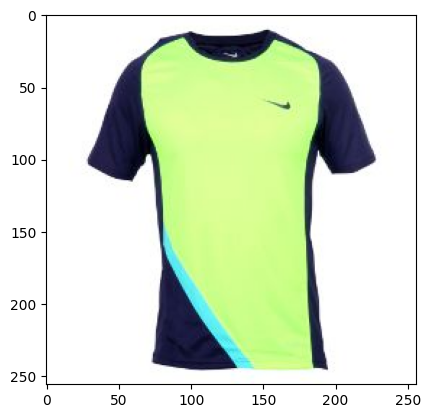

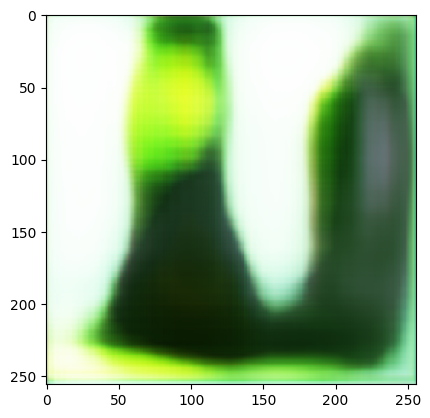

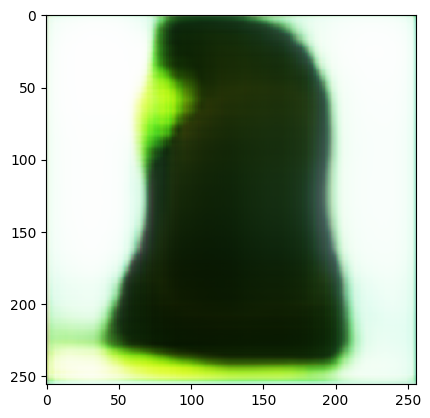

1/1 [==============================] - 0s 20ms/step
D Real: 0.27509579062461853, D Fake: 0.06407497078180313, G All: 3.0146517753601074
1/1 [==============================] - 0s 18ms/step
D Real: 0.04881565272808075, D Fake: 0.7324187159538269, G All: 3.9095983505249023
1/1 [==============================] - 0s 17ms/step
D Real: 0.08061882853507996, D Fake: 0.1125759556889534, G All: 6.173025131225586
1/1 [==============================] - 0s 17ms/step
D Real: 0.21623964607715607, D Fake: 0.042790818959474564, G All: 7.189699172973633
1/1 [==============================] - 0s 16ms/step
D Real: 0.30721884965896606, D Fake: 0.04790478199720383, G All: 7.213273048400879
1/1 [==============================] - 0s 17ms/step
D Real: 0.15195855498313904, D Fake: 0.039547860622406006, G All: 6.903409957885742
1/1 [==============================] - 0s 17ms/step
D Real: 0.31596994400024414, D Fake: 0.11063219606876373, G All: 4.865516662597656
1/1 [==============================] - 0s 17ms/step
D

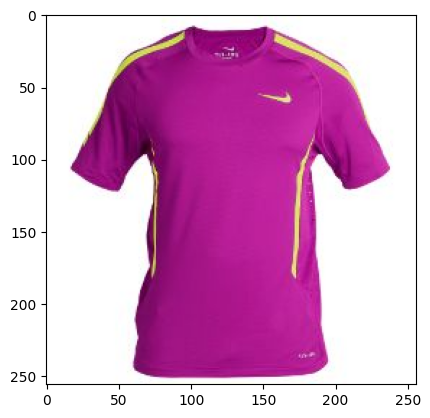

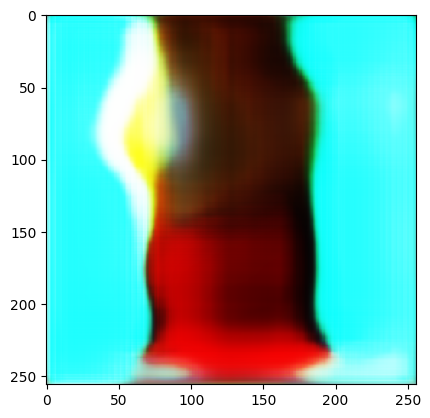

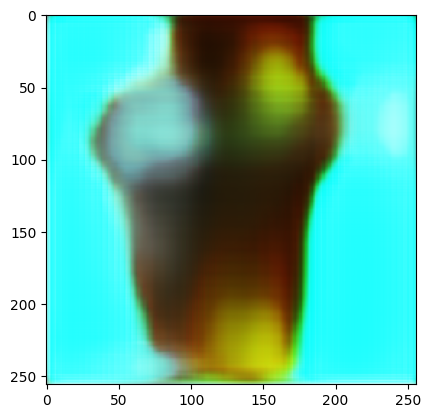

1/1 [==============================] - 0s 19ms/step
D Real: 0.12114861607551575, D Fake: 0.04518415033817291, G All: 5.11279821395874
1/1 [==============================] - 0s 17ms/step
D Real: 0.07656575739383698, D Fake: 0.03664762154221535, G All: 4.538128852844238
1/1 [==============================] - 0s 19ms/step
D Real: 0.05211424455046654, D Fake: 0.09955810755491257, G All: 4.325494766235352
1/1 [==============================] - 0s 17ms/step
D Real: 0.15855659544467926, D Fake: 0.18681450188159943, G All: 3.752730369567871
1/1 [==============================] - 0s 18ms/step
D Real: 0.03341381251811981, D Fake: 0.09645776450634003, G All: 3.742790699005127
1/1 [==============================] - 0s 17ms/step
D Real: 0.041603535413742065, D Fake: 0.10020707547664642, G All: 3.2294235229492188
1/1 [==============================] - 0s 19ms/step
D Real: 0.06596782803535461, D Fake: 0.09486564993858337, G All: 2.6558592319488525
1/1 [==============================] - 0s 17ms/step
D

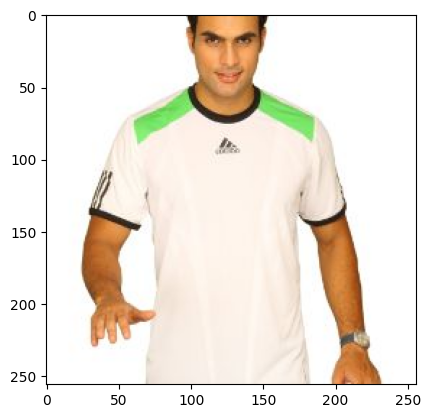

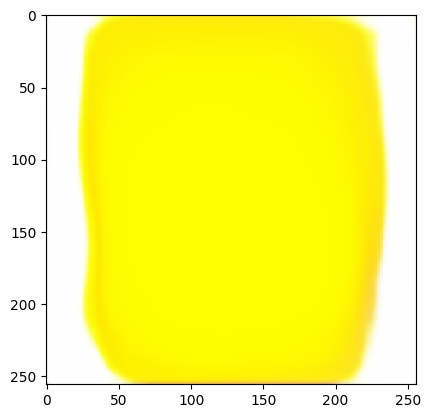

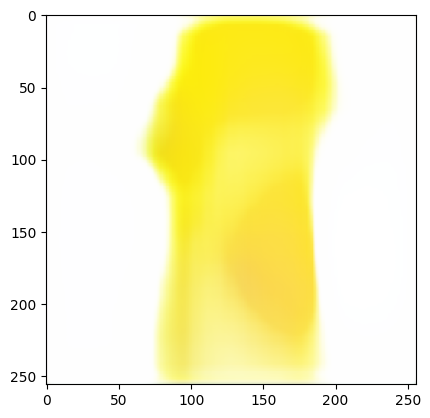

1/1 [==============================] - 0s 18ms/step
D Real: 0.038392793387174606, D Fake: 0.11494415998458862, G All: 3.612898826599121
1/1 [==============================] - 0s 19ms/step
D Real: 0.20932504534721375, D Fake: 0.04991615191102028, G All: 4.312681674957275
1/1 [==============================] - 0s 18ms/step
D Real: 0.8169940710067749, D Fake: 0.038546327501535416, G All: 3.7027664184570312
1/1 [==============================] - 0s 17ms/step
D Real: 0.08398590981960297, D Fake: 0.05026308819651604, G All: 3.47621488571167
1/1 [==============================] - 0s 19ms/step
D Real: 0.0347670279443264, D Fake: 0.07052665948867798, G All: 3.2224340438842773
1/1 [==============================] - 0s 16ms/step
D Real: 0.17985624074935913, D Fake: 0.09815596789121628, G All: 3.153031349182129
1/1 [==============================] - 0s 18ms/step
D Real: 0.050058137625455856, D Fake: 0.05051349848508835, G All: 3.1264171600341797
1/1 [==============================] - 0s 18ms/step


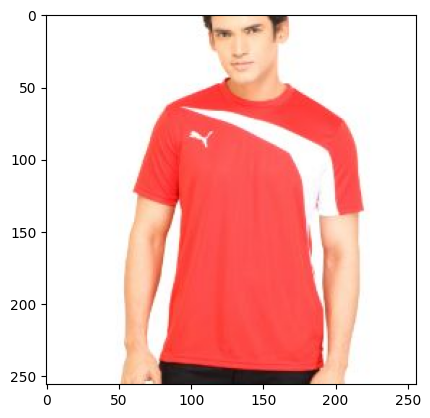

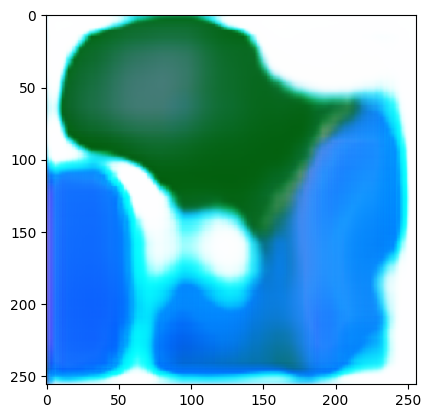

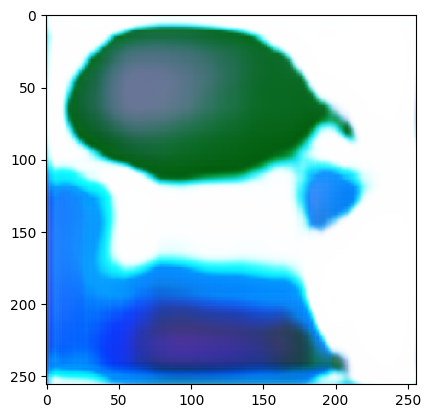

1/1 [==============================] - 0s 18ms/step
D Real: 0.047191474586725235, D Fake: 0.03603095933794975, G All: 6.792008399963379
1/1 [==============================] - 0s 18ms/step
D Real: 0.03690234571695328, D Fake: 0.05706866458058357, G All: 6.43214225769043
1/1 [==============================] - 0s 17ms/step
D Real: 0.5964171290397644, D Fake: 0.30737337470054626, G All: 2.616056442260742
1/1 [==============================] - 0s 17ms/step
D Real: 0.0836026668548584, D Fake: 1.0073524713516235, G All: 2.1967835426330566
1/1 [==============================] - 0s 18ms/step
D Real: 0.12861722707748413, D Fake: 0.12252694368362427, G All: 4.919506072998047
1/1 [==============================] - 0s 19ms/step
D Real: 0.05850210785865784, D Fake: 0.047379396855831146, G All: 5.876084804534912
1/1 [==============================] - 0s 18ms/step
D Real: 0.28759148716926575, D Fake: 0.16978996992111206, G All: 6.858194351196289
1/1 [==============================] - 0s 17ms/step
D Re

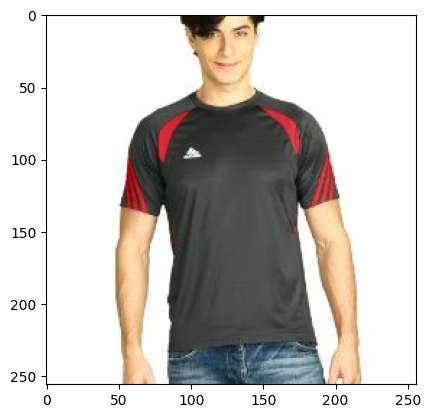

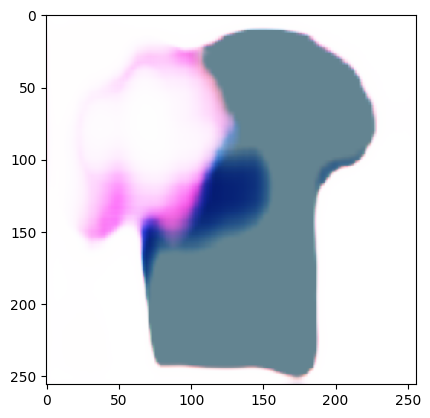

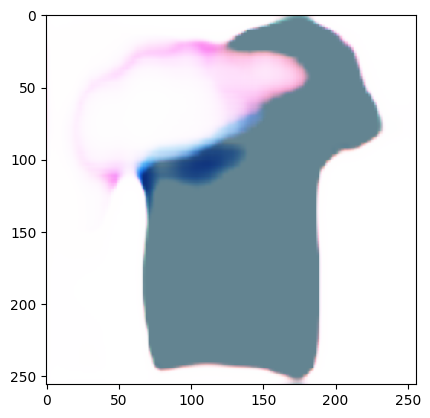

1/1 [==============================] - 0s 18ms/step
D Real: 1.3207439184188843, D Fake: 0.045060254633426666, G All: 5.7604475021362305
1/1 [==============================] - 0s 16ms/step
D Real: 0.8128612637519836, D Fake: 0.056797947734594345, G All: 4.103580951690674
1/1 [==============================] - 0s 17ms/step
D Real: 0.05490214750170708, D Fake: 0.07741238176822662, G All: 2.084453582763672
1/1 [==============================] - 0s 17ms/step
D Real: 0.03724001348018646, D Fake: 0.4956401288509369, G All: 1.4778772592544556
1/1 [==============================] - 0s 17ms/step
D Real: 0.08447599411010742, D Fake: 0.3064400553703308, G All: 2.2352895736694336
1/1 [==============================] - 0s 18ms/step
D Real: 0.06631927192211151, D Fake: 0.1599462628364563, G All: 2.487464189529419
1/1 [==============================] - 0s 17ms/step
D Real: 0.05148199200630188, D Fake: 0.08769050240516663, G All: 3.039259910583496
1/1 [==============================] - 0s 17ms/step
D R

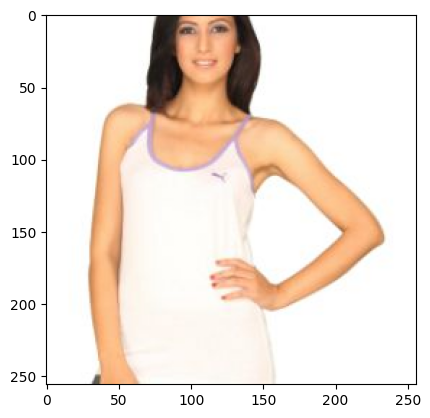

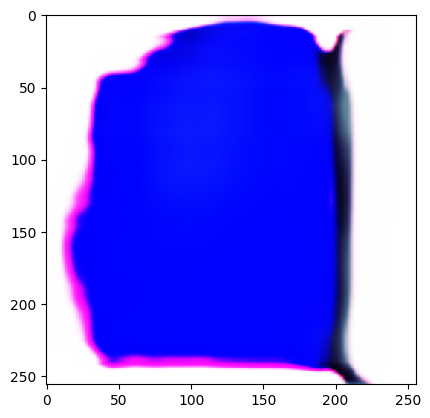

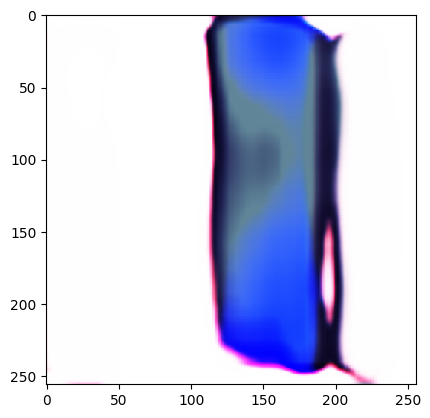

1/1 [==============================] - 0s 18ms/step
D Real: 0.05952835828065872, D Fake: 0.49837711453437805, G All: 2.7922255992889404
1/1 [==============================] - 0s 18ms/step
D Real: 0.06587214767932892, D Fake: 0.10512058436870575, G All: 3.818107843399048
1/1 [==============================] - 0s 18ms/step
D Real: 0.31670790910720825, D Fake: 0.08154977858066559, G All: 2.155701160430908
1/1 [==============================] - 0s 18ms/step
D Real: 0.04766671732068062, D Fake: 0.06414277851581573, G All: 2.8794941902160645
1/1 [==============================] - 0s 17ms/step
D Real: 0.05730525404214859, D Fake: 0.10207659006118774, G All: 2.887864828109741
1/1 [==============================] - 0s 17ms/step
D Real: 0.05628614500164986, D Fake: 0.46347343921661377, G All: 3.1046366691589355
1/1 [==============================] - 0s 17ms/step
D Real: 0.04557257518172264, D Fake: 0.04158331826329231, G All: 5.0891571044921875
1/1 [==============================] - 0s 18ms/step

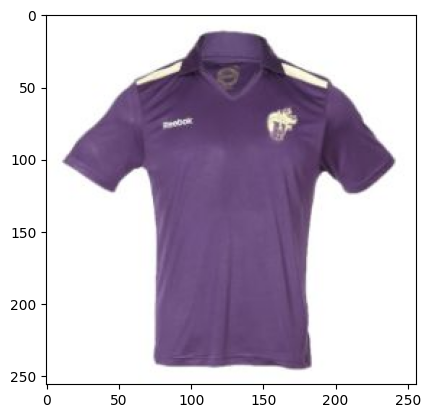

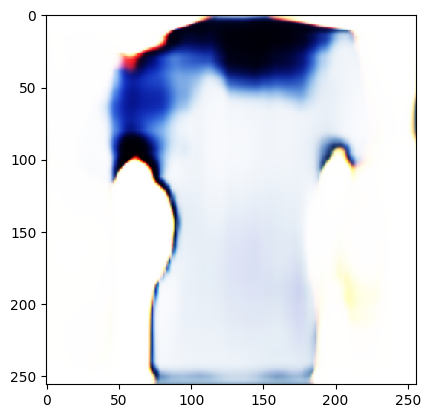

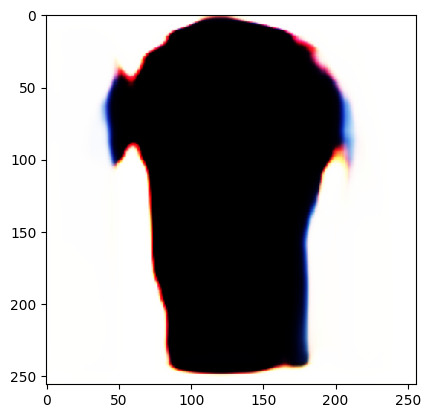

1/1 [==============================] - 0s 17ms/step
D Real: 0.36189836263656616, D Fake: 0.1143801286816597, G All: 3.2107858657836914
1/1 [==============================] - 0s 17ms/step
D Real: 0.048650845885276794, D Fake: 0.22096040844917297, G All: 3.443166732788086
1/1 [==============================] - 0s 17ms/step
D Real: 0.32300445437431335, D Fake: 0.16897402703762054, G All: 2.5867037773132324
1/1 [==============================] - 0s 18ms/step
D Real: 0.037367239594459534, D Fake: 0.1478414088487625, G All: 3.7396469116210938
1/1 [==============================] - 0s 17ms/step
D Real: 0.19232985377311707, D Fake: 0.17234116792678833, G All: 3.286314010620117
1/1 [==============================] - 0s 19ms/step
D Real: 0.47562241554260254, D Fake: 0.1422436535358429, G All: 3.3138062953948975
1/1 [==============================] - 0s 17ms/step
D Real: 0.03357790410518646, D Fake: 0.17453651130199432, G All: 3.526747941970825
1/1 [==============================] - 0s 18ms/step


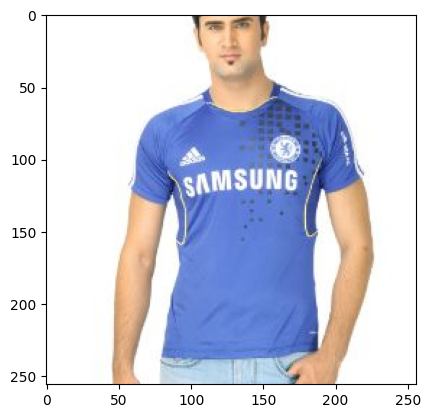

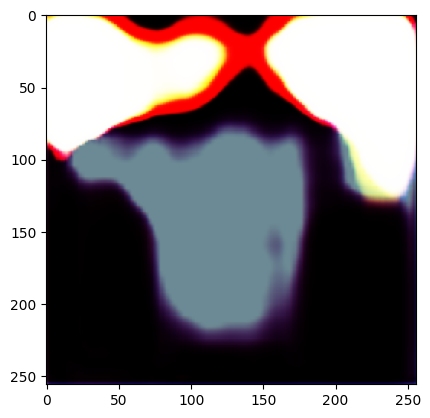

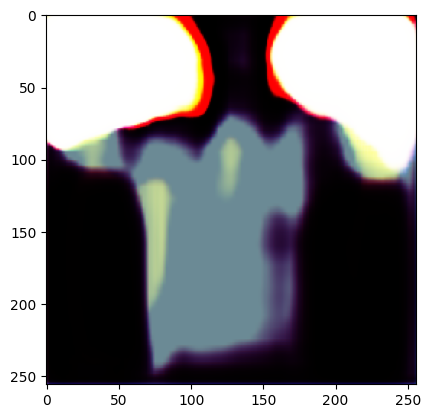

1/1 [==============================] - 0s 18ms/step
D Real: 0.03717693313956261, D Fake: 0.0457732267677784, G All: 7.915109634399414
1/1 [==============================] - 0s 17ms/step
D Real: 0.05543078854680061, D Fake: 0.06161181628704071, G All: 8.804787635803223
1/1 [==============================] - 0s 18ms/step
D Real: 0.16154368221759796, D Fake: 0.1534208059310913, G All: 9.656463623046875
1/1 [==============================] - 0s 18ms/step
D Real: 0.050714120268821716, D Fake: 0.06724301725625992, G All: 9.339925765991211
1/1 [==============================] - 0s 18ms/step
D Real: 0.045742496848106384, D Fake: 0.05723761394619942, G All: 9.775123596191406
1/1 [==============================] - 0s 19ms/step
D Real: 0.0376725047826767, D Fake: 0.041799161583185196, G All: 10.18159008026123
1/1 [==============================] - 0s 17ms/step
D Real: 0.040685441344976425, D Fake: 0.06470207124948502, G All: 9.191719055175781
1/1 [==============================] - 0s 17ms/step
D 

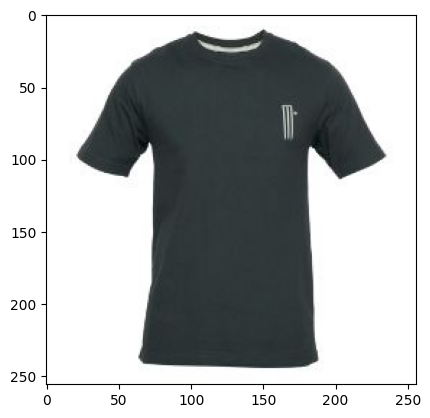

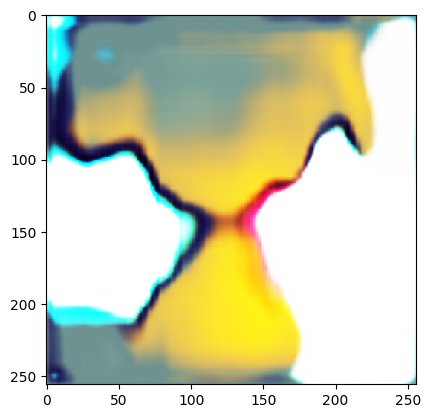

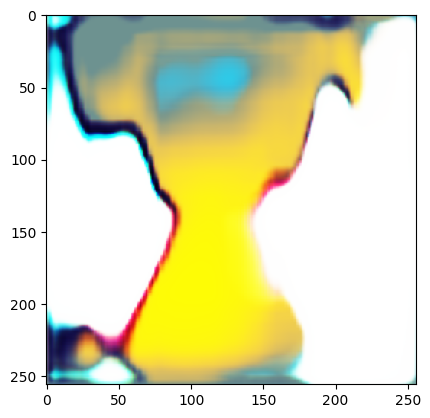

1/1 [==============================] - 0s 19ms/step
D Real: 0.0527670755982399, D Fake: 0.07220381498336792, G All: 4.4791975021362305
1/1 [==============================] - 0s 17ms/step
D Real: 0.028742708265781403, D Fake: 0.05902968719601631, G All: 4.923897743225098
1/1 [==============================] - 0s 18ms/step
D Real: 0.03708096593618393, D Fake: 0.30963262915611267, G All: 5.391254901885986
1/1 [==============================] - 0s 18ms/step
D Real: 0.04677186161279678, D Fake: 0.056366391479969025, G All: 5.62753963470459
1/1 [==============================] - 0s 18ms/step
D Real: 0.5981431603431702, D Fake: 0.04697398468852043, G All: 6.237054824829102
1/1 [==============================] - 0s 18ms/step
D Real: 0.3255641460418701, D Fake: 0.0255149994045496, G All: 5.829067230224609
1/1 [==============================] - 0s 17ms/step
D Real: 0.05225663259625435, D Fake: 0.03739068657159805, G All: 6.099301815032959
1/1 [==============================] - 0s 17ms/step
D Rea

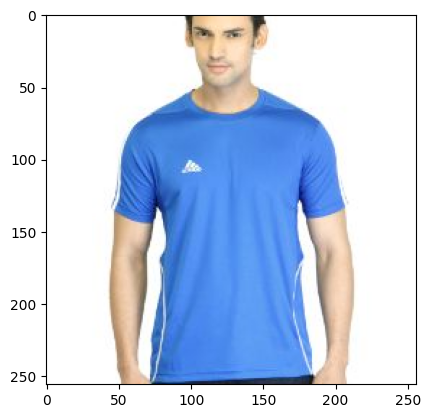

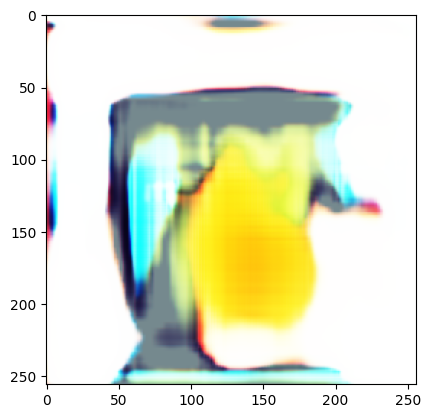

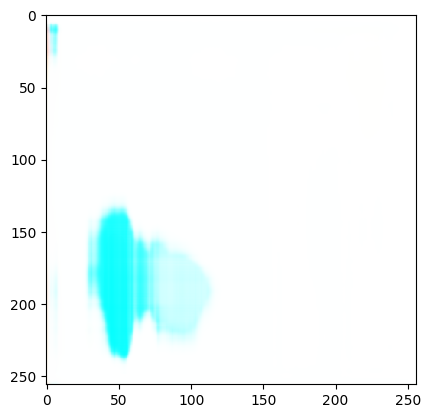

1/1 [==============================] - 0s 17ms/step
D Real: 0.05027293786406517, D Fake: 0.0320434533059597, G All: 4.923921585083008
1/1 [==============================] - 0s 17ms/step
D Real: 0.048096854239702225, D Fake: 0.03502032160758972, G All: 5.1140594482421875
1/1 [==============================] - 0s 17ms/step
D Real: 0.07814967632293701, D Fake: 0.06153586506843567, G All: 5.711130619049072
1/1 [==============================] - 0s 17ms/step
D Real: 0.8497876524925232, D Fake: 0.02623889595270157, G All: 5.660569190979004
1/1 [==============================] - 0s 16ms/step
D Real: 0.05947771668434143, D Fake: 0.06048005446791649, G All: 4.858160495758057
1/1 [==============================] - 0s 17ms/step
D Real: 0.0280342698097229, D Fake: 0.06026717275381088, G All: 4.899919509887695
1/1 [==============================] - 0s 19ms/step
D Real: 0.026517342776060104, D Fake: 0.09004809707403183, G All: 5.136767387390137
1/1 [==============================] - 0s 18ms/step
D R

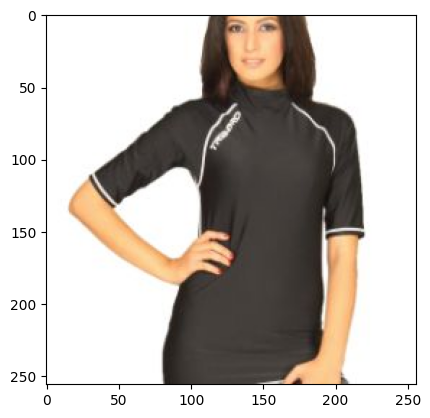

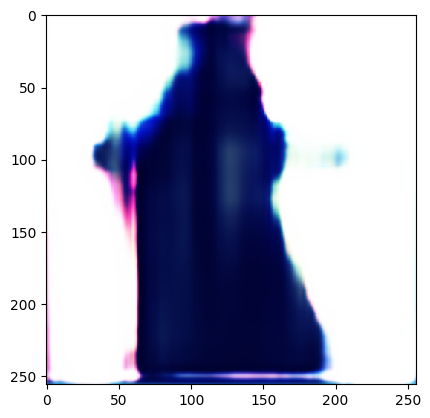

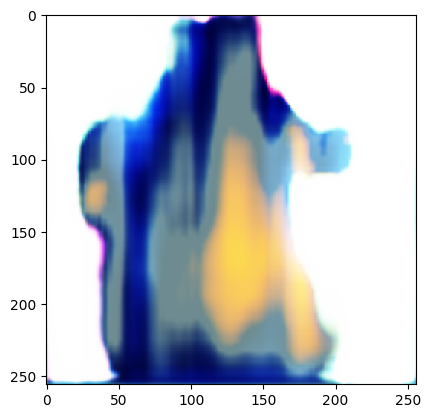

1/1 [==============================] - 0s 19ms/step
D Real: 0.35625922679901123, D Fake: 0.17736685276031494, G All: 3.0515100955963135
1/1 [==============================] - 0s 18ms/step
D Real: 0.033554378896951675, D Fake: 0.10078983753919601, G All: 3.5051350593566895
1/1 [==============================] - 0s 19ms/step
D Real: 0.22962504625320435, D Fake: 0.08436541259288788, G All: 3.516620635986328
1/1 [==============================] - 0s 18ms/step
D Real: 0.5956628322601318, D Fake: 0.05376337468624115, G All: 3.3684065341949463
1/1 [==============================] - 0s 18ms/step
D Real: 0.7198664546012878, D Fake: 0.04929342865943909, G All: 2.929572820663452
1/1 [==============================] - 0s 19ms/step
D Real: 0.04517955332994461, D Fake: 0.09329243749380112, G All: 2.893281936645508
1/1 [==============================] - 0s 18ms/step
D Real: 0.34618648886680603, D Fake: 0.08318756520748138, G All: 2.710392951965332
1/1 [==============================] - 0s 19ms/step
D

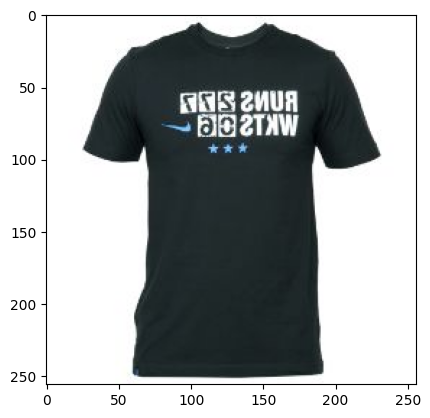

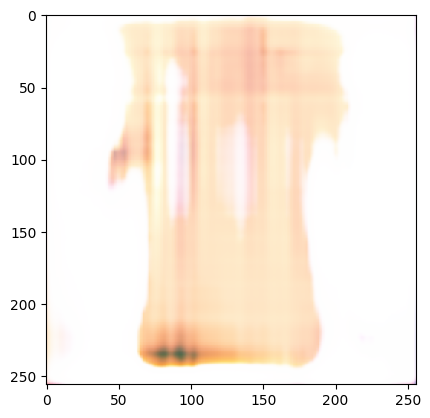

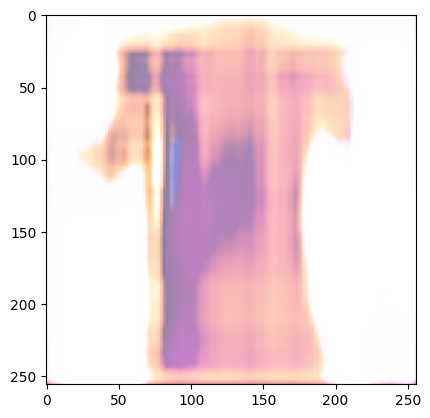

1/1 [==============================] - 0s 18ms/step
D Real: 0.05266658589243889, D Fake: 0.06841176748275757, G All: 3.028364658355713
1/1 [==============================] - 0s 17ms/step
D Real: 0.049532413482666016, D Fake: 0.05150273069739342, G All: 2.4364380836486816
1/1 [==============================] - 0s 17ms/step
D Real: 0.05070015788078308, D Fake: 0.10548057407140732, G All: 3.420555830001831
1/1 [==============================] - 0s 17ms/step
D Real: 0.6641150712966919, D Fake: 0.11365523189306259, G All: 1.2241296768188477
1/1 [==============================] - 0s 17ms/step
D Real: 0.041208453476428986, D Fake: 0.638536810874939, G All: 2.26170015335083
1/1 [==============================] - 0s 17ms/step
D Real: 0.03789249807596207, D Fake: 0.26640135049819946, G All: 3.2404191493988037
1/1 [==============================] - 0s 17ms/step
D Real: 0.6493224501609802, D Fake: 0.3207405209541321, G All: 3.2653982639312744
1/1 [==============================] - 0s 17ms/step
D R

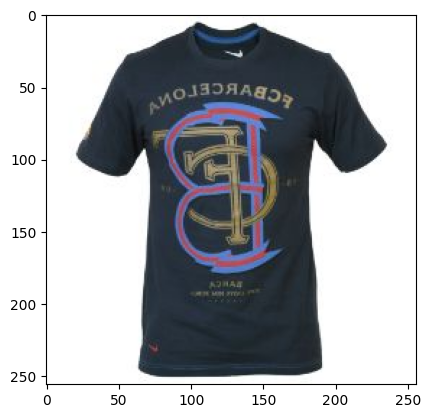

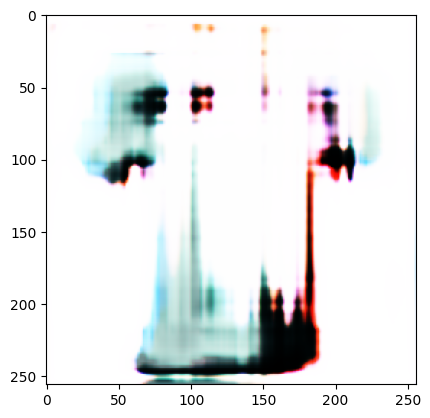

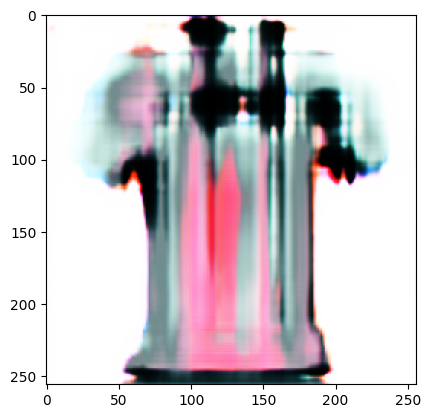

1/1 [==============================] - 0s 19ms/step
D Real: 0.22048762440681458, D Fake: 0.9674228429794312, G All: 2.1133296489715576
1/1 [==============================] - 0s 19ms/step
D Real: 0.06050315499305725, D Fake: 0.27627938985824585, G All: 2.632542371749878
1/1 [==============================] - 0s 20ms/step
D Real: 0.08131386339664459, D Fake: 0.7582361698150635, G All: 3.1290900707244873
1/1 [==============================] - 0s 19ms/step
D Real: 0.38217979669570923, D Fake: 0.24471433460712433, G All: 3.213637351989746
1/1 [==============================] - 0s 20ms/step
D Real: 0.03590639680624008, D Fake: 0.08486750721931458, G All: 3.2558321952819824
1/1 [==============================] - 0s 19ms/step
D Real: 1.5012147426605225, D Fake: 0.1991339921951294, G All: 3.4045698642730713
1/1 [==============================] - 0s 19ms/step
D Real: 0.45722389221191406, D Fake: 0.07594670355319977, G All: 2.745633602142334
1/1 [==============================] - 0s 18ms/step
D R

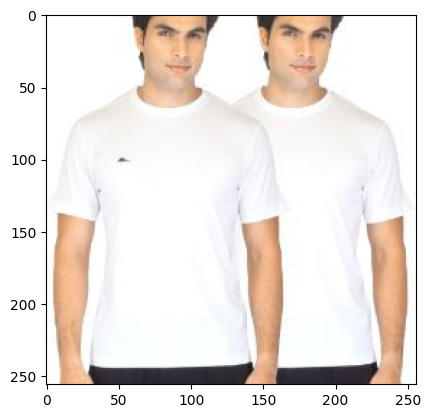

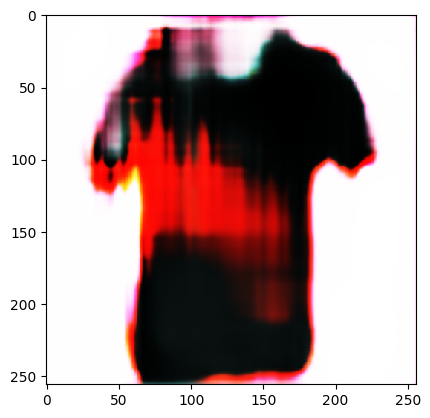

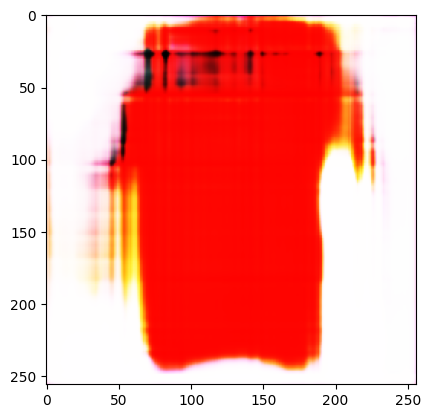

1/1 [==============================] - 0s 19ms/step
D Real: 1.6726702451705933, D Fake: 0.06815902143716812, G All: 2.460299253463745
1/1 [==============================] - 0s 17ms/step
D Real: 0.04093117266893387, D Fake: 0.2344459891319275, G All: 0.8972170352935791
1/1 [==============================] - 0s 18ms/step
D Real: 0.36856406927108765, D Fake: 1.4134529829025269, G All: 1.3343031406402588
1/1 [==============================] - 0s 17ms/step
D Real: 0.0329074002802372, D Fake: 0.21038734912872314, G All: 2.787482500076294
1/1 [==============================] - 0s 18ms/step
D Real: 1.6916823387145996, D Fake: 0.14158496260643005, G All: 2.3211965560913086
1/1 [==============================] - 0s 18ms/step
D Real: 0.06719185411930084, D Fake: 0.09675906598567963, G All: 2.382617950439453
1/1 [==============================] - 0s 17ms/step
D Real: 0.6098490953445435, D Fake: 0.08400985598564148, G All: 2.4533565044403076
1/1 [==============================] - 0s 17ms/step
D Rea

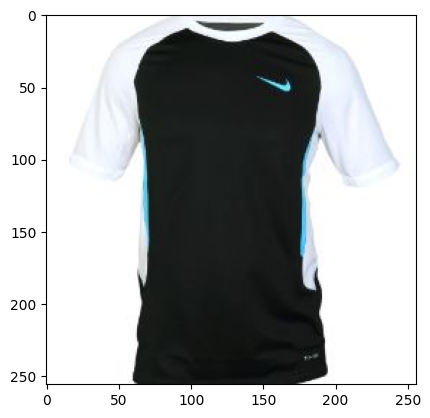

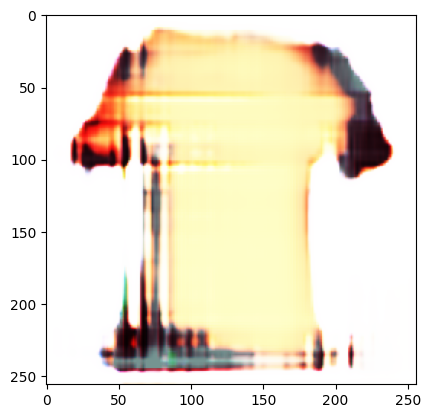

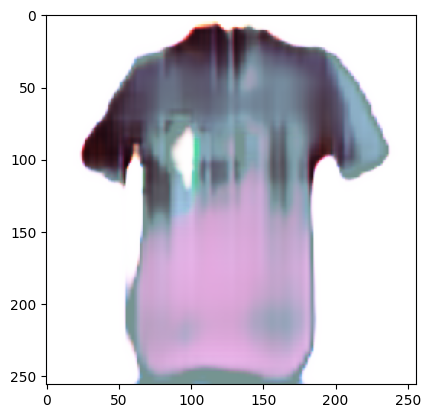

1/1 [==============================] - 0s 20ms/step
D Real: 0.12949605286121368, D Fake: 0.2994508743286133, G All: 1.0726779699325562
1/1 [==============================] - 0s 20ms/step
D Real: 0.8614832162857056, D Fake: 1.00557279586792, G All: 0.8087192177772522
1/1 [==============================] - 0s 21ms/step
D Real: 0.06053858995437622, D Fake: 0.864700198173523, G All: 1.428185224533081
1/1 [==============================] - 0s 20ms/step
D Real: 0.11018942296504974, D Fake: 0.37328019738197327, G All: 1.4385700225830078
1/1 [==============================] - 0s 21ms/step
D Real: 0.20606887340545654, D Fake: 0.6214289665222168, G All: 1.8218327760696411
1/1 [==============================] - 0s 21ms/step
D Real: 0.04879231005907059, D Fake: 0.20933204889297485, G All: 2.250417709350586
1/1 [==============================] - 0s 21ms/step
D Real: 0.06354881823062897, D Fake: 0.060018718242645264, G All: 2.8717658519744873
1/1 [==============================] - 0s 20ms/step
D Rea

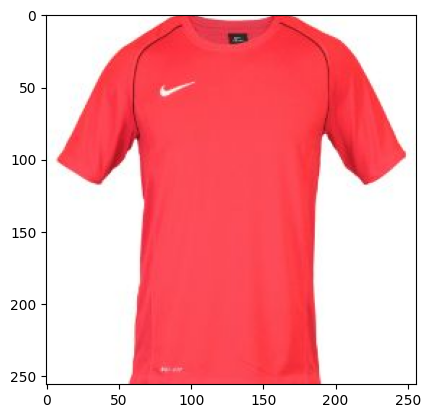

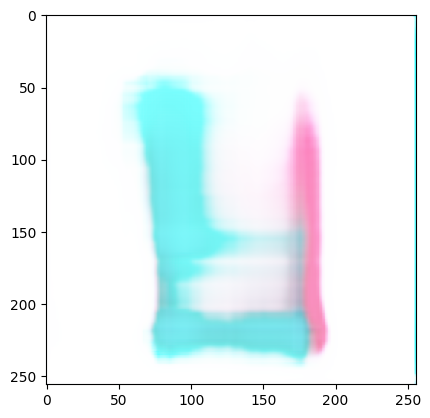

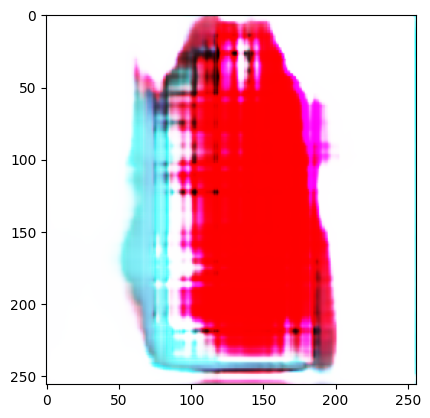

1/1 [==============================] - 0s 19ms/step
D Real: 0.07308594882488251, D Fake: 0.2264544516801834, G All: 2.1389317512512207
1/1 [==============================] - 0s 18ms/step
D Real: 0.03283433988690376, D Fake: 0.5667851567268372, G All: 1.932692289352417
1/1 [==============================] - 0s 17ms/step
D Real: 0.06341201812028885, D Fake: 0.14289076626300812, G All: 2.590160608291626
1/1 [==============================] - 0s 18ms/step
D Real: 0.05620303750038147, D Fake: 0.053768087178468704, G All: 2.779139757156372
1/1 [==============================] - 0s 19ms/step
D Real: 0.05012829601764679, D Fake: 0.08492352068424225, G All: 3.405339241027832
1/1 [==============================] - 0s 19ms/step
D Real: 0.05578284710645676, D Fake: 0.06171039491891861, G All: 2.772671937942505
1/1 [==============================] - 0s 19ms/step
D Real: 1.0094698667526245, D Fake: 0.09996035695075989, G All: 3.2862913608551025
1/1 [==============================] - 0s 17ms/step
D R

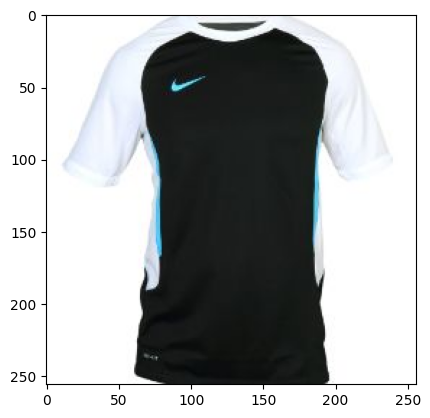

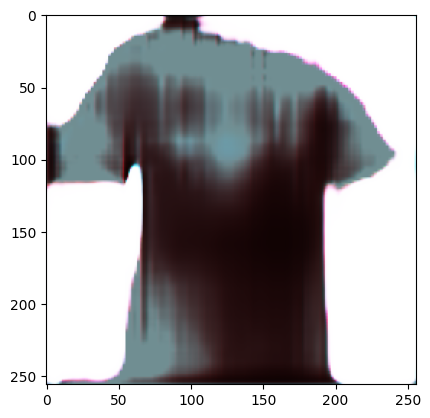

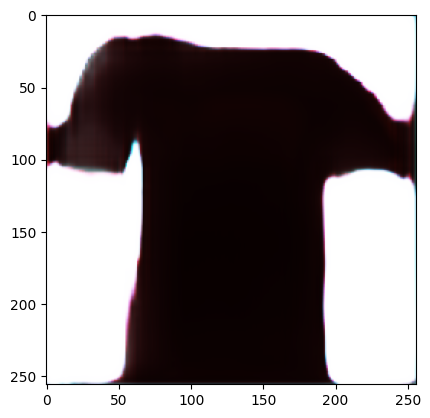

1/1 [==============================] - 0s 23ms/step
D Real: 0.1334754228591919, D Fake: 0.034122709184885025, G All: 5.053884029388428
1/1 [==============================] - 0s 22ms/step
D Real: 0.048391446471214294, D Fake: 0.03123391605913639, G All: 5.141416549682617
1/1 [==============================] - 0s 22ms/step
D Real: 0.04371432587504387, D Fake: 0.04841059446334839, G All: 5.485153675079346
1/1 [==============================] - 0s 27ms/step
D Real: 0.23749549686908722, D Fake: 0.04144196957349777, G All: 4.665872573852539
1/1 [==============================] - 0s 21ms/step
D Real: 0.035930294543504715, D Fake: 0.02983742766082287, G All: 4.967592239379883
1/1 [==============================] - 0s 21ms/step
D Real: 0.39100566506385803, D Fake: 0.12405234575271606, G All: 3.2745776176452637
1/1 [==============================] - 0s 21ms/step
D Real: 0.08466160297393799, D Fake: 0.1310770958662033, G All: 3.048809766769409
1/1 [==============================] - 0s 21ms/step
D

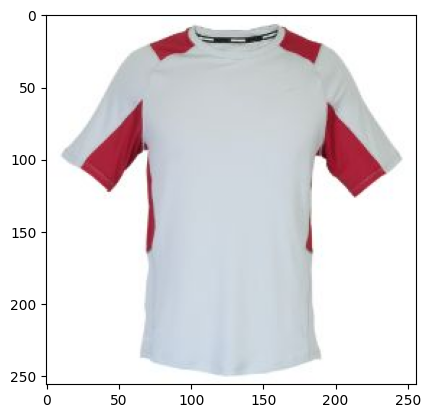

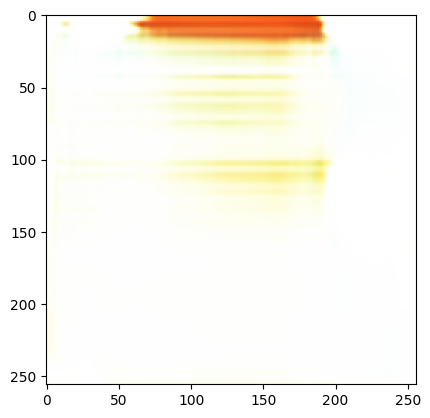

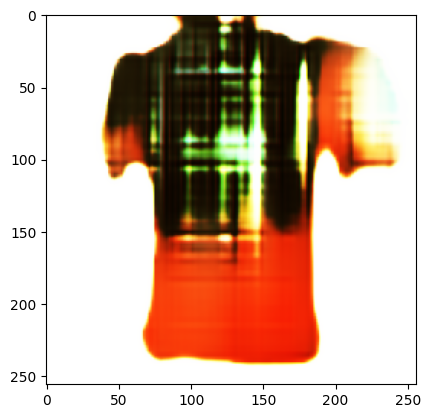

1/1 [==============================] - 0s 19ms/step
D Real: 0.05088401585817337, D Fake: 0.07613128423690796, G All: 2.293811798095703
1/1 [==============================] - 0s 19ms/step
D Real: 0.04259277880191803, D Fake: 0.28445014357566833, G All: 2.2373433113098145
1/1 [==============================] - 0s 18ms/step
D Real: 0.031172381713986397, D Fake: 0.10919453203678131, G All: 2.218118190765381
1/1 [==============================] - 0s 18ms/step
D Real: 1.131083369255066, D Fake: 0.300056129693985, G All: 2.107793092727661
1/1 [==============================] - 0s 18ms/step
D Real: 0.07513278722763062, D Fake: 0.17349527776241302, G All: 1.9251799583435059
1/1 [==============================] - 0s 20ms/step
D Real: 0.0557623952627182, D Fake: 0.20830607414245605, G All: 2.215355157852173
1/1 [==============================] - 0s 17ms/step
D Real: 0.06615491956472397, D Fake: 0.06932826340198517, G All: 2.1375486850738525
1/1 [==============================] - 0s 20ms/step
D Re

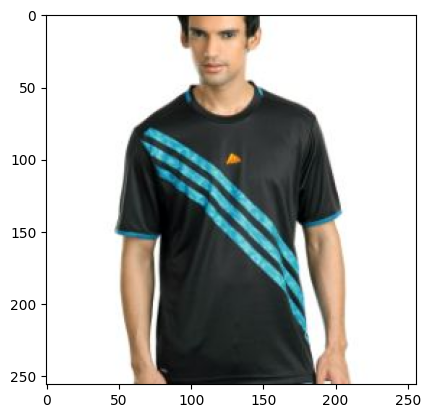

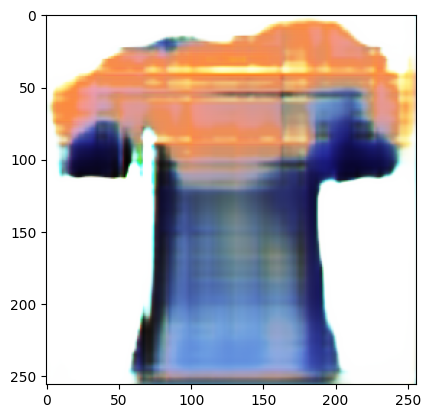

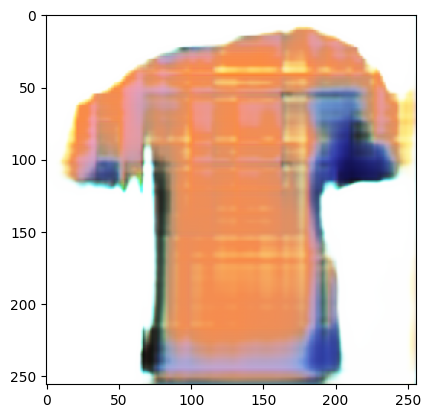

1/1 [==============================] - 0s 24ms/step
D Real: 0.5015050768852234, D Fake: 0.21634715795516968, G All: 3.2544264793395996
1/1 [==============================] - 0s 17ms/step
D Real: 1.027992844581604, D Fake: 0.061777982860803604, G All: 3.352632999420166
1/1 [==============================] - 0s 17ms/step
D Real: 0.030111467465758324, D Fake: 0.08891327679157257, G All: 3.193422794342041
1/1 [==============================] - 0s 17ms/step
D Real: 0.03033841773867607, D Fake: 0.06998920440673828, G All: 3.3355093002319336
1/1 [==============================] - 0s 17ms/step
D Real: 0.03483549505472183, D Fake: 0.15141689777374268, G All: 3.334138870239258
1/1 [==============================] - 0s 17ms/step
D Real: 0.4275737404823303, D Fake: 0.06251842528581619, G All: 2.458314895629883
1/1 [==============================] - 0s 17ms/step
D Real: 0.06690001487731934, D Fake: 0.23248115181922913, G All: 2.282484769821167
1/1 [==============================] - 0s 17ms/step
D R

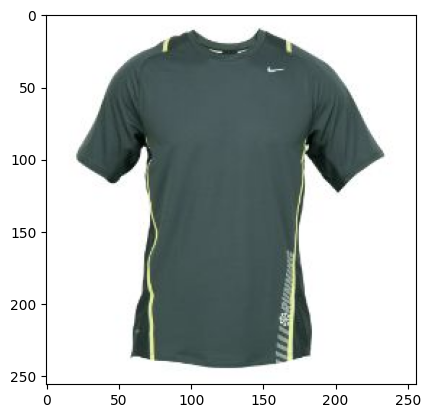

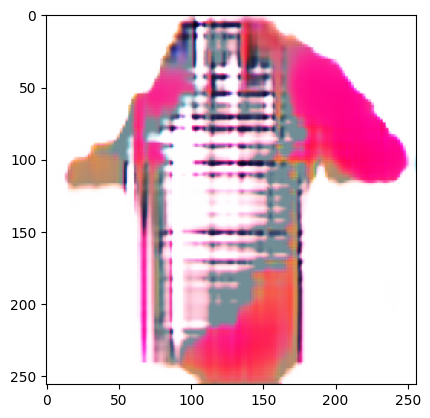

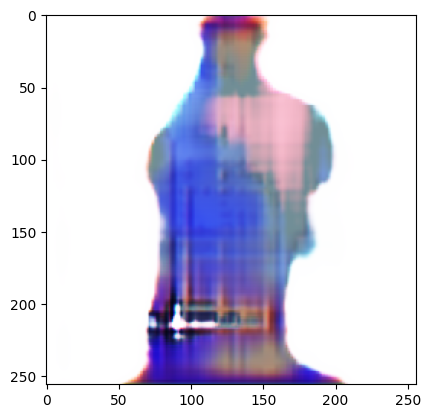

1/1 [==============================] - 0s 17ms/step
D Real: 0.06415826827287674, D Fake: 0.12782873213291168, G All: 3.537214756011963
1/1 [==============================] - 0s 18ms/step
D Real: 0.04654717072844505, D Fake: 0.04272283986210823, G All: 3.6860969066619873
1/1 [==============================] - 0s 17ms/step
D Real: 0.04662005603313446, D Fake: 0.09528477489948273, G All: 4.575134754180908
1/1 [==============================] - 0s 17ms/step
D Real: 0.1159265786409378, D Fake: 0.09464624524116516, G All: 4.352450370788574
1/1 [==============================] - 0s 17ms/step
D Real: 0.06404177844524384, D Fake: 0.030120890587568283, G All: 4.963916778564453
1/1 [==============================] - 0s 17ms/step
D Real: 0.036515478044748306, D Fake: 0.039238736033439636, G All: 3.8195204734802246
1/1 [==============================] - 0s 17ms/step
D Real: 0.04211214929819107, D Fake: 0.06415332108736038, G All: 3.6191048622131348
1/1 [==============================] - 0s 17ms/ste

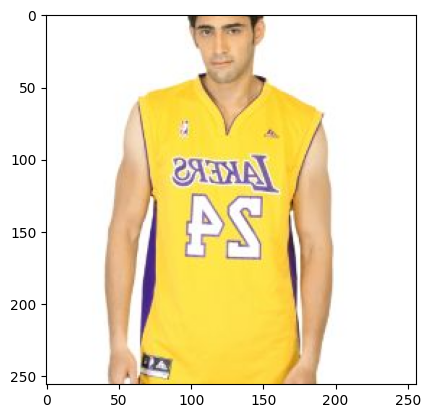

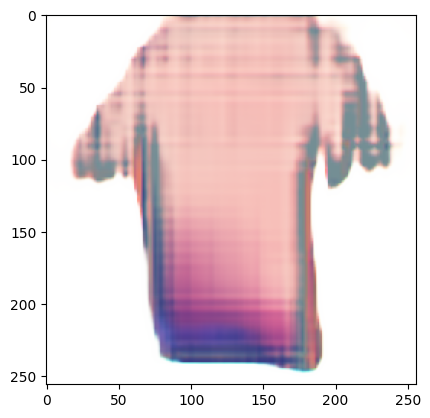

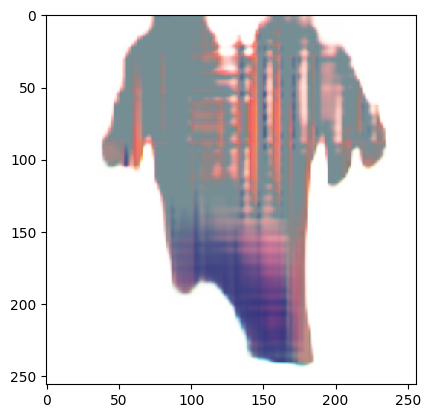

1/1 [==============================] - 0s 20ms/step
D Real: 0.03231331706047058, D Fake: 0.3306801915168762, G All: 3.2955851554870605
1/1 [==============================] - 0s 19ms/step
D Real: 0.1671196073293686, D Fake: 0.08624231070280075, G All: 2.9230501651763916
1/1 [==============================] - 0s 20ms/step
D Real: 0.05181349068880081, D Fake: 0.08084677159786224, G All: 3.4860854148864746
1/1 [==============================] - 0s 19ms/step
D Real: 0.09810701012611389, D Fake: 0.16426585614681244, G All: 4.245057106018066
1/1 [==============================] - 0s 19ms/step
D Real: 0.09444765746593475, D Fake: 0.031265005469322205, G All: 4.3589677810668945
1/1 [==============================] - 0s 19ms/step
D Real: 0.5667423009872437, D Fake: 0.041327062994241714, G All: 4.391552448272705
1/1 [==============================] - 0s 25ms/step
D Real: 0.058618322014808655, D Fake: 0.03402962535619736, G All: 3.4526095390319824
1/1 [==============================] - 0s 21ms/ste

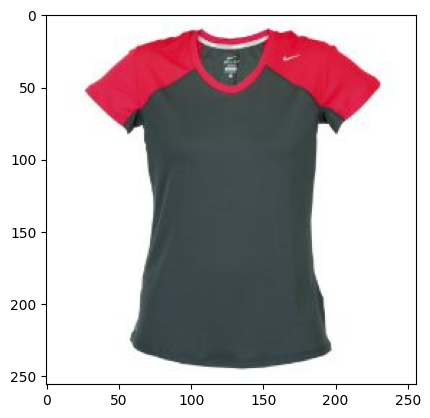

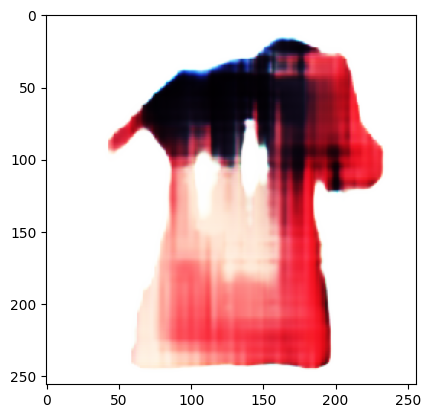

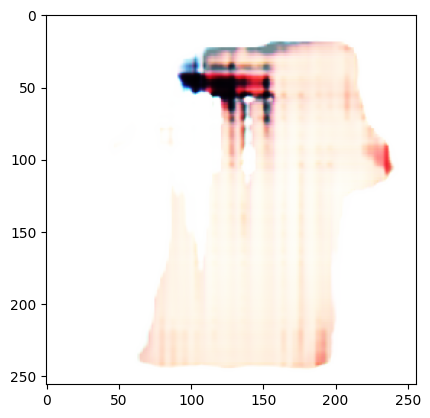

1/1 [==============================] - 0s 21ms/step
D Real: 0.0345059409737587, D Fake: 0.04211641103029251, G All: 3.9053378105163574
1/1 [==============================] - 0s 20ms/step
D Real: 3.087508201599121, D Fake: 0.18302978575229645, G All: 3.8032515048980713
1/1 [==============================] - 0s 26ms/step
D Real: 0.031873755156993866, D Fake: 0.13024765253067017, G All: 3.8453524112701416
1/1 [==============================] - 0s 18ms/step
D Real: 0.07390689104795456, D Fake: 0.11717409640550613, G All: 3.0892117023468018
1/1 [==============================] - 0s 19ms/step
D Real: 0.5642386078834534, D Fake: 0.3418467938899994, G All: 2.005065441131592
1/1 [==============================] - 0s 18ms/step
D Real: 0.9061151742935181, D Fake: 0.35733455419540405, G All: 2.142198085784912
1/1 [==============================] - 0s 20ms/step
D Real: 0.4187433123588562, D Fake: 0.3126494884490967, G All: 1.17179274559021
1/1 [==============================] - 0s 20ms/step
D Real:

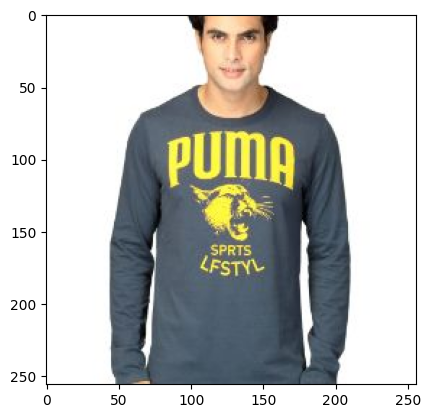

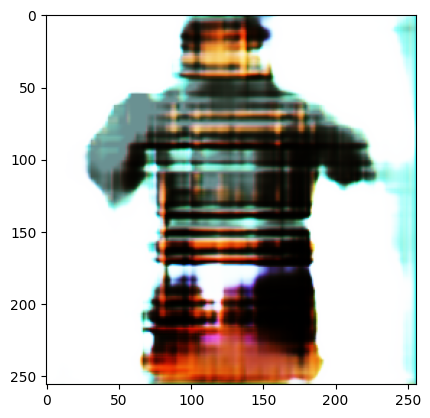

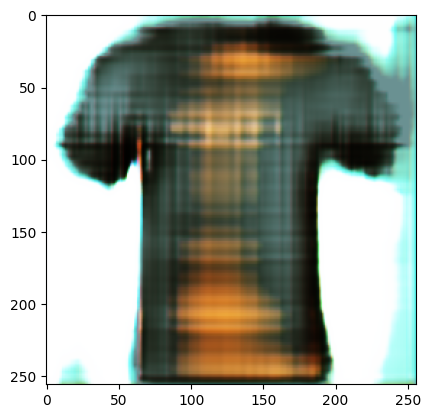

1/1 [==============================] - 0s 22ms/step
D Real: 0.06233387067914009, D Fake: 0.09194688498973846, G All: 3.2876741886138916
1/1 [==============================] - 0s 20ms/step
D Real: 0.04271869361400604, D Fake: 0.11411226540803909, G All: 2.809948682785034
1/1 [==============================] - 0s 21ms/step
D Real: 0.04839880391955376, D Fake: 0.0968061089515686, G All: 3.347423791885376
1/1 [==============================] - 0s 20ms/step
D Real: 0.044192515313625336, D Fake: 0.055376455187797546, G All: 3.3068456649780273
1/1 [==============================] - 0s 20ms/step
D Real: 0.026032235473394394, D Fake: 0.14808805286884308, G All: 3.3141984939575195
1/1 [==============================] - 0s 21ms/step
D Real: 0.05612776428461075, D Fake: 0.0745096206665039, G All: 3.187560558319092
1/1 [==============================] - 0s 21ms/step
D Real: 0.03500790148973465, D Fake: 0.10125724971294403, G All: 3.8987860679626465
1/1 [==============================] - 0s 20ms/ste

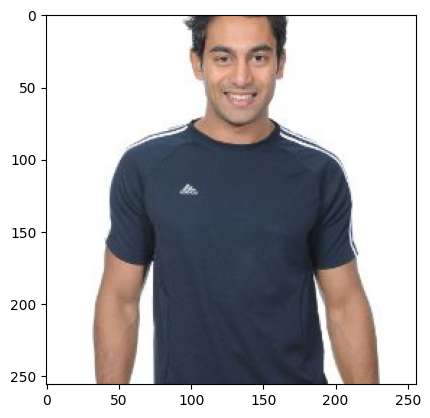

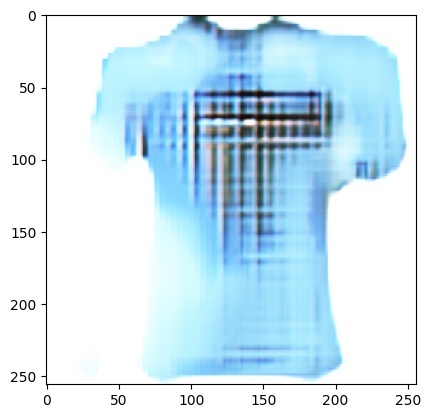

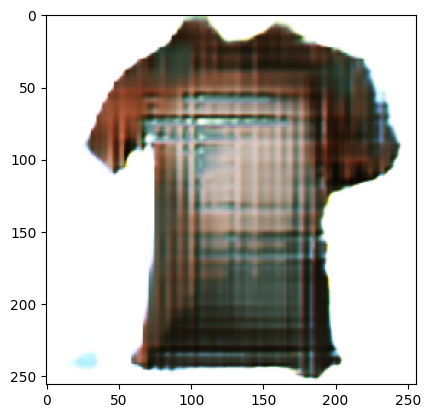

1/1 [==============================] - 0s 19ms/step
D Real: 0.03244568780064583, D Fake: 1.307734489440918, G All: 3.652559280395508
1/1 [==============================] - 0s 17ms/step
D Real: 0.06385430693626404, D Fake: 0.12405699491500854, G All: 4.350341796875
1/1 [==============================] - 0s 18ms/step
D Real: 0.6870365738868713, D Fake: 0.04150651767849922, G All: 5.394786834716797
1/1 [==============================] - 0s 19ms/step
D Real: 0.5273195505142212, D Fake: 0.03564871847629547, G All: 4.9455647468566895
1/1 [==============================] - 0s 17ms/step
D Real: 0.3195236921310425, D Fake: 0.0265642236918211, G All: 5.318169116973877
1/1 [==============================] - 0s 20ms/step
D Real: 0.16749678552150726, D Fake: 0.0302275363355875, G All: 5.761734485626221
1/1 [==============================] - 0s 18ms/step
D Real: 0.10823816806077957, D Fake: 0.030686138197779655, G All: 5.402350425720215
1/1 [==============================] - 0s 17ms/step
D Real: 0.0

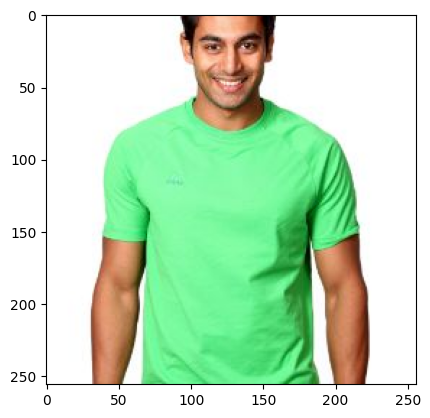

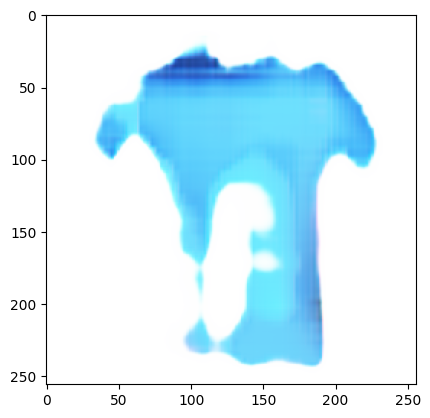

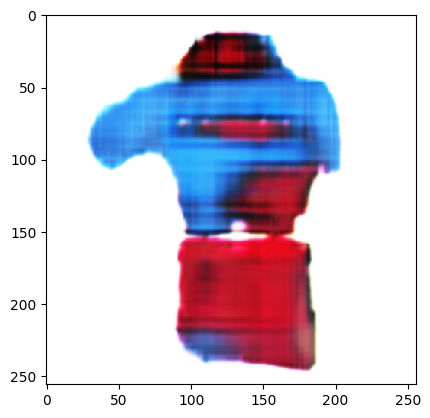

1/1 [==============================] - 0s 22ms/step
D Real: 0.033164605498313904, D Fake: 0.12896278500556946, G All: 1.7665884494781494
1/1 [==============================] - 0s 22ms/step
D Real: 0.05518200993537903, D Fake: 0.5540982484817505, G All: 1.3883764743804932
1/1 [==============================] - 0s 22ms/step
D Real: 0.05187545716762543, D Fake: 0.10879433155059814, G All: 2.4431190490722656
1/1 [==============================] - 0s 22ms/step
D Real: 0.14793983101844788, D Fake: 0.288827508687973, G All: 2.6609256267547607
1/1 [==============================] - 0s 22ms/step
D Real: 0.027275558561086655, D Fake: 0.061640556901693344, G All: 2.3844165802001953
1/1 [==============================] - 0s 22ms/step
D Real: 0.07189741730690002, D Fake: 0.12944413721561432, G All: 1.905348300933838
1/1 [==============================] - 0s 24ms/step
D Real: 0.15117931365966797, D Fake: 0.07377851009368896, G All: 3.048053741455078
1/1 [==============================] - 0s 23ms/ste

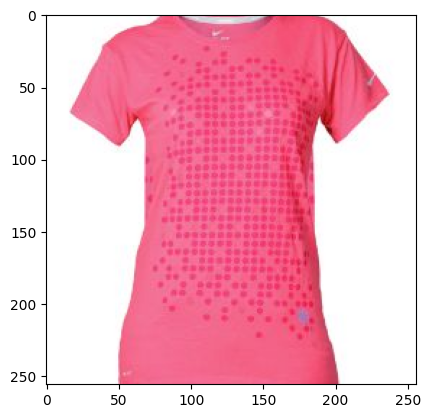

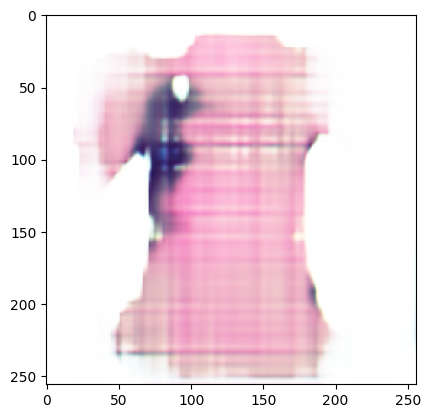

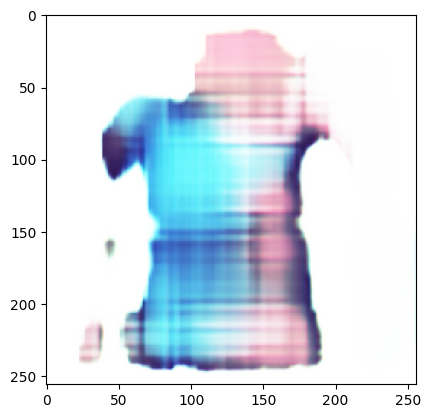

1/1 [==============================] - 0s 21ms/step
D Real: 0.05269318073987961, D Fake: 1.2623530626296997, G All: 1.5958690643310547
1/1 [==============================] - 0s 18ms/step
D Real: 0.05748458206653595, D Fake: 0.7229372262954712, G All: 2.546884536743164
1/1 [==============================] - 0s 19ms/step
D Real: 0.05312321335077286, D Fake: 0.03684782609343529, G All: 3.541604518890381
1/1 [==============================] - 0s 19ms/step
D Real: 0.03138493001461029, D Fake: 0.04123880714178085, G All: 4.857473850250244
1/1 [==============================] - 0s 19ms/step
D Real: 0.13358311355113983, D Fake: 0.036886438727378845, G All: 4.763266563415527
1/1 [==============================] - 0s 21ms/step
D Real: 0.04321342334151268, D Fake: 0.04692927747964859, G All: 4.853809356689453
1/1 [==============================] - 0s 20ms/step
D Real: 0.03722132742404938, D Fake: 0.04653086140751839, G All: 5.242591857910156
1/1 [==============================] - 0s 21ms/step
D R

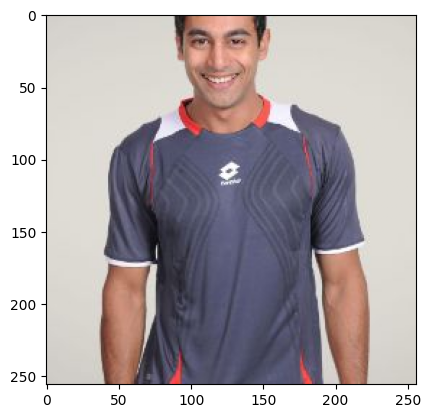

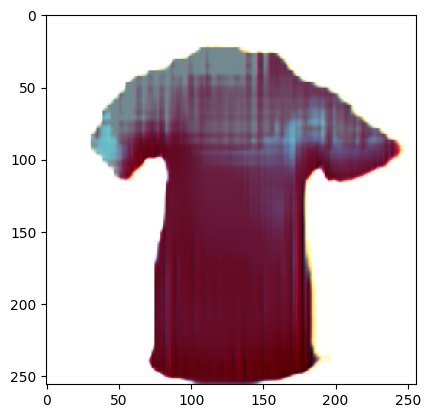

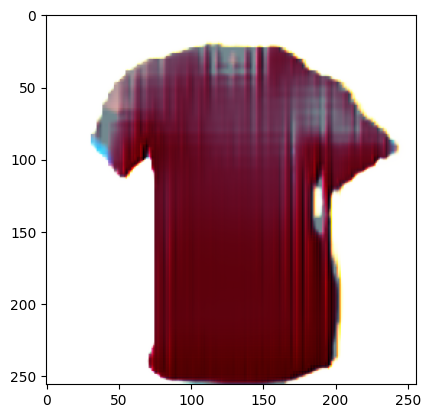

1/1 [==============================] - 0s 18ms/step
D Real: 0.04880797117948532, D Fake: 0.09876085817813873, G All: 2.5750081539154053
1/1 [==============================] - 0s 17ms/step
D Real: 0.03695899620652199, D Fake: 0.09240102767944336, G All: 2.059262752532959
1/1 [==============================] - 0s 18ms/step
D Real: 0.04947531595826149, D Fake: 0.2010345458984375, G All: 2.3252768516540527
1/1 [==============================] - 0s 17ms/step
D Real: 0.47961506247520447, D Fake: 0.5428550839424133, G All: 2.089845657348633
1/1 [==============================] - 0s 17ms/step
D Real: 0.030784863978624344, D Fake: 0.05718354508280754, G All: 2.244347095489502
1/1 [==============================] - 0s 17ms/step
D Real: 0.19408926367759705, D Fake: 0.14014318585395813, G All: 2.879641056060791
1/1 [==============================] - 0s 17ms/step
D Real: 2.4546878337860107, D Fake: 0.0800493061542511, G All: 2.557249069213867
1/1 [==============================] - 0s 17ms/step
D Re

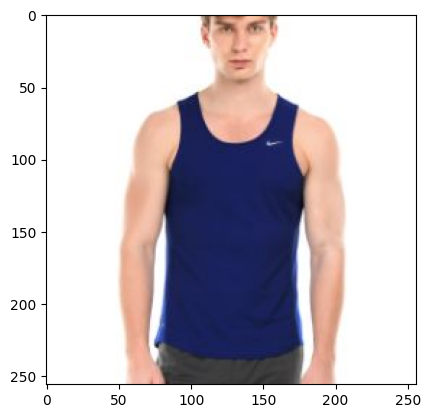

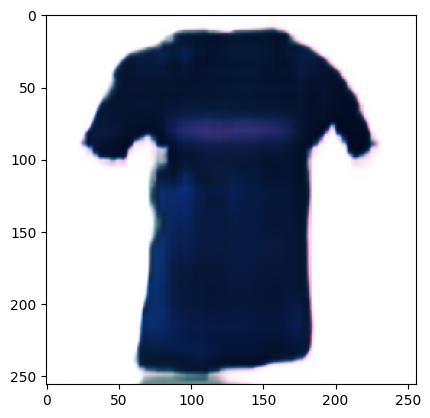

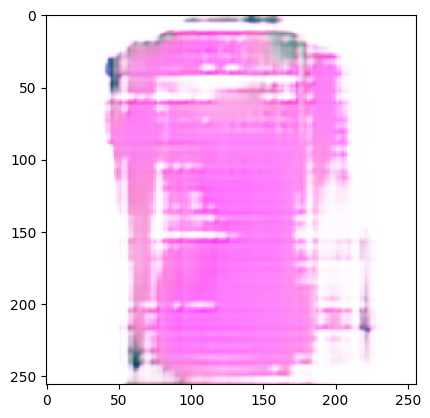

1/1 [==============================] - 0s 19ms/step
D Real: 0.07628980278968811, D Fake: 0.08472048491239548, G All: 3.202836751937866
1/1 [==============================] - 0s 19ms/step
D Real: 0.05471315234899521, D Fake: 0.10772083699703217, G All: 3.8838627338409424
1/1 [==============================] - 0s 19ms/step
D Real: 0.23858577013015747, D Fake: 0.1170695573091507, G All: 3.4588677883148193
1/1 [==============================] - 0s 18ms/step
D Real: 0.43275225162506104, D Fake: 0.08581909537315369, G All: 3.4316420555114746
1/1 [==============================] - 0s 19ms/step
D Real: 0.07470766454935074, D Fake: 0.1015571802854538, G All: 3.6824469566345215
1/1 [==============================] - 0s 21ms/step
D Real: 0.09921607375144958, D Fake: 0.097992904484272, G All: 3.6194674968719482
1/1 [==============================] - 0s 19ms/step
D Real: 0.03161083161830902, D Fake: 0.06127140671014786, G All: 3.216001033782959
1/1 [==============================] - 0s 19ms/step
D 

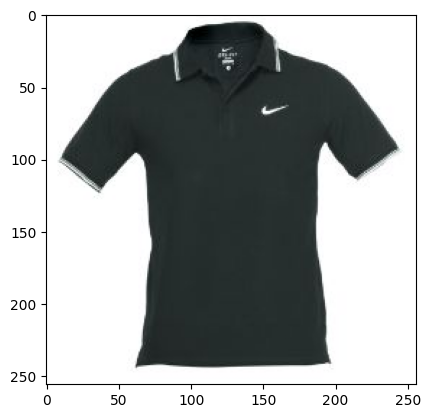

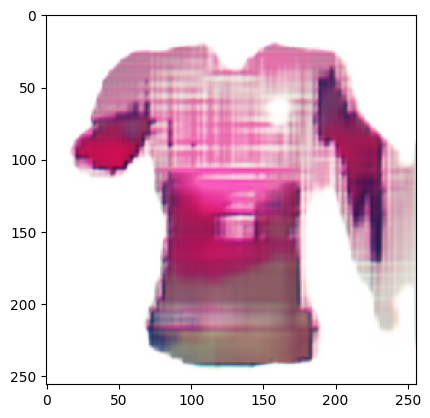

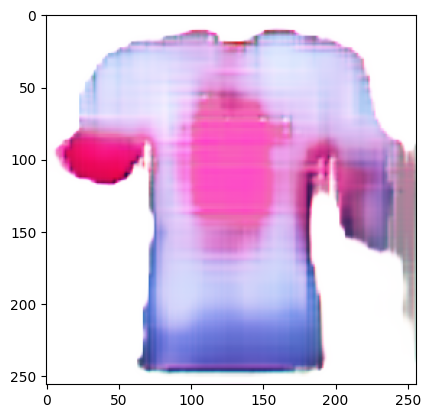

1/1 [==============================] - 0s 19ms/step
D Real: 0.2428947240114212, D Fake: 0.052158161997795105, G All: 4.749735355377197
1/1 [==============================] - 0s 18ms/step
D Real: 0.039686284959316254, D Fake: 0.041542306542396545, G All: 4.433547019958496
1/1 [==============================] - 0s 17ms/step
D Real: 0.03864685818552971, D Fake: 0.2625913918018341, G All: 3.3762269020080566
1/1 [==============================] - 0s 17ms/step
D Real: 0.028019484132528305, D Fake: 0.07949604094028473, G All: 3.3918113708496094
1/1 [==============================] - 0s 18ms/step
D Real: 0.6902354955673218, D Fake: 0.5993520617485046, G All: 3.5929312705993652
1/1 [==============================] - 0s 17ms/step
D Real: 0.30330798029899597, D Fake: 0.43146753311157227, G All: 3.5112199783325195
1/1 [==============================] - 0s 18ms/step
D Real: 0.1495293378829956, D Fake: 0.044161923229694366, G All: 3.6570992469787598
1/1 [==============================] - 0s 18ms/ste

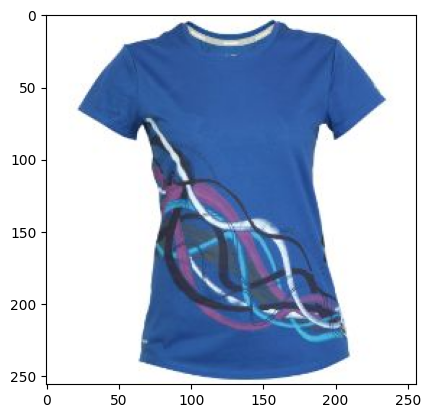

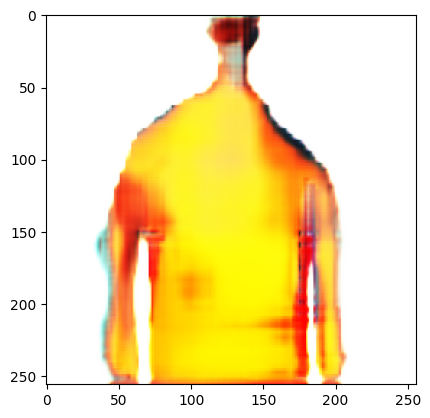

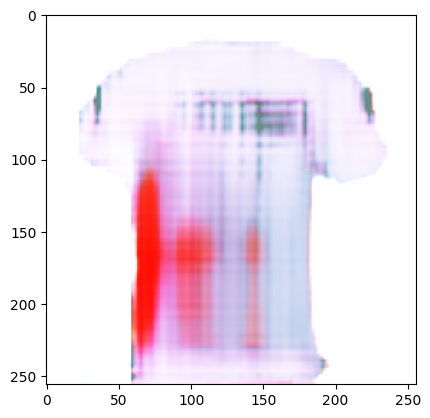

1/1 [==============================] - 0s 18ms/step
D Real: 0.053185202181339264, D Fake: 0.09109893441200256, G All: 3.028550624847412
1/1 [==============================] - 0s 19ms/step
D Real: 0.10705828666687012, D Fake: 0.041907403618097305, G All: 3.8460006713867188
1/1 [==============================] - 0s 26ms/step
D Real: 0.42988917231559753, D Fake: 0.07723243534564972, G All: 3.3914589881896973
1/1 [==============================] - 0s 19ms/step
D Real: 0.739922821521759, D Fake: 0.0748823955655098, G All: 2.2744922637939453
1/1 [==============================] - 0s 17ms/step
D Real: 0.04183295741677284, D Fake: 0.44593295454978943, G All: 1.277485728263855
1/1 [==============================] - 0s 18ms/step
D Real: 0.08269135653972626, D Fake: 0.13670870661735535, G All: 1.5718994140625
1/1 [==============================] - 0s 17ms/step
D Real: 0.5238991379737854, D Fake: 0.12793059647083282, G All: 2.1558938026428223
1/1 [==============================] - 0s 17ms/step
D R

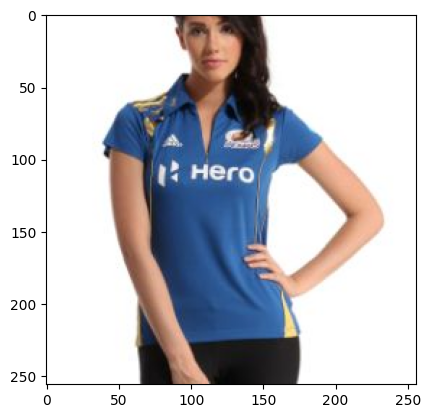

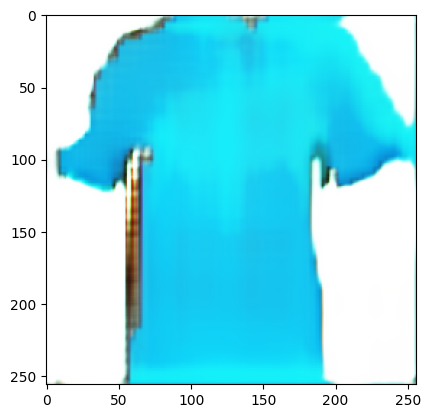

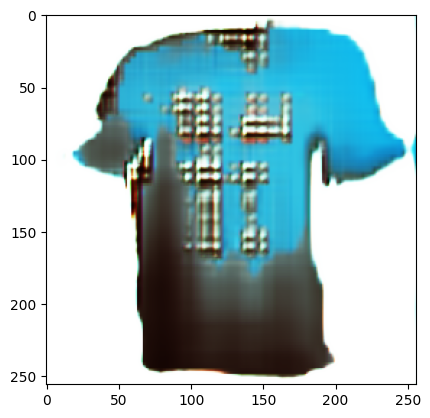

1/1 [==============================] - 0s 31ms/step
D Real: 0.06407705694437027, D Fake: 0.032651327550411224, G All: 4.023665428161621
1/1 [==============================] - 0s 22ms/step
D Real: 0.10503659397363663, D Fake: 0.06542396545410156, G All: 4.248862266540527
1/1 [==============================] - 0s 22ms/step
D Real: 0.42986780405044556, D Fake: 0.09176070988178253, G All: 3.5583009719848633
1/1 [==============================] - 0s 22ms/step
D Real: 0.041897229850292206, D Fake: 0.07552546262741089, G All: 3.136305809020996
1/1 [==============================] - 0s 21ms/step
D Real: 0.03561294078826904, D Fake: 0.33724579215049744, G All: 3.405881881713867
1/1 [==============================] - 0s 23ms/step
D Real: 0.061576392501592636, D Fake: 0.16489246487617493, G All: 2.473039150238037
1/1 [==============================] - 0s 21ms/step
D Real: 0.039613157510757446, D Fake: 0.10137669742107391, G All: 3.154773712158203
1/1 [==============================] - 0s 21ms/ste

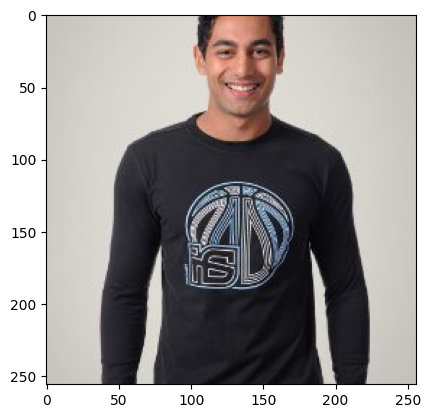

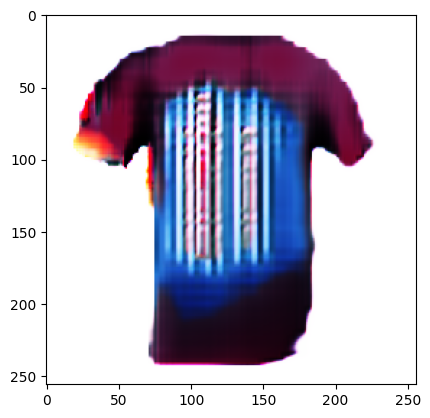

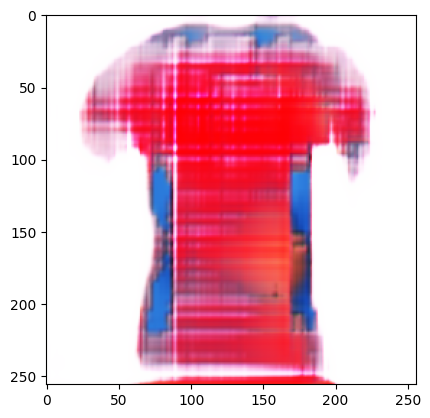

1/1 [==============================] - 0s 18ms/step
D Real: 0.03766566514968872, D Fake: 0.7474833130836487, G All: 2.1554346084594727
1/1 [==============================] - 0s 18ms/step
D Real: 0.13605114817619324, D Fake: 0.2512083351612091, G All: 2.291956901550293
1/1 [==============================] - 0s 20ms/step
D Real: 0.08596285432577133, D Fake: 0.1579872965812683, G All: 2.803900957107544
1/1 [==============================] - 0s 18ms/step
D Real: 0.044163379818201065, D Fake: 0.17574678361415863, G All: 3.20755672454834
1/1 [==============================] - 0s 18ms/step
D Real: 0.03399381786584854, D Fake: 0.05774485319852829, G All: 3.9973137378692627
1/1 [==============================] - 0s 19ms/step
D Real: 0.04854699224233627, D Fake: 0.12198534607887268, G All: 3.864415407180786
1/1 [==============================] - 0s 19ms/step
D Real: 0.6601117253303528, D Fake: 0.07287105172872543, G All: 4.308764457702637
1/1 [==============================] - 0s 20ms/step
D Rea

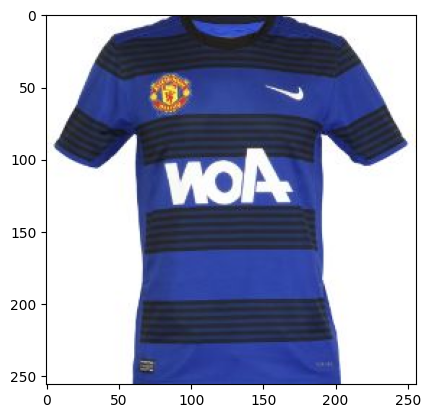

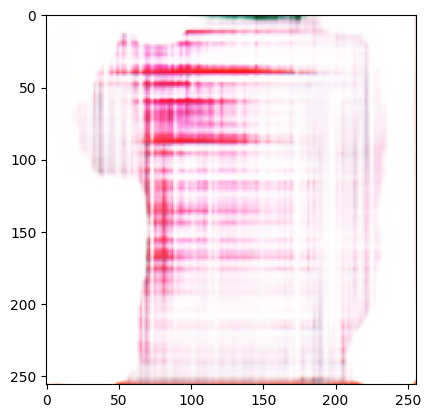

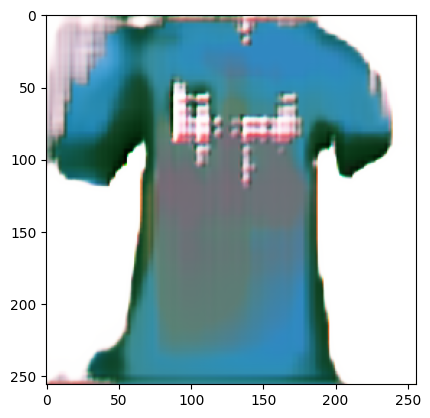

1/1 [==============================] - 0s 18ms/step
D Real: 2.040252208709717, D Fake: 0.03982378542423248, G All: 2.142498016357422
1/1 [==============================] - 0s 18ms/step
D Real: 0.15105485916137695, D Fake: 0.5947588682174683, G All: 1.2116303443908691
1/1 [==============================] - 0s 18ms/step
D Real: 0.04273940250277519, D Fake: 2.157052516937256, G All: 1.5837252140045166
1/1 [==============================] - 0s 22ms/step
D Real: 0.050661779940128326, D Fake: 0.49303707480430603, G All: 1.8369742631912231
1/1 [==============================] - 0s 18ms/step
D Real: 0.04587583243846893, D Fake: 0.09083542972803116, G All: 3.0052363872528076
1/1 [==============================] - 0s 17ms/step
D Real: 0.5245504379272461, D Fake: 0.7113174200057983, G All: 3.960817337036133
1/1 [==============================] - 0s 29ms/step
D Real: 0.04444234445691109, D Fake: 0.03386393561959267, G All: 5.282531261444092
1/1 [==============================] - 0s 18ms/step
D Rea

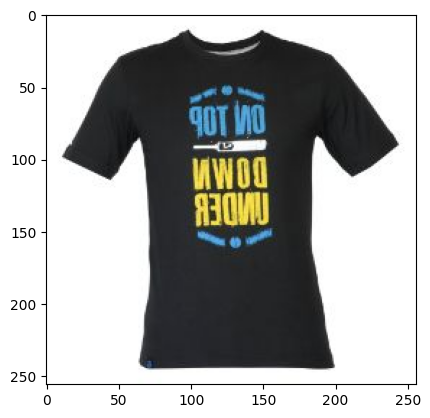

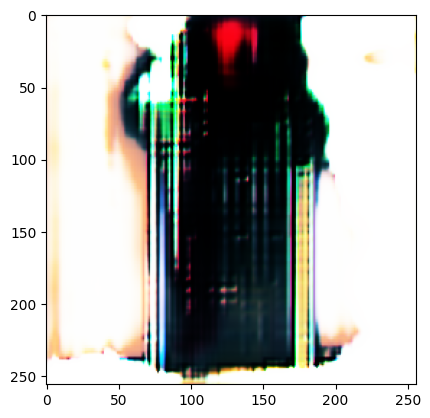

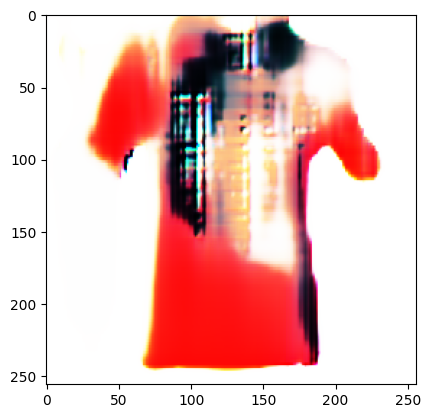

1/1 [==============================] - 0s 21ms/step
D Real: 0.03538640961050987, D Fake: 0.03889177367091179, G All: 5.535477161407471
1/1 [==============================] - 0s 20ms/step
D Real: 0.2042476236820221, D Fake: 0.021534843370318413, G All: 4.436688423156738
1/1 [==============================] - 0s 19ms/step
D Real: 0.10103364288806915, D Fake: 0.043342962861061096, G All: 4.815332889556885
1/1 [==============================] - 0s 24ms/step
D Real: 0.03977451100945473, D Fake: 0.04695539176464081, G All: 4.162503242492676
1/1 [==============================] - 0s 23ms/step
D Real: 0.03834862262010574, D Fake: 0.05763460695743561, G All: 3.978125810623169
1/1 [==============================] - 0s 21ms/step
D Real: 2.122121810913086, D Fake: 0.026508258655667305, G All: 3.215449333190918
1/1 [==============================] - 0s 21ms/step
D Real: 0.045882899314165115, D Fake: 0.08413487672805786, G All: 3.013366222381592
1/1 [==============================] - 0s 21ms/step
D 

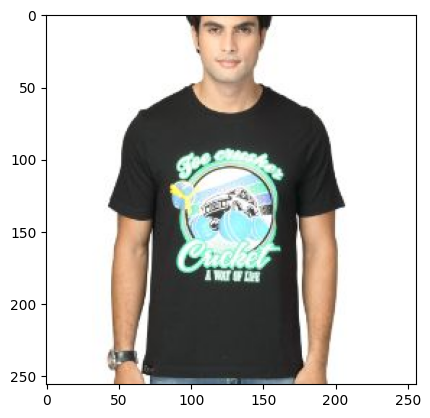

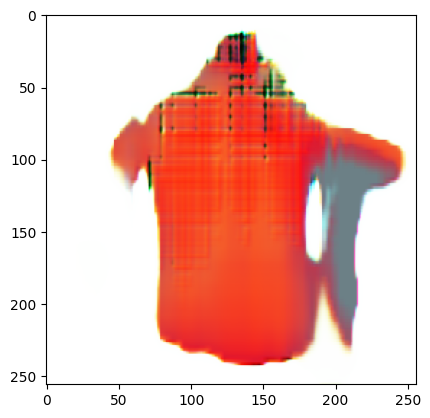

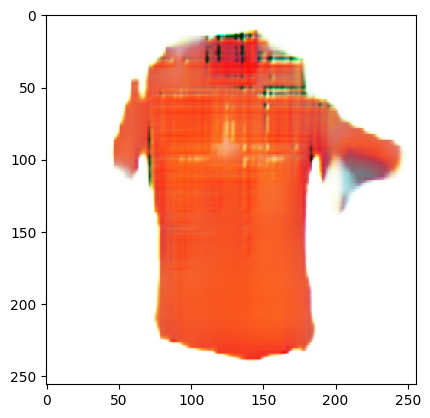

1/1 [==============================] - 0s 19ms/step
D Real: 0.053782183676958084, D Fake: 0.09611067175865173, G All: 2.5995736122131348
1/1 [==============================] - 0s 18ms/step
D Real: 0.4388245642185211, D Fake: 0.09087155014276505, G All: 2.517286777496338
1/1 [==============================] - 0s 18ms/step
D Real: 0.24131298065185547, D Fake: 0.07250212132930756, G All: 2.22877836227417
1/1 [==============================] - 0s 19ms/step
D Real: 0.035565365105867386, D Fake: 0.2702636420726776, G All: 1.6768512725830078
1/1 [==============================] - 0s 18ms/step
D Real: 0.08239836990833282, D Fake: 0.3361828327178955, G All: 2.8211305141448975
1/1 [==============================] - 0s 18ms/step
D Real: 0.8442920446395874, D Fake: 1.5539040565490723, G All: 2.1067423820495605
1/1 [==============================] - 0s 20ms/step
D Real: 0.06236400455236435, D Fake: 0.4009072780609131, G All: 2.3547589778900146
1/1 [==============================] - 0s 19ms/step
D R

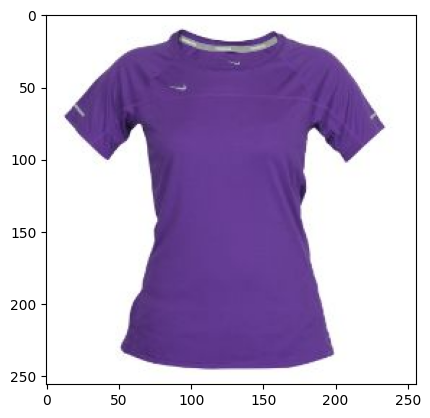

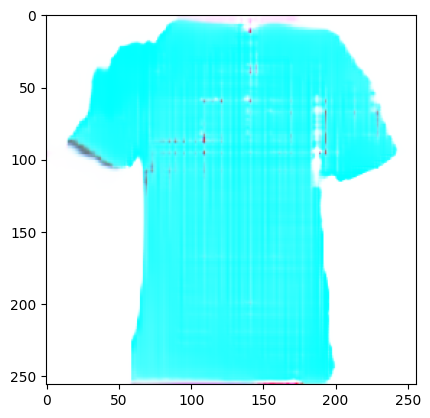

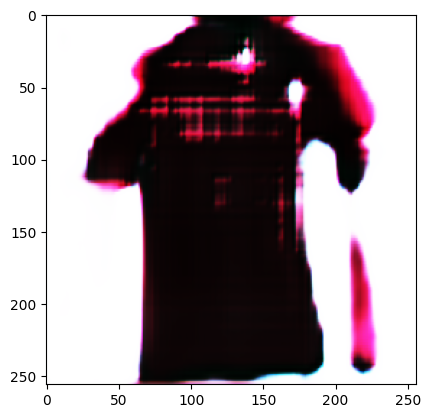

1/1 [==============================] - 0s 28ms/step
D Real: 0.05356061831116676, D Fake: 0.04990602284669876, G All: 4.228923797607422
1/1 [==============================] - 0s 22ms/step
D Real: 0.15504151582717896, D Fake: 0.042317621409893036, G All: 3.9566762447357178
1/1 [==============================] - 0s 22ms/step
D Real: 0.7073428630828857, D Fake: 0.050562672317028046, G All: 3.9446370601654053
1/1 [==============================] - 0s 23ms/step
D Real: 0.06636686623096466, D Fake: 0.07854034006595612, G All: 4.127852439880371
1/1 [==============================] - 0s 23ms/step
D Real: 0.0399162694811821, D Fake: 0.11662790924310684, G All: 4.217656135559082
1/1 [==============================] - 0s 23ms/step
D Real: 0.048040810972452164, D Fake: 0.038259655237197876, G All: 3.9441890716552734
1/1 [==============================] - 0s 21ms/step
D Real: 0.0520566888153553, D Fake: 0.035458989441394806, G All: 4.19232702255249
1/1 [==============================] - 0s 25ms/step

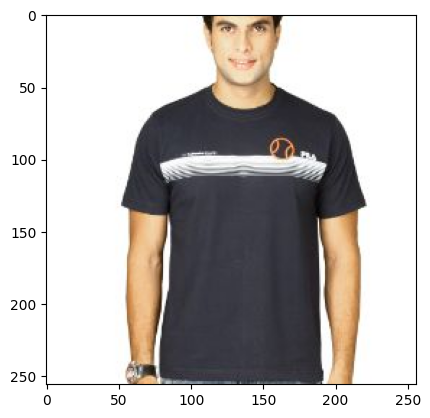

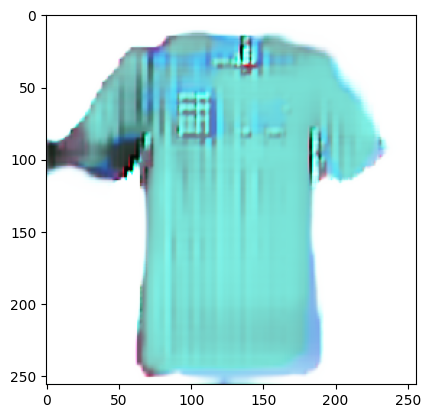

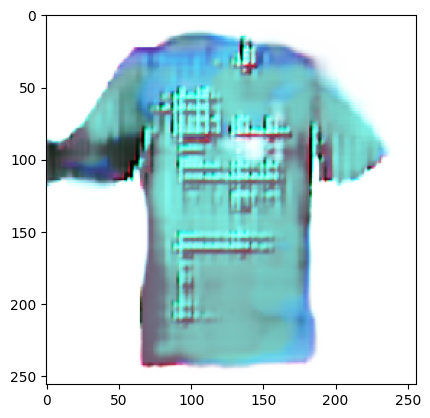

1/1 [==============================] - 0s 18ms/step
D Real: 0.07770799100399017, D Fake: 0.09665457159280777, G All: 3.051136016845703
1/1 [==============================] - 0s 19ms/step
D Real: 0.03225521743297577, D Fake: 0.08493855595588684, G All: 2.865488052368164
1/1 [==============================] - 0s 18ms/step
D Real: 0.07224210351705551, D Fake: 0.06411413848400116, G All: 2.756527900695801
1/1 [==============================] - 0s 18ms/step
D Real: 0.04114270210266113, D Fake: 0.12208035588264465, G All: 3.8832249641418457
1/1 [==============================] - 0s 18ms/step
D Real: 0.03884348273277283, D Fake: 0.05509857088327408, G All: 4.269501209259033
1/1 [==============================] - 0s 18ms/step
D Real: 0.04796633869409561, D Fake: 0.03639397397637367, G All: 4.091973781585693
1/1 [==============================] - 0s 17ms/step
D Real: 0.02556115761399269, D Fake: 0.0412035807967186, G All: 4.944500923156738
1/1 [==============================] - 0s 21ms/step
D R

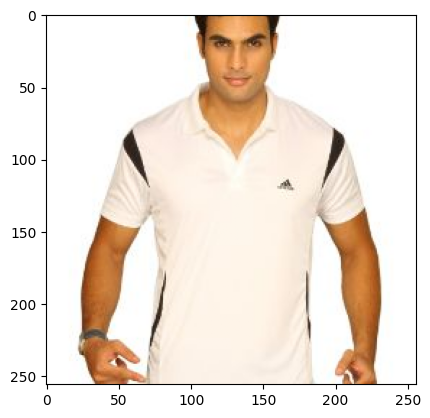

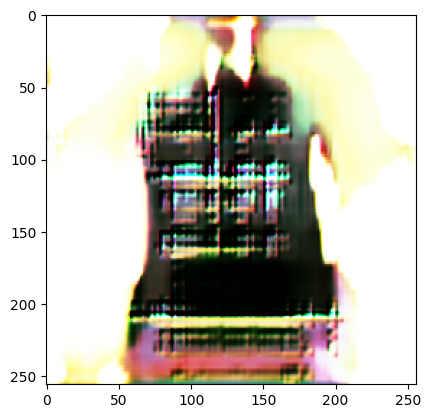

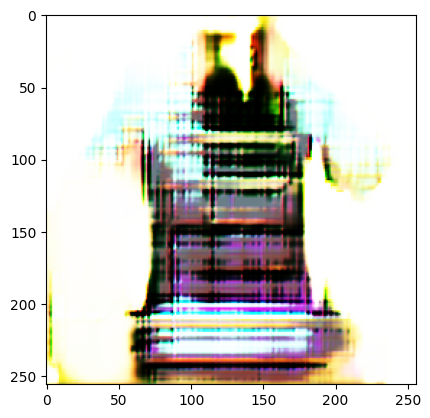

1/1 [==============================] - 0s 18ms/step
D Real: 0.19999369978904724, D Fake: 0.09593214094638824, G All: 3.864729404449463
1/1 [==============================] - 0s 17ms/step
D Real: 0.042397595942020416, D Fake: 0.07954461872577667, G All: 2.739316463470459
1/1 [==============================] - 0s 17ms/step
D Real: 0.18791548907756805, D Fake: 0.11770450323820114, G All: 3.1719696521759033
1/1 [==============================] - 0s 17ms/step
D Real: 0.038080815225839615, D Fake: 0.06761939823627472, G All: 3.339432716369629
1/1 [==============================] - 0s 17ms/step
D Real: 0.102608323097229, D Fake: 0.14987298846244812, G All: 3.423328161239624
1/1 [==============================] - 0s 18ms/step
D Real: 0.3889687955379486, D Fake: 0.12501244246959686, G All: 3.3206377029418945
1/1 [==============================] - 0s 17ms/step
D Real: 0.22929273545742035, D Fake: 0.05606100708246231, G All: 2.316218852996826
1/1 [==============================] - 0s 18ms/step
D 

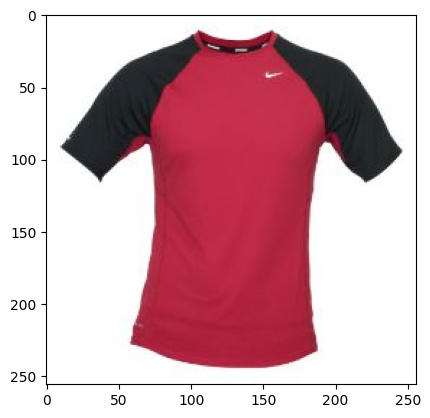

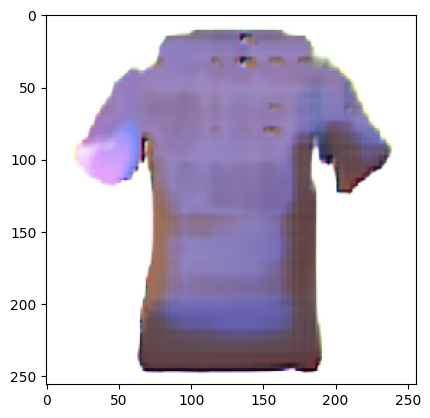

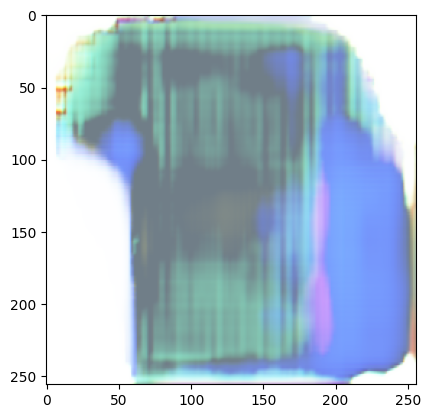

1/1 [==============================] - 0s 19ms/step
D Real: 0.047742947936058044, D Fake: 0.3220288157463074, G All: 1.8228118419647217
1/1 [==============================] - 0s 19ms/step
D Real: 0.24601061642169952, D Fake: 0.7002493739128113, G All: 2.1597814559936523
1/1 [==============================] - 0s 19ms/step
D Real: 0.030005790293216705, D Fake: 0.07364800572395325, G All: 1.5364196300506592
1/1 [==============================] - 0s 19ms/step
D Real: 0.0432041734457016, D Fake: 0.05920916795730591, G All: 3.718952178955078
1/1 [==============================] - 0s 19ms/step
D Real: 0.04273048788309097, D Fake: 0.10357825458049774, G All: 3.532897472381592
1/1 [==============================] - 0s 20ms/step
D Real: 2.3735086917877197, D Fake: 0.07337218523025513, G All: 3.5147924423217773
1/1 [==============================] - 0s 19ms/step
D Real: 0.04035577550530434, D Fake: 0.1473105251789093, G All: 1.9289231300354004
1/1 [==============================] - 0s 24ms/step
D

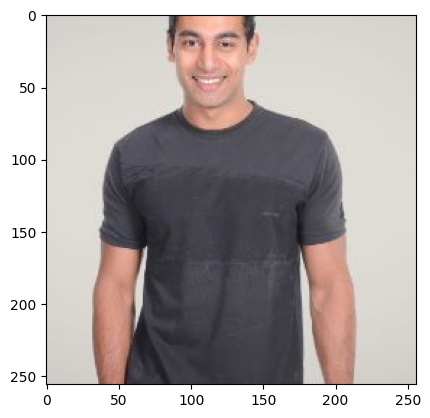

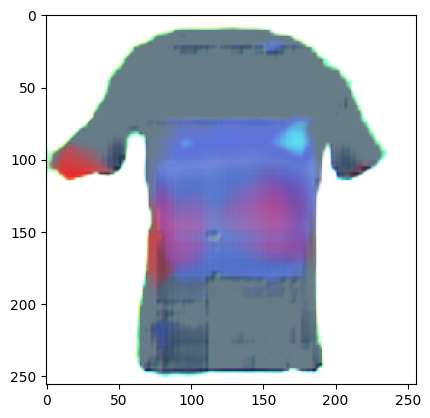

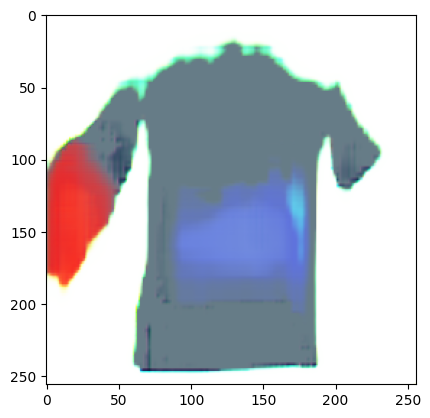

1/1 [==============================] - 0s 18ms/step
D Real: 0.12321346998214722, D Fake: 0.5771610736846924, G All: 2.2095389366149902
1/1 [==============================] - 0s 19ms/step
D Real: 0.02542942762374878, D Fake: 0.3798264265060425, G All: 2.188894748687744
1/1 [==============================] - 0s 18ms/step
D Real: 0.05847494676709175, D Fake: 0.07192781567573547, G All: 3.83776593208313
1/1 [==============================] - 0s 18ms/step
D Real: 0.30253028869628906, D Fake: 0.050380803644657135, G All: 4.3425445556640625
1/1 [==============================] - 0s 17ms/step
D Real: 0.885309100151062, D Fake: 0.05006081238389015, G All: 3.4256670475006104
1/1 [==============================] - 0s 18ms/step
D Real: 0.070952869951725, D Fake: 0.1205173134803772, G All: 4.419737815856934
1/1 [==============================] - 0s 18ms/step
D Real: 0.10275804251432419, D Fake: 0.12502604722976685, G All: 3.914088726043701
1/1 [==============================] - 0s 20ms/step
D Real:

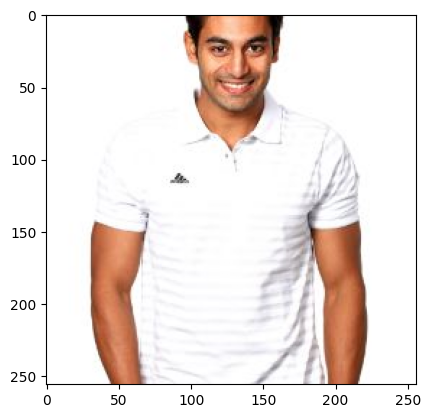

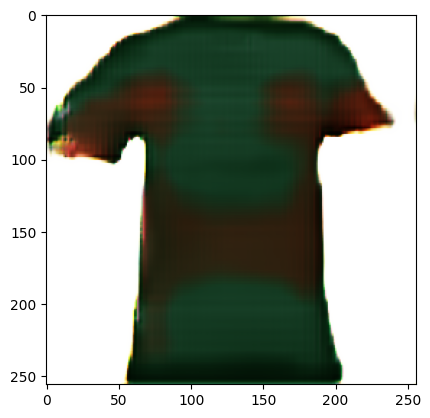

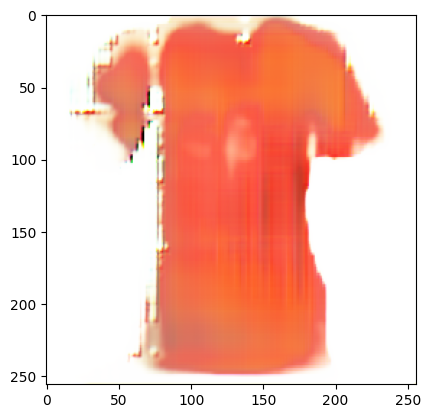

1/1 [==============================] - 0s 25ms/step
D Real: 0.05634637922048569, D Fake: 0.0403464213013649, G All: 3.5719006061553955
1/1 [==============================] - 0s 19ms/step
D Real: 2.0263795852661133, D Fake: 0.16718831658363342, G All: 3.116727828979492
1/1 [==============================] - 0s 18ms/step
D Real: 1.1450626850128174, D Fake: 0.05262524634599686, G All: 2.107534885406494
1/1 [==============================] - 0s 20ms/step
D Real: 0.05610018968582153, D Fake: 0.30208104848861694, G All: 1.5066184997558594
1/1 [==============================] - 0s 17ms/step
D Real: 0.051161207258701324, D Fake: 0.3154040575027466, G All: 1.440650463104248
1/1 [==============================] - 0s 17ms/step
D Real: 0.04500590264797211, D Fake: 0.2276626080274582, G All: 1.652901291847229
1/1 [==============================] - 0s 17ms/step
D Real: 0.07344509661197662, D Fake: 0.7579866647720337, G All: 2.0464963912963867
1/1 [==============================] - 0s 17ms/step
D Rea

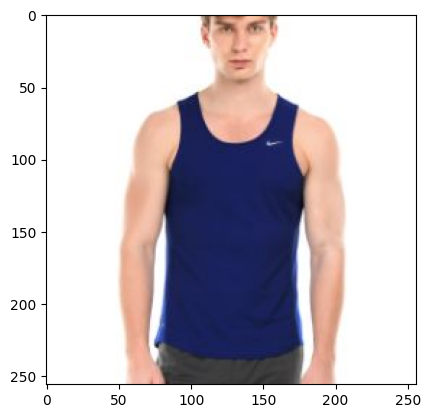

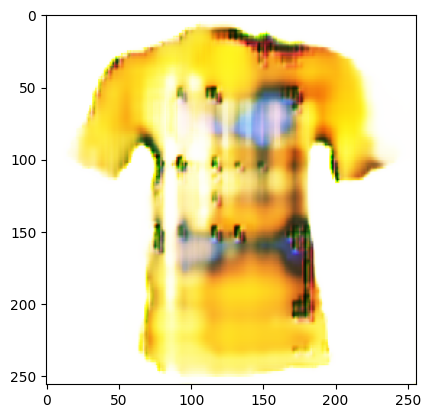

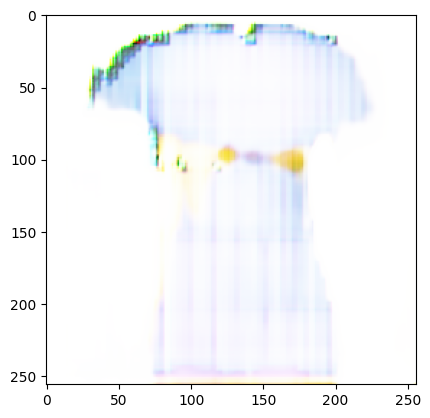

1/1 [==============================] - 0s 28ms/step
D Real: 0.058089300990104675, D Fake: 0.06636129319667816, G All: 5.132785797119141
1/1 [==============================] - 0s 17ms/step
D Real: 0.02377323806285858, D Fake: 0.028323113918304443, G All: 4.953616619110107
1/1 [==============================] - 0s 18ms/step
D Real: 0.45486724376678467, D Fake: 0.08040906488895416, G All: 5.041934967041016
1/1 [==============================] - 0s 18ms/step
D Real: 0.03232947736978531, D Fake: 0.060718175023794174, G All: 5.016509532928467
1/1 [==============================] - 0s 18ms/step
D Real: 0.0920858234167099, D Fake: 0.1848289966583252, G All: 4.060234069824219
1/1 [==============================] - 0s 18ms/step
D Real: 1.1382479667663574, D Fake: 0.033827703446149826, G All: 3.898796796798706
1/1 [==============================] - 0s 18ms/step
D Real: 0.17860177159309387, D Fake: 0.10116640478372574, G All: 2.7144389152526855
1/1 [==============================] - 0s 16ms/step
D

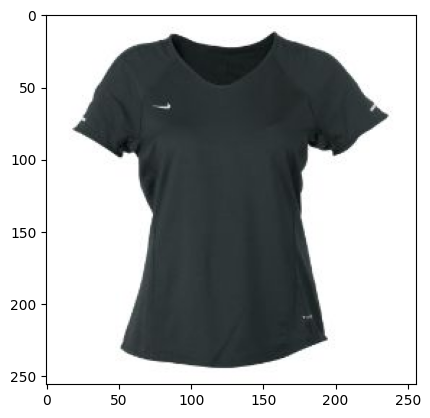

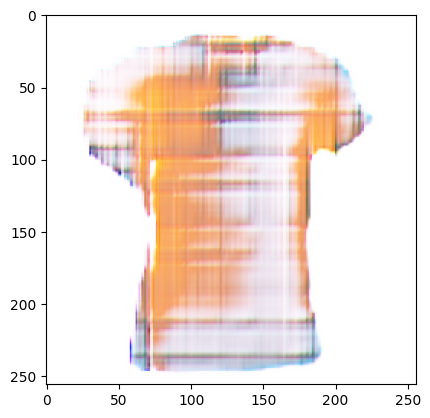

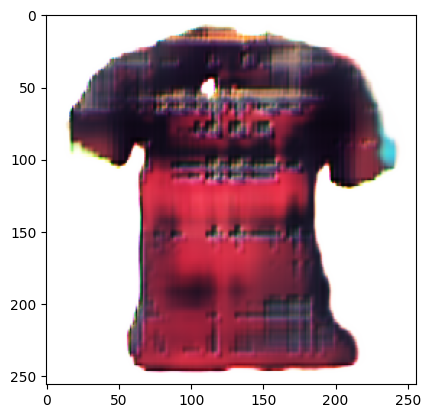

1/1 [==============================] - 0s 18ms/step
D Real: 0.06794771552085876, D Fake: 0.11646109819412231, G All: 1.3832919597625732
1/1 [==============================] - 0s 25ms/step
D Real: 0.31289684772491455, D Fake: 0.23047301173210144, G All: 2.0866658687591553
1/1 [==============================] - 0s 19ms/step
D Real: 2.1349751949310303, D Fake: 0.27562856674194336, G All: 0.9257515668869019
1/1 [==============================] - 0s 18ms/step
D Real: 0.08827640116214752, D Fake: 2.8247103691101074, G All: 0.9040194153785706
1/1 [==============================] - 0s 23ms/step
D Real: 0.0736929327249527, D Fake: 1.8402583599090576, G All: 2.700565814971924
1/1 [==============================] - 0s 18ms/step
D Real: 0.041179757565259933, D Fake: 0.0701255351305008, G All: 5.947507858276367
1/1 [==============================] - 0s 19ms/step
D Real: 0.0661425068974495, D Fake: 0.03194555640220642, G All: 6.283809661865234
1/1 [==============================] - 0s 19ms/step
D Re

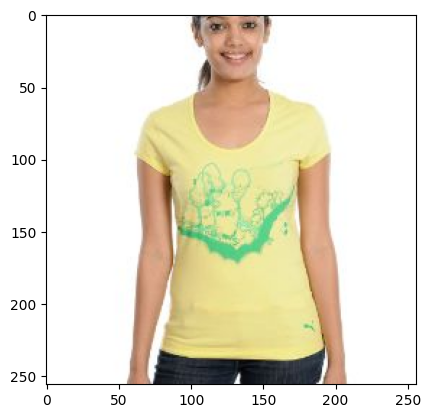

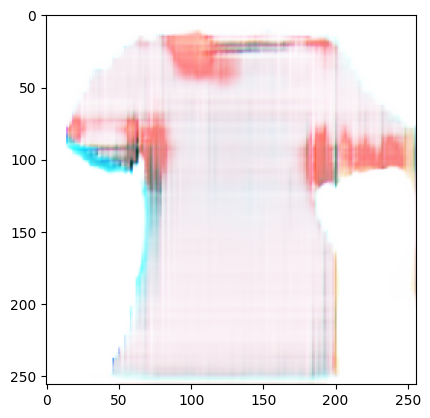

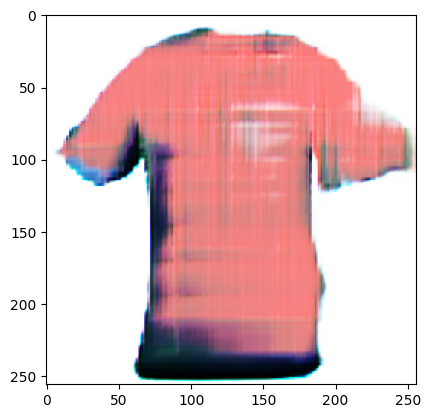

1/1 [==============================] - 0s 18ms/step
D Real: 0.05095798522233963, D Fake: 0.7067513465881348, G All: 2.941906690597534
1/1 [==============================] - 0s 17ms/step
D Real: 0.8851368427276611, D Fake: 0.08798197656869888, G All: 4.539925575256348
1/1 [==============================] - 0s 17ms/step
D Real: 0.1774056851863861, D Fake: 0.05481749773025513, G All: 2.925143003463745
1/1 [==============================] - 0s 17ms/step
D Real: 0.2698974609375, D Fake: 0.07551673799753189, G All: 3.575977325439453
1/1 [==============================] - 0s 37ms/step
D Real: 0.08141636103391647, D Fake: 0.08519287407398224, G All: 3.7546613216400146
1/1 [==============================] - 0s 17ms/step
D Real: 2.8456783294677734, D Fake: 0.08563605695962906, G All: 2.8844728469848633
1/1 [==============================] - 0s 18ms/step
D Real: 0.27031564712524414, D Fake: 0.17218616604804993, G All: 2.7826099395751953
1/1 [==============================] - 0s 18ms/step
D Real: 

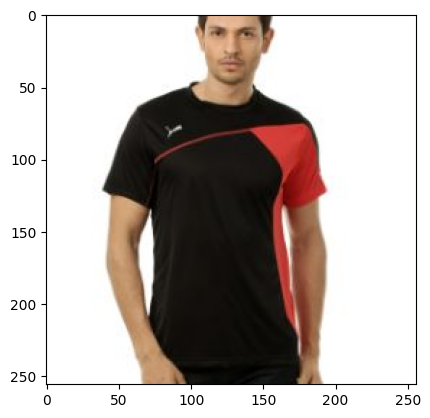

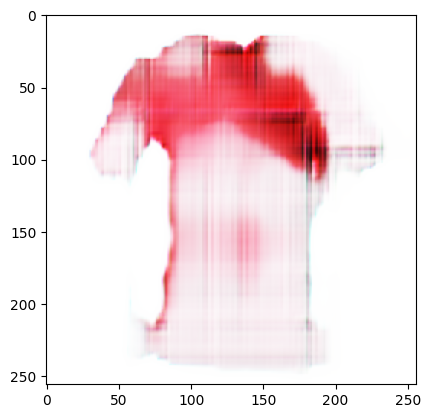

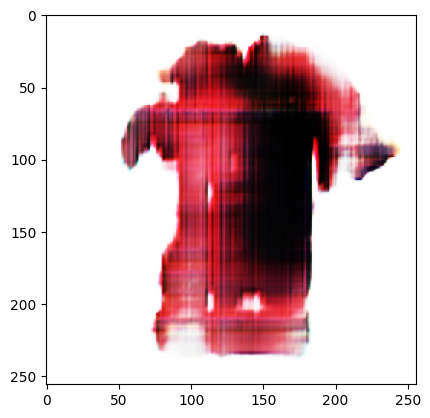

1/1 [==============================] - 0s 18ms/step
D Real: 0.2630111575126648, D Fake: 0.0550687201321125, G All: 5.682238578796387
1/1 [==============================] - 0s 18ms/step
D Real: 2.4464364051818848, D Fake: 0.03771278262138367, G All: 4.013377666473389
1/1 [==============================] - 0s 18ms/step
D Real: 0.1584567129611969, D Fake: 0.14041554927825928, G All: 3.8362951278686523
1/1 [==============================] - 0s 24ms/step
D Real: 0.07973664999008179, D Fake: 0.19842226803302765, G All: 3.1328234672546387
1/1 [==============================] - 0s 18ms/step
D Real: 0.05243579298257828, D Fake: 0.05882738158106804, G All: 2.44508695602417
1/1 [==============================] - 0s 19ms/step
D Real: 0.0652284249663353, D Fake: 0.10147307813167572, G All: 2.7909746170043945
1/1 [==============================] - 0s 19ms/step
D Real: 0.040001243352890015, D Fake: 0.9269812703132629, G All: 2.721116542816162
1/1 [==============================] - 0s 16ms/step
D Real

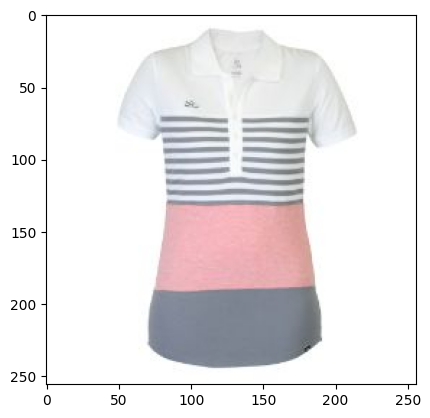

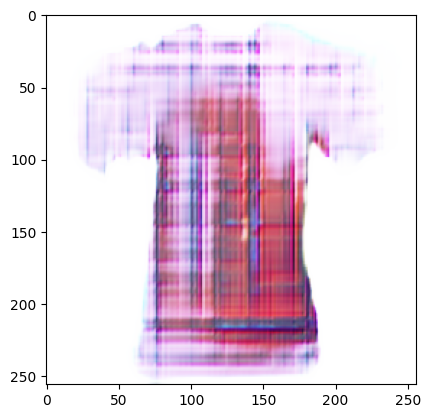

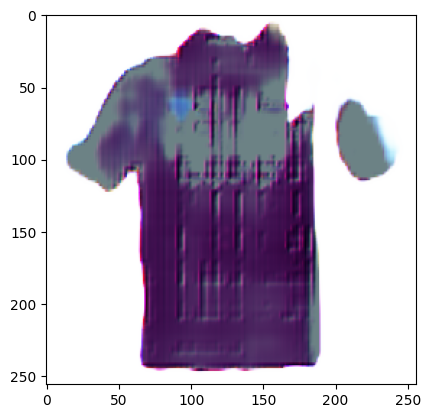

1/1 [==============================] - 0s 19ms/step
D Real: 0.030585063621401787, D Fake: 0.04566032811999321, G All: 4.580448627471924
1/1 [==============================] - 0s 17ms/step
D Real: 0.12251846492290497, D Fake: 0.059772126376628876, G All: 4.241001605987549
1/1 [==============================] - 0s 18ms/step
D Real: 0.48142197728157043, D Fake: 0.05198223888874054, G All: 3.363609552383423
1/1 [==============================] - 0s 18ms/step
D Real: 0.0312087032943964, D Fake: 0.04687389358878136, G All: 3.7767140865325928
1/1 [==============================] - 0s 17ms/step
D Real: 0.04562821239233017, D Fake: 0.18519338965415955, G All: 3.589784622192383
1/1 [==============================] - 0s 17ms/step
D Real: 0.04717095196247101, D Fake: 0.16403812170028687, G All: 4.086784362792969
1/1 [==============================] - 0s 19ms/step
D Real: 0.04109267145395279, D Fake: 0.08564303815364838, G All: 4.139107704162598
1/1 [==============================] - 0s 19ms/step
D

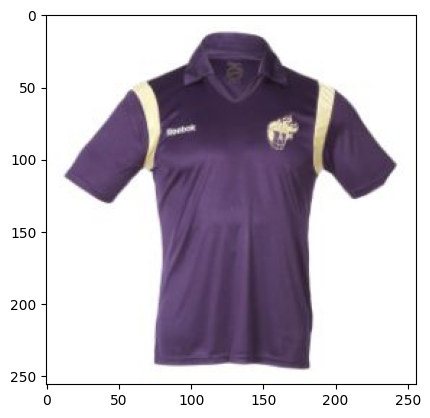

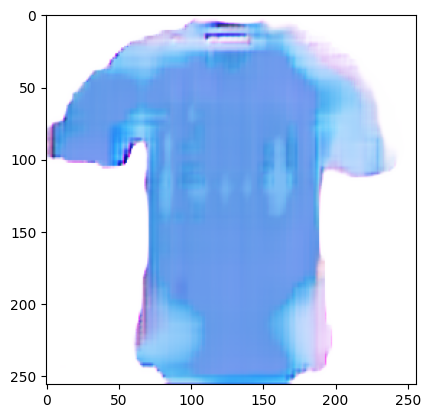

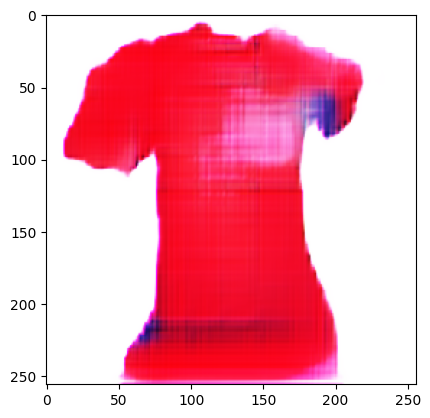

1/1 [==============================] - 0s 17ms/step
D Real: 0.07617318630218506, D Fake: 0.1740705668926239, G All: 2.0828166007995605
1/1 [==============================] - 0s 17ms/step
D Real: 0.049493275582790375, D Fake: 0.3578704595565796, G All: 2.0588440895080566
1/1 [==============================] - 0s 19ms/step
D Real: 0.4670206904411316, D Fake: 0.1121627613902092, G All: 2.750849723815918
1/1 [==============================] - 0s 18ms/step
D Real: 0.06203450262546539, D Fake: 0.21860246360301971, G All: 2.916835308074951
1/1 [==============================] - 0s 19ms/step
D Real: 0.3685532510280609, D Fake: 0.07264264672994614, G All: 3.0599536895751953
1/1 [==============================] - 0s 18ms/step
D Real: 0.1289564073085785, D Fake: 0.21749469637870789, G All: 3.1906468868255615
1/1 [==============================] - 0s 17ms/step
D Real: 0.09738551080226898, D Fake: 0.09551592916250229, G All: 2.8461527824401855
1/1 [==============================] - 0s 17ms/step
D R

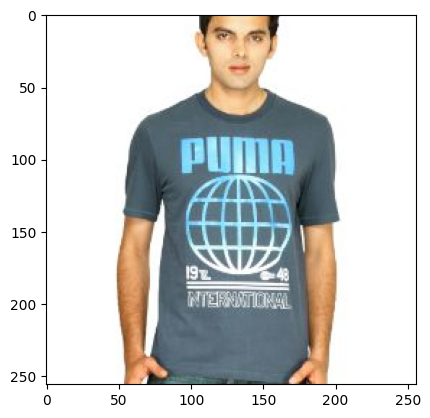

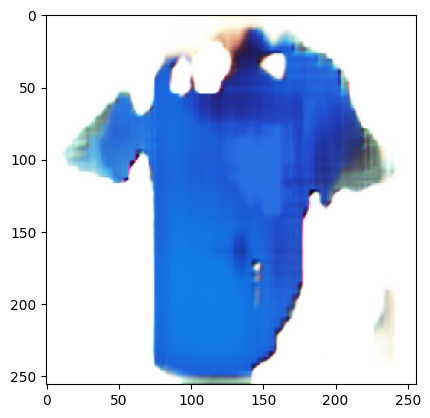

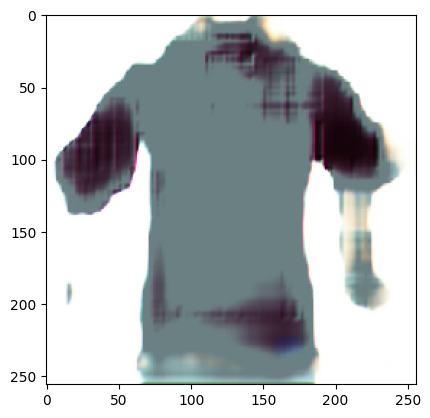

1/1 [==============================] - 0s 20ms/step
D Real: 0.07688948512077332, D Fake: 0.164711594581604, G All: 3.2546005249023438
1/1 [==============================] - 0s 19ms/step
D Real: 0.03602539747953415, D Fake: 0.29891833662986755, G All: 3.4737391471862793
1/1 [==============================] - 0s 20ms/step
D Real: 0.0388033390045166, D Fake: 0.05218998342752457, G All: 3.8136909008026123
1/1 [==============================] - 0s 30ms/step
D Real: 0.0632055327296257, D Fake: 0.04113682359457016, G All: 4.398712635040283
1/1 [==============================] - 0s 19ms/step
D Real: 0.040322136133909225, D Fake: 0.054681796580553055, G All: 4.915660858154297
1/1 [==============================] - 0s 19ms/step
D Real: 1.0501619577407837, D Fake: 0.038030143827199936, G All: 4.324875354766846
1/1 [==============================] - 0s 19ms/step
D Real: 0.03427337110042572, D Fake: 0.03652660548686981, G All: 3.850499153137207
1/1 [==============================] - 0s 21ms/step
D 

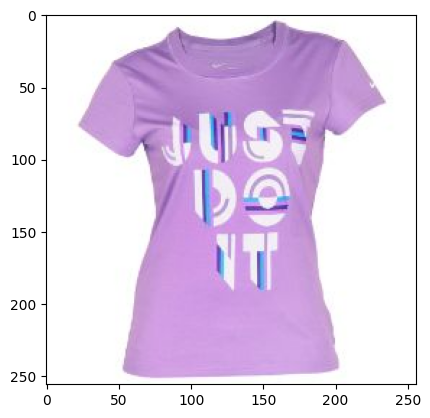

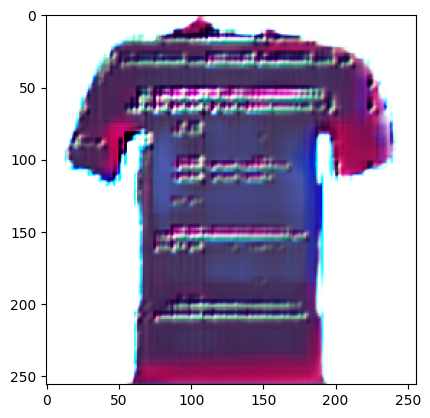

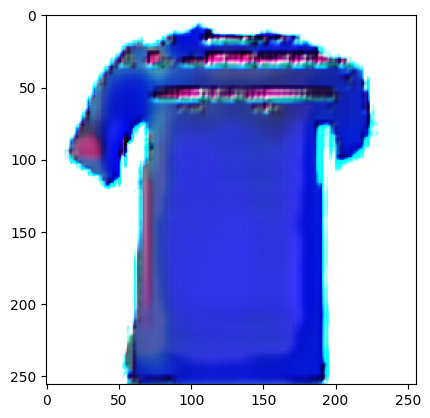

1/1 [==============================] - 0s 18ms/step
D Real: 0.0468878373503685, D Fake: 0.057471971958875656, G All: 6.052675247192383
1/1 [==============================] - 0s 19ms/step
D Real: 0.04985657334327698, D Fake: 0.05198078602552414, G All: 6.812457084655762
1/1 [==============================] - 0s 18ms/step
D Real: 0.05969046801328659, D Fake: 0.0499831885099411, G All: 6.182054042816162
1/1 [==============================] - 0s 18ms/step
D Real: 0.04325666278600693, D Fake: 0.023655664175748825, G All: 5.03652286529541
1/1 [==============================] - 0s 20ms/step
D Real: 0.04404037073254585, D Fake: 0.031115977093577385, G All: 5.39930534362793
1/1 [==============================] - 0s 19ms/step
D Real: 0.38174283504486084, D Fake: 0.212027907371521, G All: 4.142663478851318
1/1 [==============================] - 0s 18ms/step
D Real: 0.04928690567612648, D Fake: 0.058499183505773544, G All: 4.519506454467773
1/1 [==============================] - 0s 18ms/step
D Rea

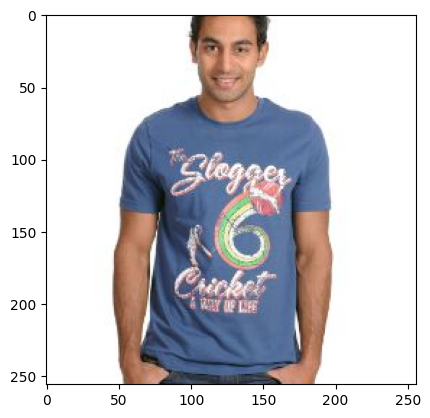

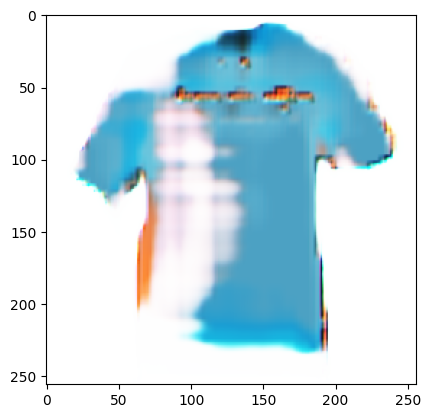

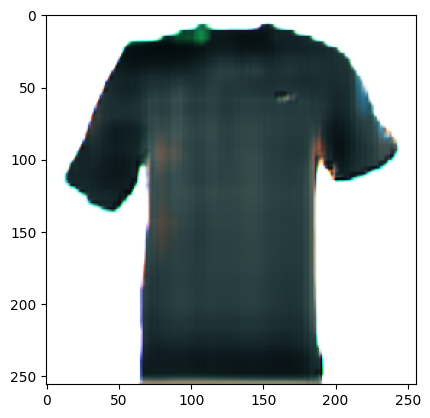

1/1 [==============================] - 0s 18ms/step
D Real: 0.28604769706726074, D Fake: 0.1633937656879425, G All: 3.3765106201171875
1/1 [==============================] - 0s 18ms/step
D Real: 0.04721105843782425, D Fake: 0.3432156443595886, G All: 3.2515439987182617
1/1 [==============================] - 0s 19ms/step
D Real: 0.03331853449344635, D Fake: 0.10092122107744217, G All: 4.296015739440918
1/1 [==============================] - 0s 21ms/step
D Real: 0.035789854824543, D Fake: 0.071690633893013, G All: 5.747744560241699
1/1 [==============================] - 0s 17ms/step
D Real: 0.04694328084588051, D Fake: 0.053339093923568726, G All: 5.589338302612305
1/1 [==============================] - 0s 19ms/step
D Real: 0.032397039234638214, D Fake: 0.031676068902015686, G All: 6.030880928039551
1/1 [==============================] - 0s 19ms/step
D Real: 0.28806763887405396, D Fake: 0.03356713056564331, G All: 6.321873188018799
1/1 [==============================] - 0s 17ms/step
D Re

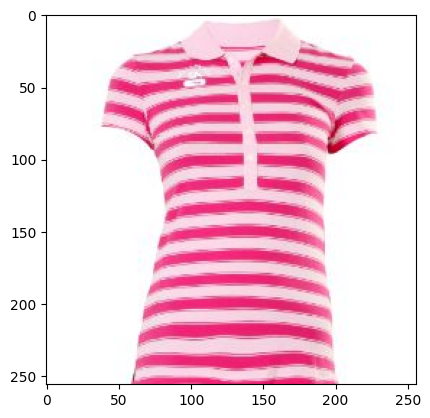

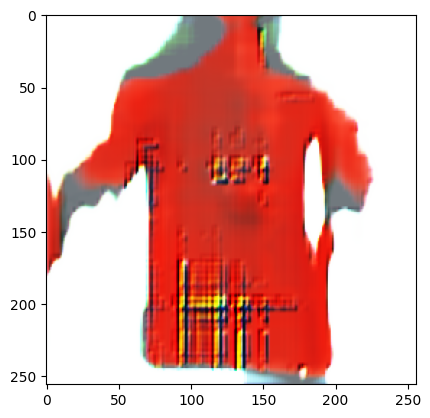

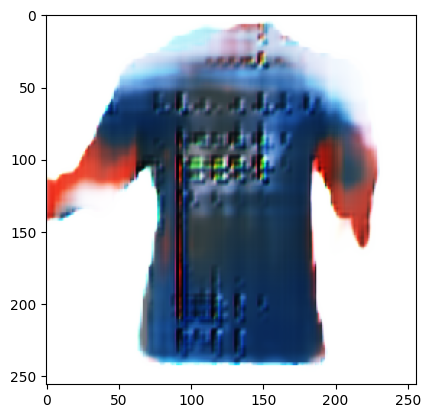

1/1 [==============================] - 0s 20ms/step
D Real: 0.04451249912381172, D Fake: 0.07876496762037277, G All: 3.1753196716308594
1/1 [==============================] - 0s 18ms/step
D Real: 0.1774853765964508, D Fake: 0.05988186597824097, G All: 2.6548776626586914
1/1 [==============================] - 0s 19ms/step
D Real: 0.06540603935718536, D Fake: 0.16541656851768494, G All: 3.2231850624084473
1/1 [==============================] - 0s 18ms/step
D Real: 0.9363921880722046, D Fake: 0.35956040024757385, G All: 2.682493209838867
1/1 [==============================] - 0s 18ms/step
D Real: 0.27132648229599, D Fake: 0.0935475081205368, G All: 2.778411865234375
1/1 [==============================] - 0s 18ms/step
D Real: 0.05579788237810135, D Fake: 0.06608164310455322, G All: 3.104025363922119
1/1 [==============================] - 0s 18ms/step
D Real: 0.06700015813112259, D Fake: 0.10257475078105927, G All: 2.22969913482666
1/1 [==============================] - 0s 18ms/step
D Real:

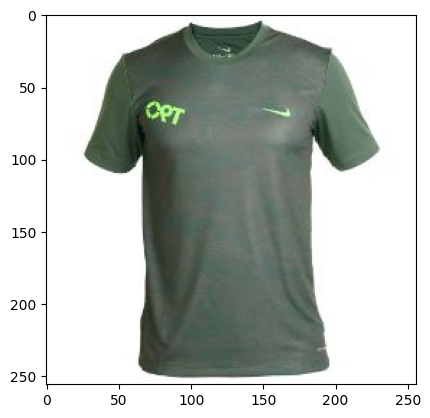

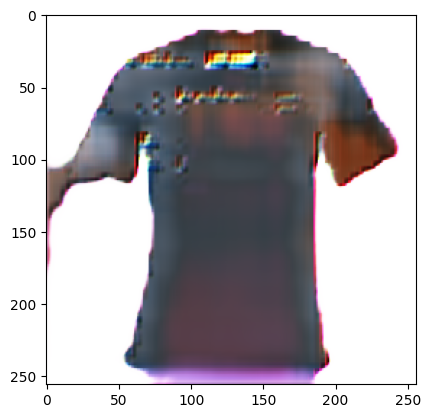

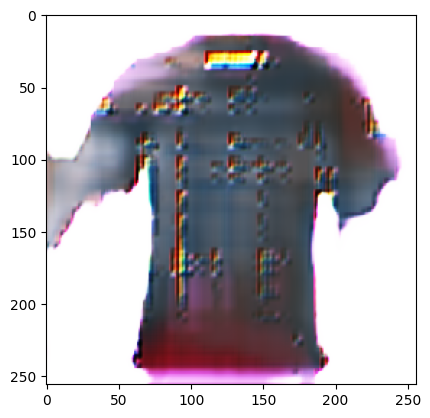

1/1 [==============================] - 0s 20ms/step
D Real: 1.2284834384918213, D Fake: 0.06619683653116226, G All: 2.690819025039673
1/1 [==============================] - 0s 19ms/step
D Real: 1.0692899227142334, D Fake: 0.10982854664325714, G All: 3.030900001525879
1/1 [==============================] - 0s 20ms/step
D Real: 1.3903615474700928, D Fake: 0.21960188448429108, G All: 2.5870821475982666
1/1 [==============================] - 0s 20ms/step
D Real: 0.0760628879070282, D Fake: 0.0900113582611084, G All: 2.857957124710083
1/1 [==============================] - 0s 19ms/step
D Real: 0.07214601337909698, D Fake: 0.09352487325668335, G All: 2.7296295166015625
1/1 [==============================] - 0s 21ms/step
D Real: 0.08196462690830231, D Fake: 0.09557878226041794, G All: 2.297635078430176
1/1 [==============================] - 0s 18ms/step
D Real: 0.07712934911251068, D Fake: 0.13464680314064026, G All: 1.9372780323028564
1/1 [==============================] - 0s 20ms/step
D Rea

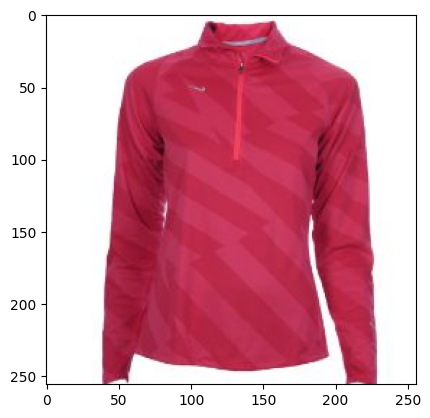

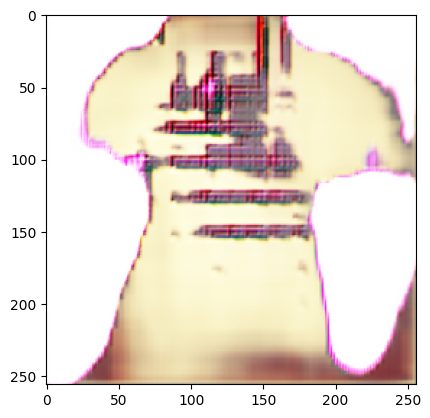

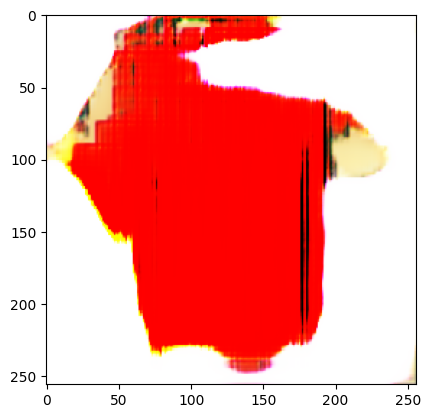

1/1 [==============================] - 0s 18ms/step
D Real: 0.058858953416347504, D Fake: 0.03159678354859352, G All: 5.413268089294434
1/1 [==============================] - 0s 17ms/step
D Real: 0.11463331431150436, D Fake: 0.04105668514966965, G All: 5.289894104003906
1/1 [==============================] - 0s 18ms/step
D Real: 0.10901401937007904, D Fake: 0.049191322177648544, G All: 5.7436699867248535
1/1 [==============================] - 0s 18ms/step
D Real: 0.03569686412811279, D Fake: 0.03560005873441696, G All: 6.166966438293457
1/1 [==============================] - 0s 17ms/step
D Real: 0.07994275540113449, D Fake: 0.08219732344150543, G All: 6.0656843185424805
1/1 [==============================] - 0s 18ms/step
D Real: 0.05365060269832611, D Fake: 0.05250468850135803, G All: 5.6673383712768555
1/1 [==============================] - 0s 18ms/step
D Real: 0.15756165981292725, D Fake: 0.043071210384368896, G All: 5.395768165588379
1/1 [==============================] - 0s 18ms/st

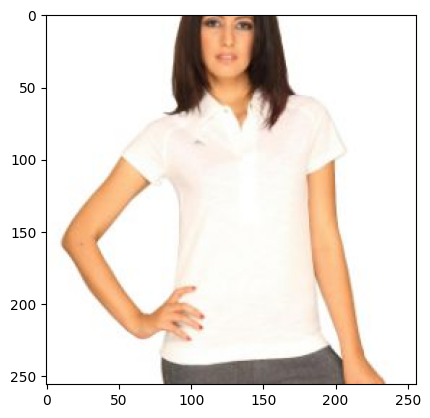

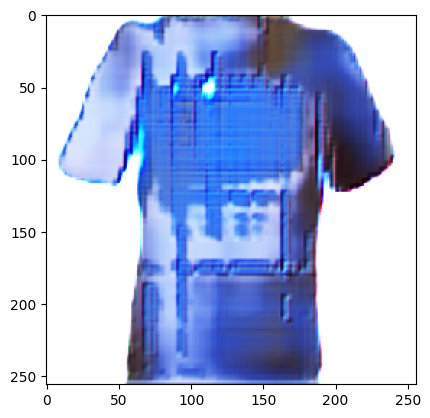

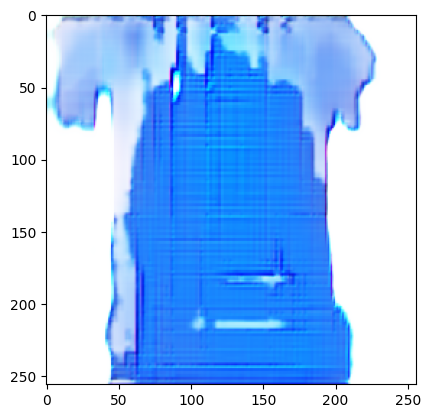

1/1 [==============================] - 0s 35ms/step
D Real: 0.21431933343410492, D Fake: 0.04448293522000313, G All: 3.249622344970703
1/1 [==============================] - 0s 17ms/step
D Real: 0.038775358349084854, D Fake: 0.03611943498253822, G All: 3.975883722305298
1/1 [==============================] - 0s 17ms/step
D Real: 0.16097870469093323, D Fake: 0.03511930629611015, G All: 4.064549446105957
1/1 [==============================] - 0s 18ms/step
D Real: 0.041838109493255615, D Fake: 0.06299535930156708, G All: 4.582904815673828
1/1 [==============================] - 0s 19ms/step
D Real: 0.03877320885658264, D Fake: 0.06687067449092865, G All: 4.351736068725586
1/1 [==============================] - 0s 17ms/step
D Real: 0.03132413327693939, D Fake: 0.12621599435806274, G All: 4.298896789550781
1/1 [==============================] - 0s 18ms/step
D Real: 0.28659534454345703, D Fake: 0.0504675917327404, G All: 3.7861766815185547
1/1 [==============================] - 0s 17ms/step
D

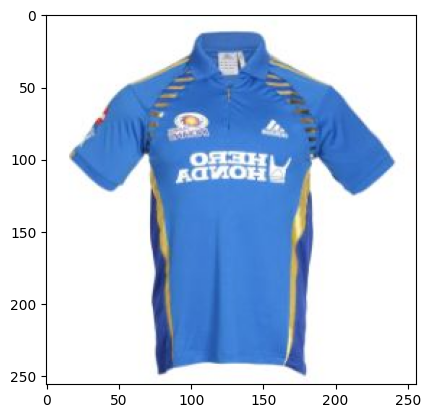

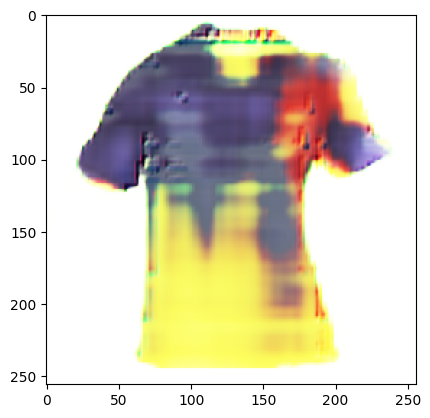

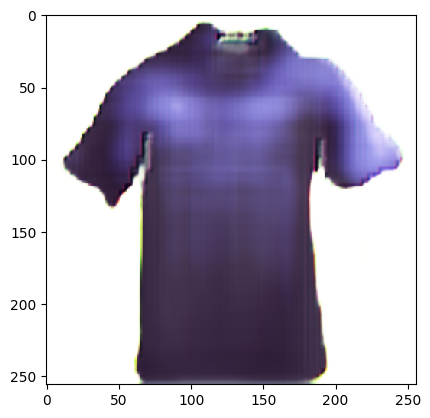

1/1 [==============================] - 0s 27ms/step
D Real: 0.05642576515674591, D Fake: 0.044997382909059525, G All: 3.9285354614257812
1/1 [==============================] - 0s 23ms/step
D Real: 0.05591922253370285, D Fake: 0.04791122302412987, G All: 4.304750442504883
1/1 [==============================] - 0s 21ms/step
D Real: 0.04842747375369072, D Fake: 0.05472187325358391, G All: 4.347829818725586
1/1 [==============================] - 0s 21ms/step
D Real: 0.04060943052172661, D Fake: 0.04490239545702934, G All: 4.164220809936523
1/1 [==============================] - 0s 19ms/step
D Real: 0.03635624796152115, D Fake: 0.04932912439107895, G All: 4.239568710327148
1/1 [==============================] - 0s 30ms/step
D Real: 0.33637258410453796, D Fake: 0.14563025534152985, G All: 3.9850354194641113
1/1 [==============================] - 0s 23ms/step
D Real: 0.04020372033119202, D Fake: 0.08872097730636597, G All: 4.265371799468994
1/1 [==============================] - 0s 22ms/step


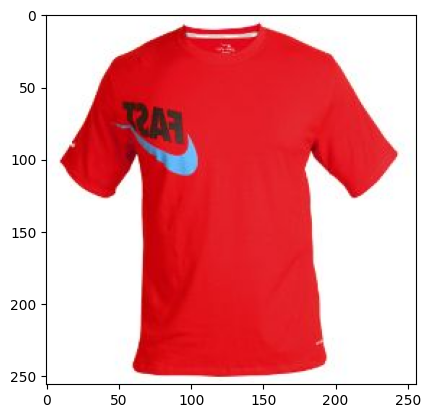

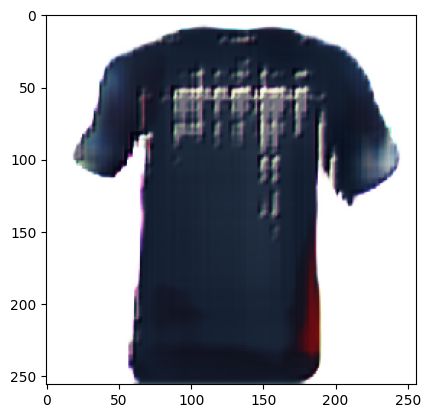

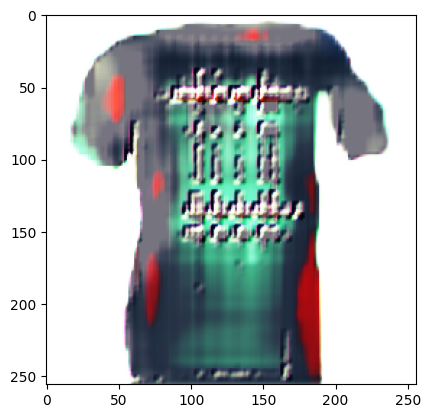

1/1 [==============================] - 0s 18ms/step
D Real: 0.19125042855739594, D Fake: 0.29381248354911804, G All: 2.9193012714385986
1/1 [==============================] - 0s 19ms/step
D Real: 0.03677015006542206, D Fake: 0.12060375511646271, G All: 2.421302318572998
1/1 [==============================] - 0s 19ms/step
D Real: 0.18604156374931335, D Fake: 0.12034440040588379, G All: 2.2910265922546387
1/1 [==============================] - 0s 19ms/step
D Real: 0.03147353604435921, D Fake: 0.2713946998119354, G All: 3.5742571353912354
1/1 [==============================] - 0s 19ms/step
D Real: 0.02974654734134674, D Fake: 0.11382567882537842, G All: 2.6357131004333496
1/1 [==============================] - 0s 27ms/step
D Real: 0.040095116943120956, D Fake: 0.10799922049045563, G All: 2.792379379272461
1/1 [==============================] - 0s 20ms/step
D Real: 0.3722972273826599, D Fake: 0.05928916111588478, G All: 3.0697762966156006
1/1 [==============================] - 0s 19ms/step

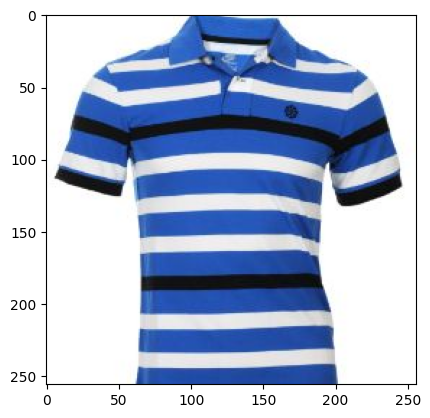

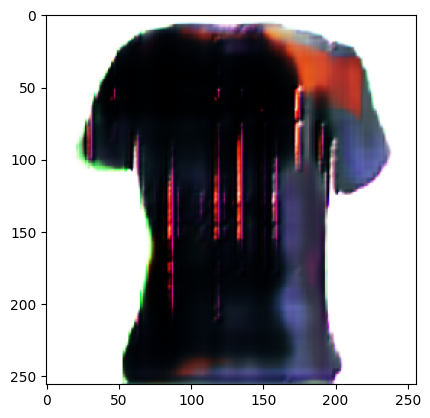

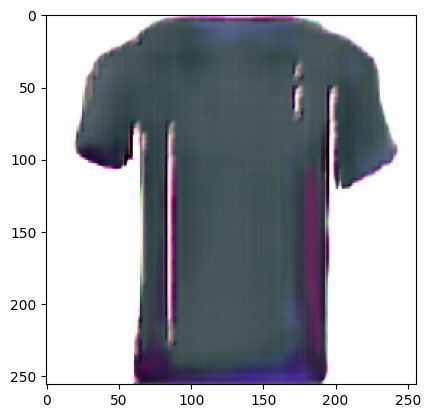

1/1 [==============================] - 0s 19ms/step
D Real: 0.035787880420684814, D Fake: 0.1711212396621704, G All: 2.770317792892456
1/1 [==============================] - 0s 18ms/step
D Real: 0.1580195426940918, D Fake: 0.7562400102615356, G All: 3.8795313835144043
1/1 [==============================] - 0s 18ms/step
D Real: 0.036900587379932404, D Fake: 0.040252935141325, G All: 4.0709428787231445
1/1 [==============================] - 0s 19ms/step
D Real: 0.0865589901804924, D Fake: 0.032284658402204514, G All: 4.808300018310547
1/1 [==============================] - 0s 18ms/step
D Real: 0.04754646494984627, D Fake: 0.05418164283037186, G All: 4.468561172485352
1/1 [==============================] - 0s 26ms/step
D Real: 0.05926497280597687, D Fake: 0.03973621502518654, G All: 5.317597389221191
1/1 [==============================] - 0s 19ms/step
D Real: 0.04051842540502548, D Fake: 0.03754650056362152, G All: 5.592490196228027
1/1 [==============================] - 0s 18ms/step
D Re

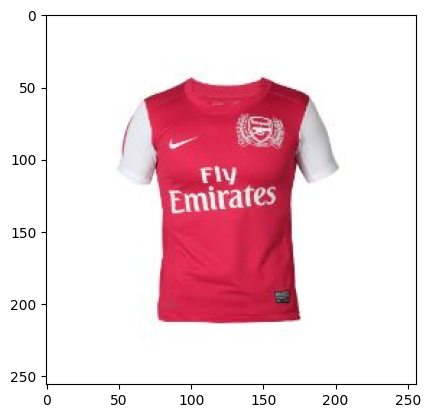

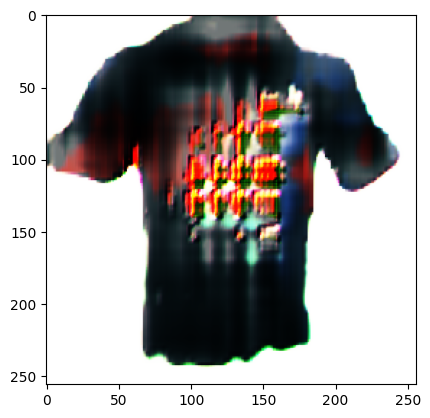

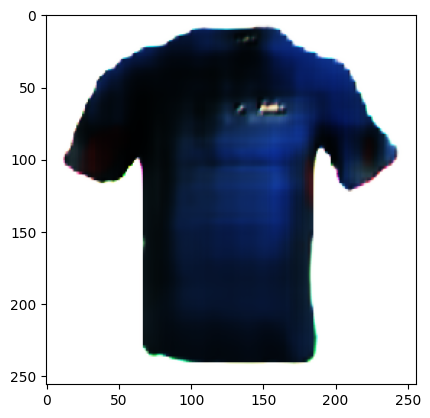

1/1 [==============================] - 0s 19ms/step
D Real: 0.05469226837158203, D Fake: 0.04349186271429062, G All: 3.81976318359375
1/1 [==============================] - 0s 18ms/step
D Real: 0.058191098272800446, D Fake: 0.03797263652086258, G All: 3.9458329677581787
1/1 [==============================] - 0s 19ms/step
D Real: 0.04485438019037247, D Fake: 0.06362730264663696, G All: 4.552907943725586
1/1 [==============================] - 0s 18ms/step
D Real: 0.033181726932525635, D Fake: 0.09979918599128723, G All: 4.61063289642334
1/1 [==============================] - 0s 19ms/step
D Real: 0.03391876071691513, D Fake: 0.05433398857712746, G All: 5.2825493812561035
1/1 [==============================] - 0s 19ms/step
D Real: 0.039164528250694275, D Fake: 0.07327064126729965, G All: 5.72183084487915
1/1 [==============================] - 0s 18ms/step
D Real: 0.06182750314474106, D Fake: 0.043222151696681976, G All: 5.239360332489014
1/1 [==============================] - 0s 30ms/step


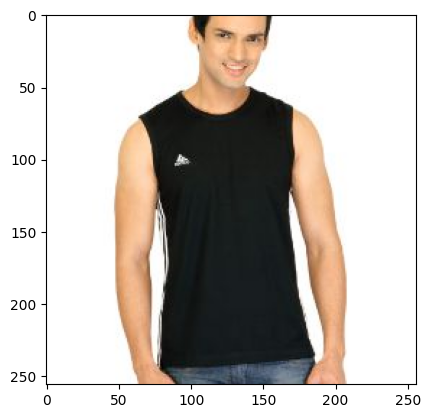

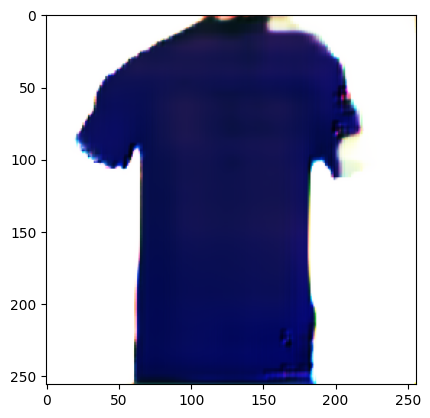

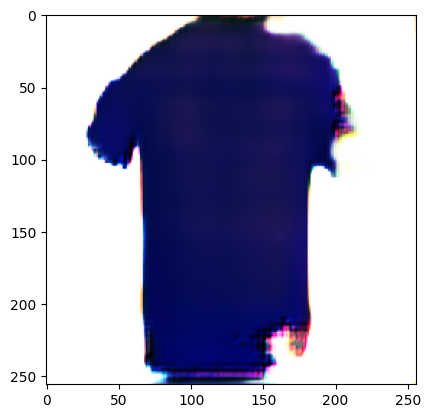

1/1 [==============================] - 0s 19ms/step
D Real: 0.04991036653518677, D Fake: 0.07269829511642456, G All: 3.529268741607666
1/1 [==============================] - 0s 19ms/step
D Real: 0.043870359659194946, D Fake: 0.06333157420158386, G All: 3.355125904083252
1/1 [==============================] - 0s 19ms/step
D Real: 0.0508180633187294, D Fake: 0.03883514925837517, G All: 3.2607321739196777
1/1 [==============================] - 0s 17ms/step
D Real: 0.059481337666511536, D Fake: 0.08563439548015594, G All: 3.986502170562744
1/1 [==============================] - 0s 19ms/step
D Real: 0.05545012652873993, D Fake: 0.10954291373491287, G All: 3.681001901626587
1/1 [==============================] - 0s 18ms/step
D Real: 0.04166814684867859, D Fake: 0.04064227640628815, G All: 4.358466625213623
1/1 [==============================] - 0s 18ms/step
D Real: 0.37306076288223267, D Fake: 0.048467084765434265, G All: 4.062132835388184
1/1 [==============================] - 0s 19ms/step


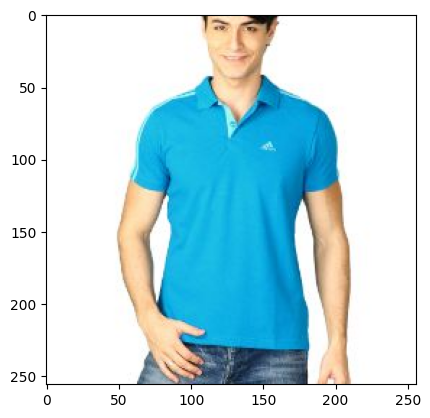

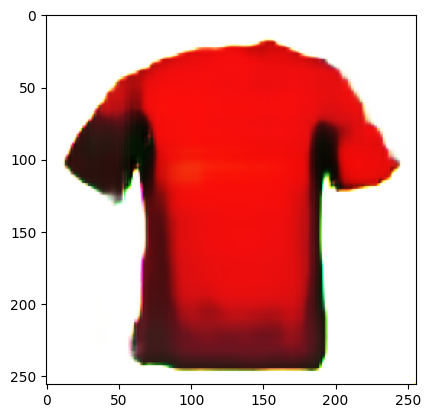

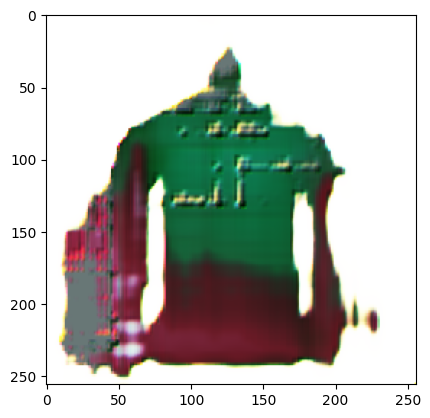

1/1 [==============================] - 0s 19ms/step
D Real: 0.07686184346675873, D Fake: 0.02409074269235134, G All: 7.038071632385254
1/1 [==============================] - 0s 18ms/step
D Real: 0.7117109894752502, D Fake: 0.08665236830711365, G All: 5.446969985961914
1/1 [==============================] - 0s 19ms/step
D Real: 0.5655455589294434, D Fake: 0.03314662724733353, G All: 4.639852523803711
1/1 [==============================] - 0s 22ms/step
D Real: 0.06856478005647659, D Fake: 0.038886770606040955, G All: 3.1654326915740967
1/1 [==============================] - 0s 19ms/step
D Real: 0.09137757122516632, D Fake: 0.06761514395475388, G All: 2.723642349243164
1/1 [==============================] - 0s 18ms/step
D Real: 0.05526356026530266, D Fake: 0.3510303497314453, G All: 2.8788840770721436
1/1 [==============================] - 0s 18ms/step
D Real: 0.0807296484708786, D Fake: 0.04962191730737686, G All: 3.1123342514038086
1/1 [==============================] - 0s 18ms/step
D R

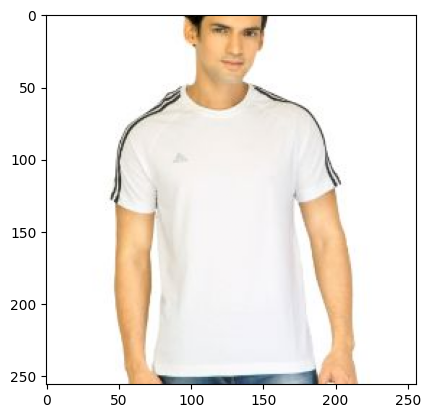

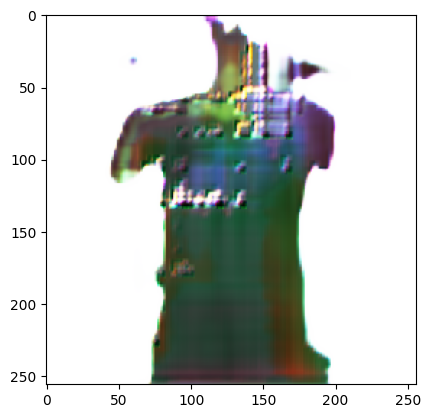

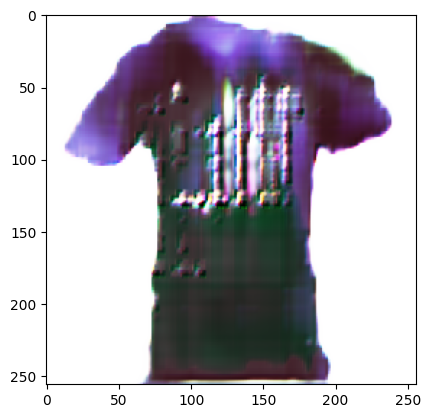

1/1 [==============================] - 0s 19ms/step
D Real: 0.0493244007229805, D Fake: 0.10427035391330719, G All: 4.861881732940674
1/1 [==============================] - 0s 17ms/step
D Real: 0.05735178291797638, D Fake: 0.10959411412477493, G All: 5.072037696838379
1/1 [==============================] - 0s 18ms/step
D Real: 4.103081703186035, D Fake: 0.04302719980478287, G All: 3.539924383163452
1/1 [==============================] - 0s 17ms/step
D Real: 0.2790466845035553, D Fake: 0.454330176115036, G All: 3.2099385261535645
1/1 [==============================] - 0s 19ms/step
D Real: 0.038235366344451904, D Fake: 0.15163037180900574, G All: 3.096426248550415
1/1 [==============================] - 0s 18ms/step
D Real: 0.02984486147761345, D Fake: 0.10965325683355331, G All: 3.034026861190796
1/1 [==============================] - 0s 19ms/step
D Real: 0.04638005793094635, D Fake: 0.45332852005958557, G All: 3.5323328971862793
1/1 [==============================] - 0s 20ms/step
D Real

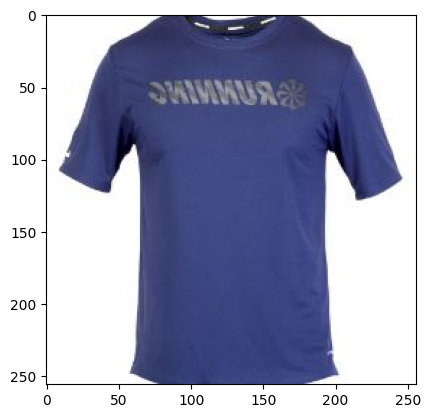

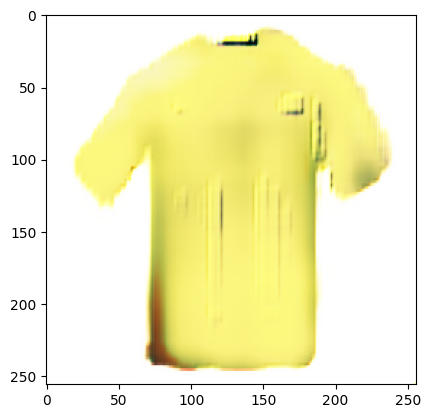

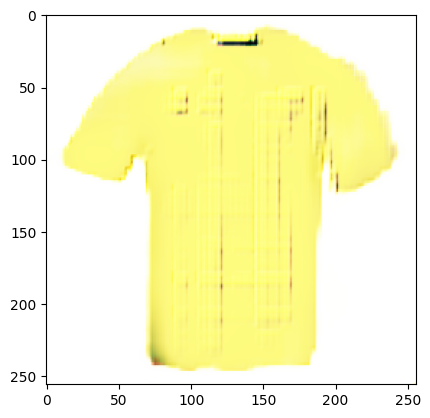

1/1 [==============================] - 0s 18ms/step
D Real: 0.13303057849407196, D Fake: 0.17721900343894958, G All: 4.923542022705078
1/1 [==============================] - 0s 18ms/step
D Real: 0.03591064736247063, D Fake: 0.3690849542617798, G All: 4.956626892089844
1/1 [==============================] - 0s 17ms/step
D Real: 0.05197189375758171, D Fake: 0.031042974442243576, G All: 4.650908470153809
1/1 [==============================] - 0s 17ms/step
D Real: 0.04932776093482971, D Fake: 0.033093057572841644, G All: 4.95145320892334
1/1 [==============================] - 0s 19ms/step
D Real: 0.10454254597425461, D Fake: 0.0405498668551445, G All: 4.954537391662598
1/1 [==============================] - 0s 19ms/step
D Real: 0.05632910132408142, D Fake: 0.04129189997911453, G All: 4.379931449890137
1/1 [==============================] - 0s 20ms/step
D Real: 0.05062191188335419, D Fake: 0.04709570109844208, G All: 5.134767055511475
1/1 [==============================] - 0s 19ms/step
D Re

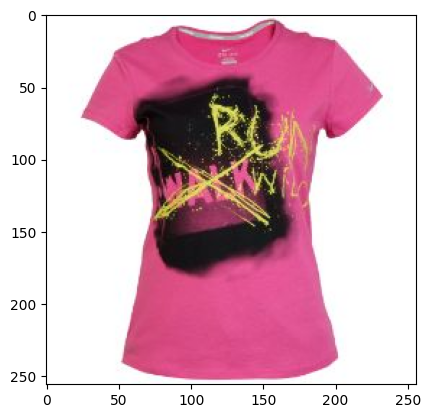

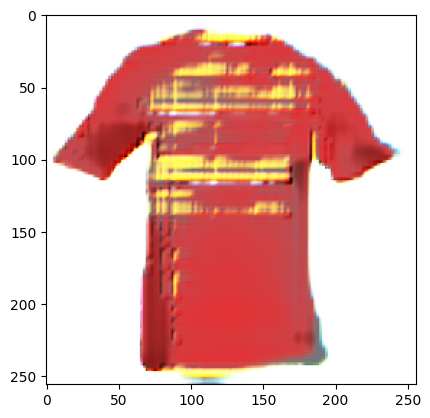

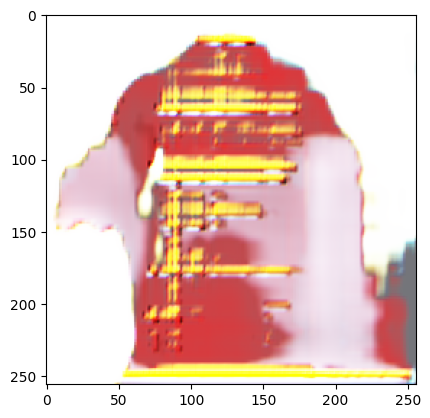

1/1 [==============================] - 0s 19ms/step
D Real: 0.07628010958433151, D Fake: 0.18979105353355408, G All: 3.6389122009277344
1/1 [==============================] - 0s 19ms/step
D Real: 0.04524626582860947, D Fake: 0.047324977815151215, G All: 4.352231979370117
1/1 [==============================] - 0s 18ms/step
D Real: 0.03890795260667801, D Fake: 0.039897821843624115, G All: 3.540709972381592
1/1 [==============================] - 0s 19ms/step
D Real: 0.031125914305448532, D Fake: 0.03839380666613579, G All: 4.06208610534668
1/1 [==============================] - 0s 18ms/step
D Real: 0.17060023546218872, D Fake: 0.17933246493339539, G All: 4.44120454788208
1/1 [==============================] - 0s 18ms/step
D Real: 0.052350156009197235, D Fake: 0.09693916141986847, G All: 3.6560747623443604
1/1 [==============================] - 0s 20ms/step
D Real: 1.6633397340774536, D Fake: 0.09055808186531067, G All: 3.3623173236846924
1/1 [==============================] - 0s 19ms/step

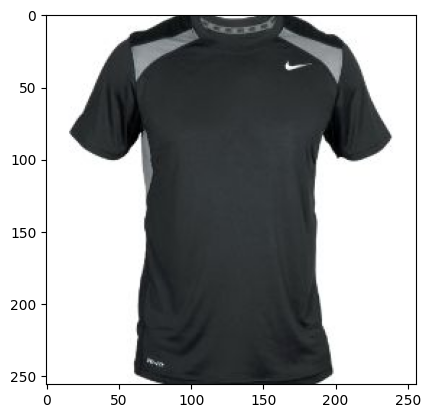

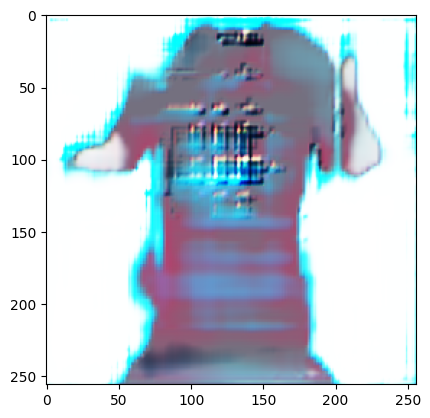

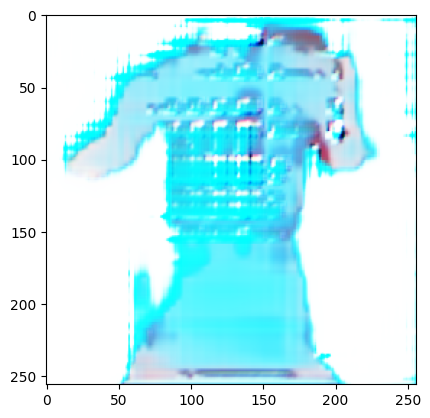

1/1 [==============================] - 0s 18ms/step
D Real: 0.052865996956825256, D Fake: 0.10098370909690857, G All: 4.530386924743652
1/1 [==============================] - 0s 20ms/step
D Real: 0.09310092031955719, D Fake: 0.038234710693359375, G All: 5.657715797424316
1/1 [==============================] - 0s 18ms/step
D Real: 0.2696090340614319, D Fake: 0.04800185188651085, G All: 5.98069429397583
1/1 [==============================] - 0s 19ms/step
D Real: 0.03894549608230591, D Fake: 0.0562300831079483, G All: 6.061622619628906
1/1 [==============================] - 0s 19ms/step
D Real: 0.05927492678165436, D Fake: 0.05294880270957947, G All: 5.334900856018066
1/1 [==============================] - 0s 20ms/step
D Real: 0.43488073348999023, D Fake: 0.05827154964208603, G All: 4.646430015563965
1/1 [==============================] - 0s 19ms/step
D Real: 0.08266352117061615, D Fake: 0.051601290702819824, G All: 5.52790641784668
1/1 [==============================] - 0s 19ms/step
D Re

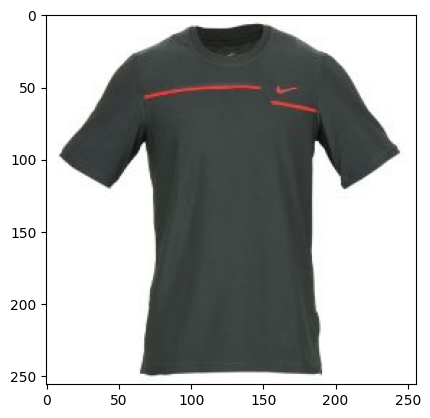

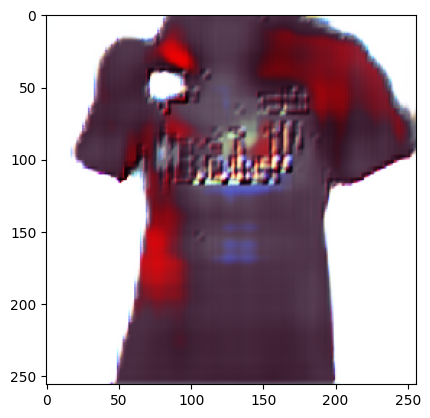

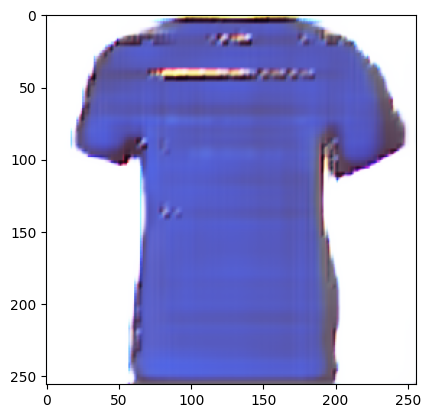

1/1 [==============================] - 0s 19ms/step
D Real: 0.0570831261575222, D Fake: 0.12600240111351013, G All: 3.488476276397705
1/1 [==============================] - 0s 19ms/step
D Real: 0.107977956533432, D Fake: 0.11898572742938995, G All: 3.23929500579834
1/1 [==============================] - 0s 18ms/step
D Real: 0.061614926904439926, D Fake: 0.05807143449783325, G All: 3.6038050651550293
1/1 [==============================] - 0s 30ms/step
D Real: 0.05683232843875885, D Fake: 0.05671975016593933, G All: 3.1073546409606934
1/1 [==============================] - 0s 18ms/step
D Real: 0.05341257154941559, D Fake: 0.0679122805595398, G All: 3.1264755725860596
1/1 [==============================] - 0s 19ms/step
D Real: 0.06920332461595535, D Fake: 0.2665351629257202, G All: 3.000917434692383
1/1 [==============================] - 0s 19ms/step
D Real: 0.08269260823726654, D Fake: 0.18639859557151794, G All: 3.5314927101135254
1/1 [==============================] - 0s 18ms/step
D Re

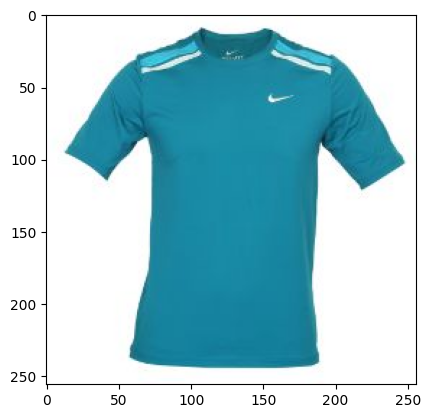

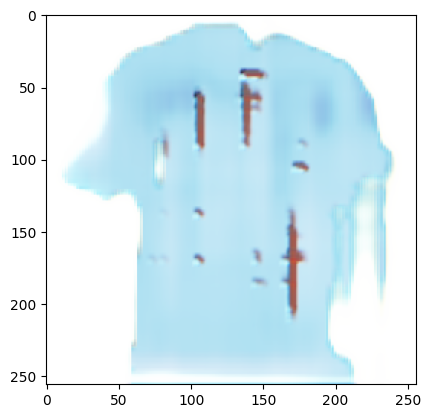

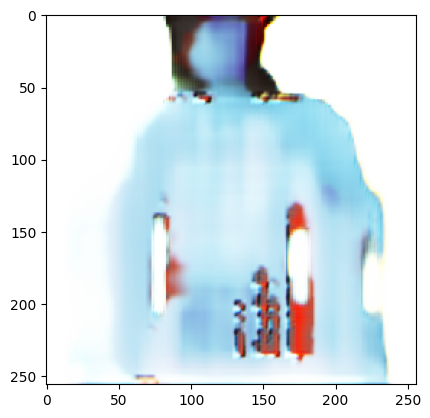

1/1 [==============================] - 0s 19ms/step
D Real: 0.052331771701574326, D Fake: 0.3247471749782562, G All: 3.243408441543579
1/1 [==============================] - 0s 21ms/step
D Real: 0.21597574651241302, D Fake: 0.09004030376672745, G All: 4.36942720413208
1/1 [==============================] - 0s 18ms/step
D Real: 0.05251147970557213, D Fake: 0.10378310829401016, G All: 4.688689231872559
1/1 [==============================] - 0s 18ms/step
D Real: 0.0726790502667427, D Fake: 0.0734611377120018, G All: 4.815672874450684
1/1 [==============================] - 0s 48ms/step
D Real: 0.07257082313299179, D Fake: 0.036523230373859406, G All: 5.285749912261963
1/1 [==============================] - 0s 19ms/step
D Real: 0.053181134164333344, D Fake: 0.060123659670352936, G All: 6.389365196228027
1/1 [==============================] - 0s 21ms/step
D Real: 0.08459416031837463, D Fake: 0.03520139679312706, G All: 7.077663898468018
1/1 [==============================] - 0s 19ms/step
D R

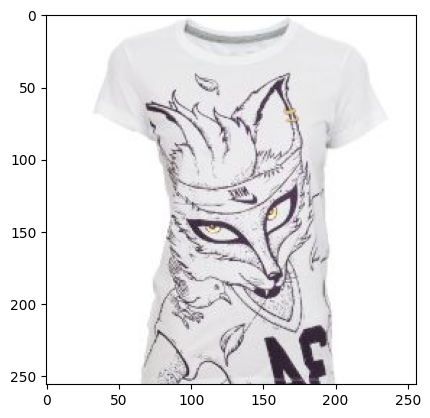

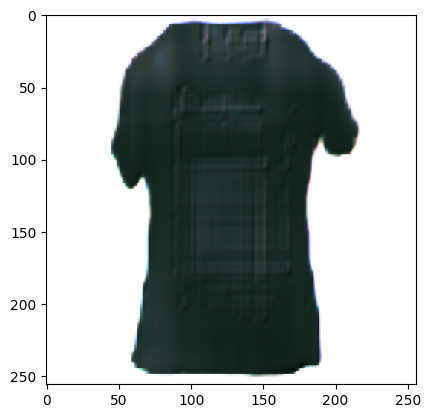

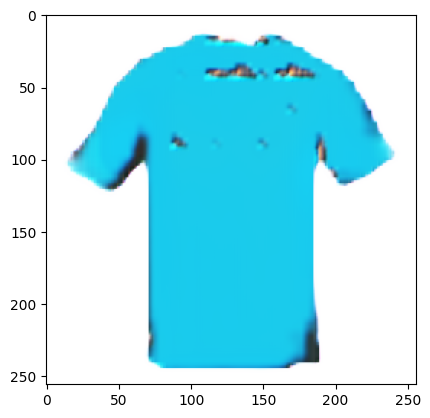

1/1 [==============================] - 0s 18ms/step
D Real: 2.004142999649048, D Fake: 0.11612113565206528, G All: 2.1726250648498535
1/1 [==============================] - 0s 19ms/step
D Real: 0.1877993494272232, D Fake: 0.7585693597793579, G All: 1.8588380813598633
1/1 [==============================] - 0s 17ms/step
D Real: 0.04551307111978531, D Fake: 0.19049327075481415, G All: 1.7819745540618896
1/1 [==============================] - 0s 19ms/step
D Real: 0.07516513019800186, D Fake: 0.4199788272380829, G All: 2.5621087551116943
1/1 [==============================] - 0s 19ms/step
D Real: 0.08255961537361145, D Fake: 0.20404145121574402, G All: 2.7792627811431885
1/1 [==============================] - 0s 18ms/step
D Real: 0.058822695165872574, D Fake: 0.1599593311548233, G All: 3.459111452102661
1/1 [==============================] - 0s 18ms/step
D Real: 0.04334450513124466, D Fake: 0.06179644167423248, G All: 4.249704360961914
1/1 [==============================] - 0s 18ms/step
D R

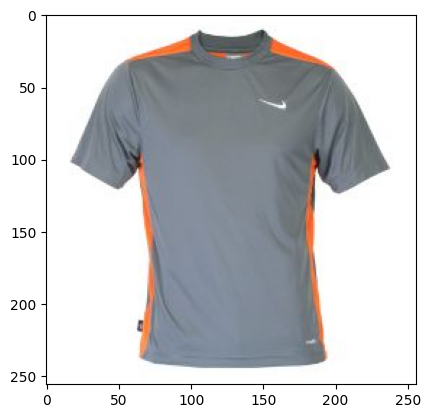

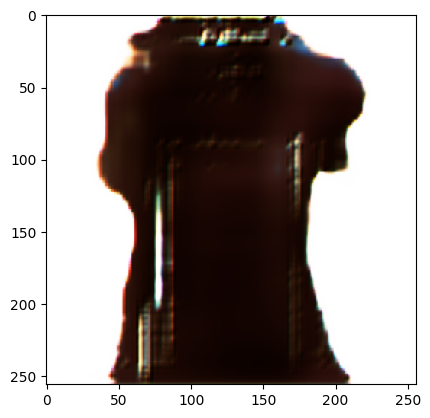

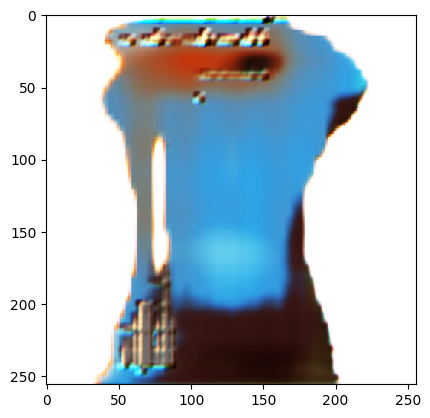

1/1 [==============================] - 0s 19ms/step
D Real: 0.03907332569360733, D Fake: 0.03846663981676102, G All: 4.568958759307861
1/1 [==============================] - 0s 18ms/step
D Real: 0.04604870080947876, D Fake: 0.07543338090181351, G All: 5.214489936828613
1/1 [==============================] - 0s 19ms/step
D Real: 1.0231444835662842, D Fake: 0.04793388396501541, G All: 4.04463005065918
1/1 [==============================] - 0s 19ms/step
D Real: 0.044353194534778595, D Fake: 0.05602877587080002, G All: 3.7412142753601074
1/1 [==============================] - 0s 19ms/step
D Real: 0.03893047198653221, D Fake: 0.10237018764019012, G All: 3.5301175117492676
1/1 [==============================] - 0s 18ms/step
D Real: 0.042717576026916504, D Fake: 0.2698915898799896, G All: 3.844573736190796
1/1 [==============================] - 0s 18ms/step
D Real: 0.05974039062857628, D Fake: 0.09233884513378143, G All: 2.9764397144317627
1/1 [==============================] - 0s 36ms/step
D

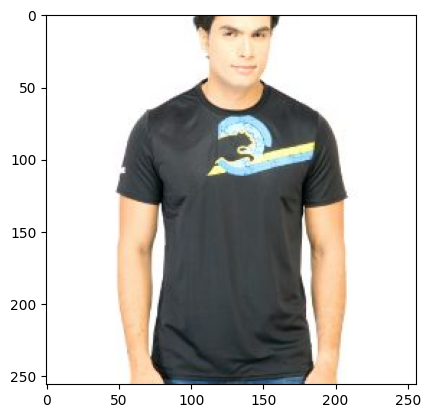

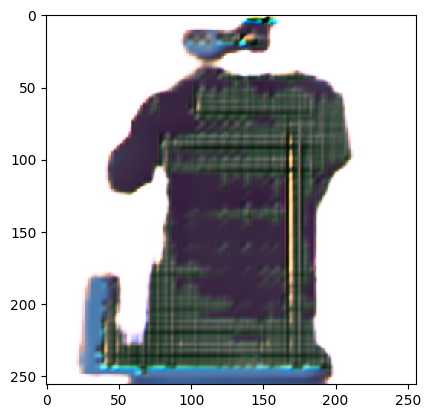

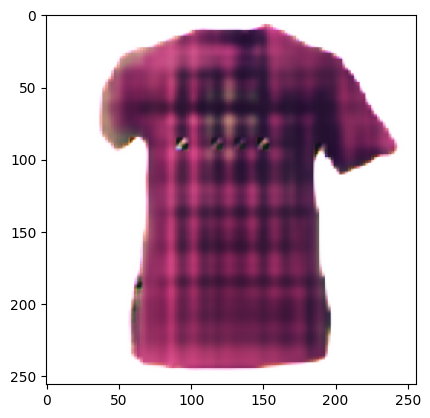

1/1 [==============================] - 0s 21ms/step
D Real: 0.18145674467086792, D Fake: 0.11207681894302368, G All: 4.537675857543945
1/1 [==============================] - 0s 19ms/step
D Real: 0.044299498200416565, D Fake: 0.07654863595962524, G All: 5.399184703826904
1/1 [==============================] - 0s 20ms/step
D Real: 0.03999931365251541, D Fake: 0.03575008362531662, G All: 4.5474348068237305
1/1 [==============================] - 0s 20ms/step
D Real: 0.6521541476249695, D Fake: 0.06396125257015228, G All: 4.707721710205078
1/1 [==============================] - 0s 20ms/step
D Real: 1.4488649368286133, D Fake: 0.03628959506750107, G All: 4.034901142120361
1/1 [==============================] - 0s 21ms/step
D Real: 0.6147811412811279, D Fake: 0.19654816389083862, G All: 2.938333034515381
1/1 [==============================] - 0s 21ms/step
D Real: 0.03432086855173111, D Fake: 0.04456319659948349, G All: 2.6946468353271484
1/1 [==============================] - 0s 20ms/step
D R

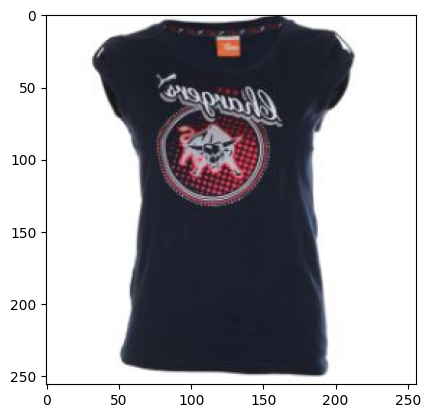

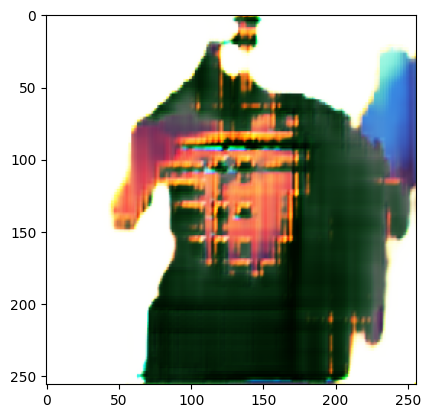

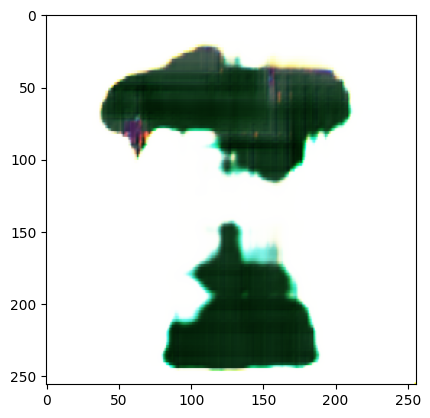

1/1 [==============================] - 0s 18ms/step
D Real: 0.1791977882385254, D Fake: 0.5820873379707336, G All: 2.0590667724609375
1/1 [==============================] - 0s 19ms/step
D Real: 0.04565802589058876, D Fake: 0.07042277604341507, G All: 2.839662551879883
1/1 [==============================] - 0s 17ms/step
D Real: 0.0395614430308342, D Fake: 0.05573282390832901, G All: 2.5188889503479004
1/1 [==============================] - 0s 19ms/step
D Real: 0.07666508853435516, D Fake: 0.47562307119369507, G All: 3.8848233222961426
1/1 [==============================] - 0s 19ms/step
D Real: 0.0563485287129879, D Fake: 0.13332170248031616, G All: 3.5873661041259766
1/1 [==============================] - 0s 24ms/step
D Real: 0.050145670771598816, D Fake: 0.04282300919294357, G All: 4.773792266845703
1/1 [==============================] - 0s 19ms/step
D Real: 0.043073877692222595, D Fake: 0.024867169559001923, G All: 4.861714839935303
1/1 [==============================] - 0s 18ms/step


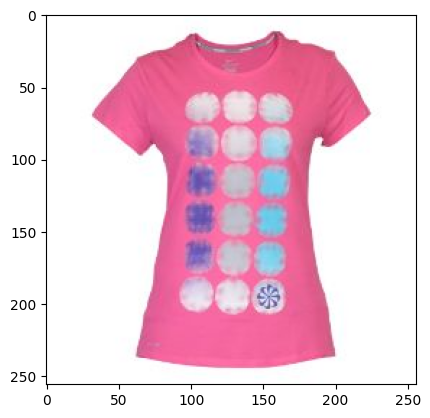

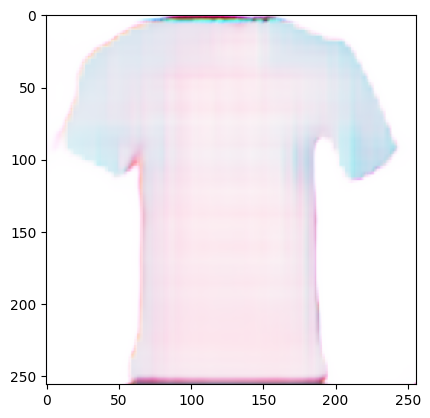

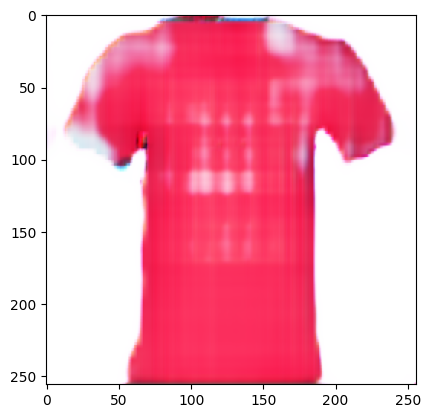

1/1 [==============================] - 0s 20ms/step
D Real: 0.03109380044043064, D Fake: 0.05718892067670822, G All: 3.808939218521118
1/1 [==============================] - 0s 20ms/step
D Real: 0.06394409388303757, D Fake: 0.033659372478723526, G All: 4.8391313552856445
1/1 [==============================] - 0s 21ms/step
D Real: 0.044558390974998474, D Fake: 0.12549355626106262, G All: 3.7426202297210693
1/1 [==============================] - 0s 21ms/step
D Real: 0.06480540335178375, D Fake: 0.041619524359703064, G All: 4.718837738037109
1/1 [==============================] - 0s 20ms/step
D Real: 0.041256263852119446, D Fake: 0.03850165754556656, G All: 4.527707099914551
1/1 [==============================] - 0s 21ms/step
D Real: 0.6940501928329468, D Fake: 0.040930524468421936, G All: 4.875344753265381
1/1 [==============================] - 0s 19ms/step
D Real: 0.04653487727046013, D Fake: 0.1317671835422516, G All: 3.3307974338531494
1/1 [==============================] - 0s 21ms/st

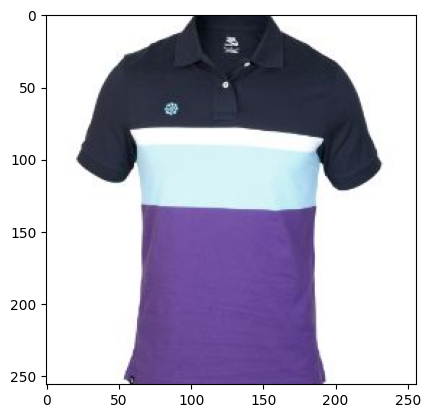

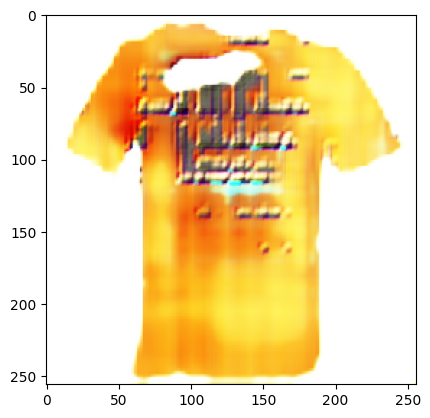

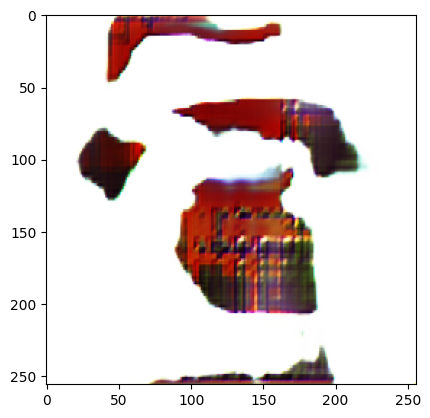

1/1 [==============================] - 0s 18ms/step
D Real: 0.3373457193374634, D Fake: 0.04059332609176636, G All: 3.2056117057800293
1/1 [==============================] - 0s 19ms/step
D Real: 0.0940430760383606, D Fake: 0.1024528369307518, G All: 3.9371700286865234
1/1 [==============================] - 0s 18ms/step
D Real: 0.031177807599306107, D Fake: 0.2225669026374817, G All: 3.946145534515381
1/1 [==============================] - 0s 22ms/step
D Real: 0.9989877343177795, D Fake: 0.03984355181455612, G All: 4.160768508911133
1/1 [==============================] - 0s 20ms/step
D Real: 0.05845482647418976, D Fake: 0.03876655548810959, G All: 3.9726662635803223
1/1 [==============================] - 0s 23ms/step
D Real: 0.05098925158381462, D Fake: 0.0374712198972702, G All: 4.0004353523254395
1/1 [==============================] - 0s 20ms/step
D Real: 0.4603145122528076, D Fake: 0.08764177560806274, G All: 2.1892547607421875
1/1 [==============================] - 0s 18ms/step
D Re

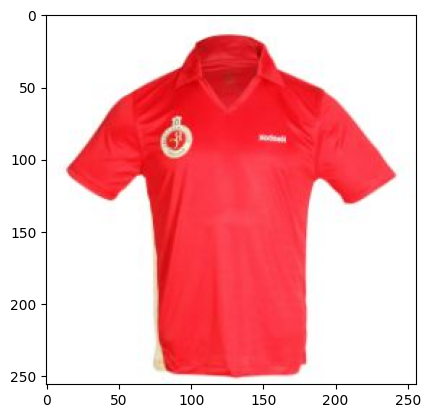

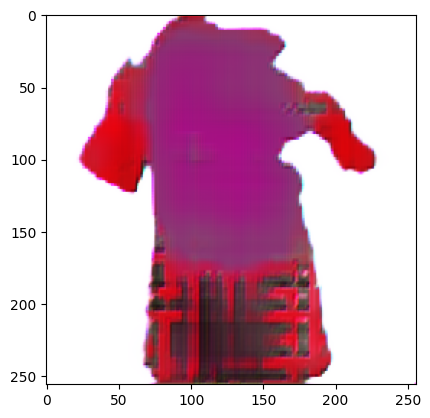

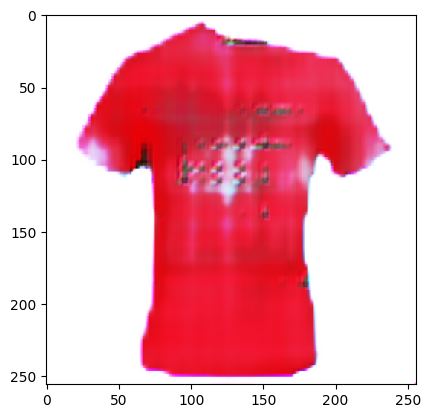

1/1 [==============================] - 0s 19ms/step
D Real: 0.03377077728509903, D Fake: 0.04310230538249016, G All: 4.267176628112793
1/1 [==============================] - 0s 18ms/step
D Real: 0.036458343267440796, D Fake: 0.07923270761966705, G All: 4.779479503631592
1/1 [==============================] - 0s 19ms/step
D Real: 0.23259104788303375, D Fake: 0.04966078698635101, G All: 3.8448808193206787
1/1 [==============================] - 0s 19ms/step
D Real: 0.0871504545211792, D Fake: 0.029522597789764404, G All: 4.59199857711792
1/1 [==============================] - 0s 18ms/step
D Real: 0.04182513803243637, D Fake: 0.1746886670589447, G All: 4.277865409851074
1/1 [==============================] - 0s 17ms/step
D Real: 0.6382699608802795, D Fake: 0.034012340009212494, G All: 4.14633846282959
1/1 [==============================] - 0s 18ms/step
D Real: 0.03381370007991791, D Fake: 0.03185012564063072, G All: 3.691690683364868
1/1 [==============================] - 0s 19ms/step
D Re

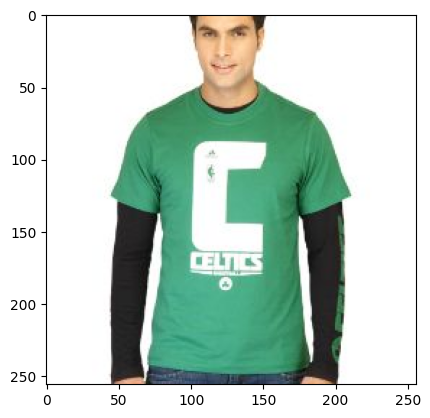

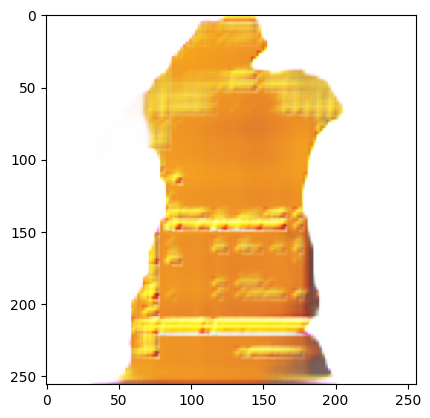

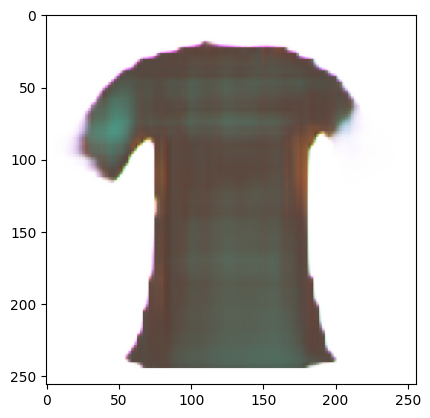

1/1 [==============================] - 0s 23ms/step
D Real: 0.041231222450733185, D Fake: 0.050226353108882904, G All: 4.145299911499023
1/1 [==============================] - 0s 21ms/step
D Real: 0.07329516112804413, D Fake: 0.05794573575258255, G All: 3.992462635040283
1/1 [==============================] - 0s 21ms/step
D Real: 0.3780333995819092, D Fake: 0.1162186786532402, G All: 5.81922721862793
1/1 [==============================] - 0s 21ms/step
D Real: 0.04933880269527435, D Fake: 0.05073263868689537, G All: 4.80783748626709
1/1 [==============================] - 0s 21ms/step
D Real: 0.17349329590797424, D Fake: 0.07025878131389618, G All: 5.2198381423950195
1/1 [==============================] - 0s 20ms/step
D Real: 0.09694169461727142, D Fake: 0.0392034649848938, G All: 5.352927207946777
1/1 [==============================] - 0s 20ms/step
D Real: 0.08236623555421829, D Fake: 0.04586184769868851, G All: 4.679689407348633
1/1 [==============================] - 0s 21ms/step
D Rea

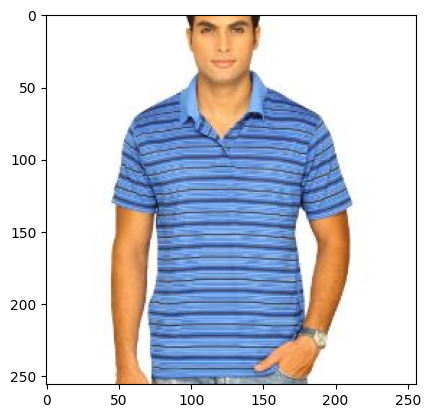

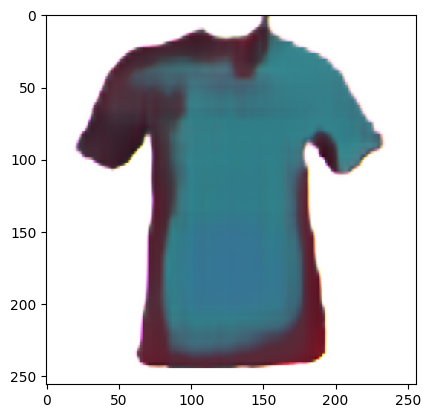

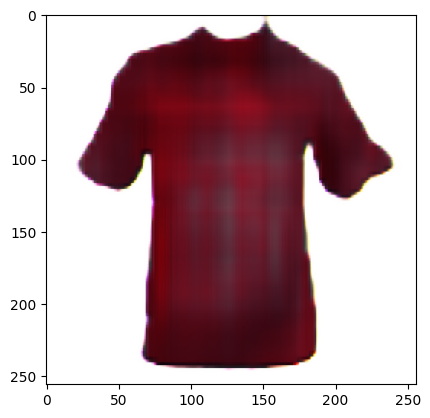

1/1 [==============================] - 0s 19ms/step
D Real: 0.024560723453760147, D Fake: 0.14217862486839294, G All: 2.1043436527252197
1/1 [==============================] - 0s 19ms/step
D Real: 0.052967511117458344, D Fake: 0.1421608030796051, G All: 2.6344504356384277
1/1 [==============================] - 0s 20ms/step
D Real: 0.052617769688367844, D Fake: 0.08706066757440567, G All: 2.396085739135742
1/1 [==============================] - 0s 19ms/step
D Real: 0.04696749895811081, D Fake: 0.2220379114151001, G All: 3.1600775718688965
1/1 [==============================] - 0s 19ms/step
D Real: 0.07453673332929611, D Fake: 0.32309404015541077, G All: 3.4136438369750977
1/1 [==============================] - 0s 20ms/step
D Real: 0.06437798589468002, D Fake: 0.0751735121011734, G All: 4.8208208084106445
1/1 [==============================] - 0s 19ms/step
D Real: 0.09252660721540451, D Fake: 0.036962997168302536, G All: 4.348540782928467
1/1 [==============================] - 0s 19ms/st

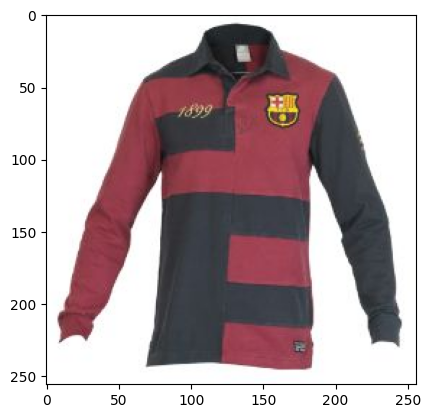

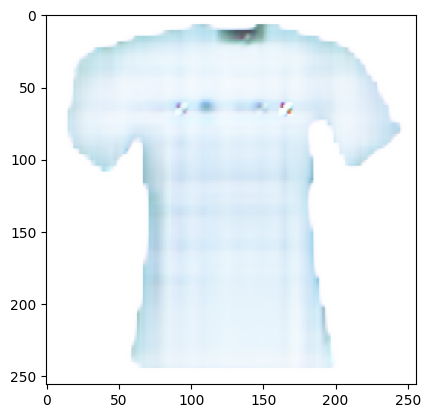

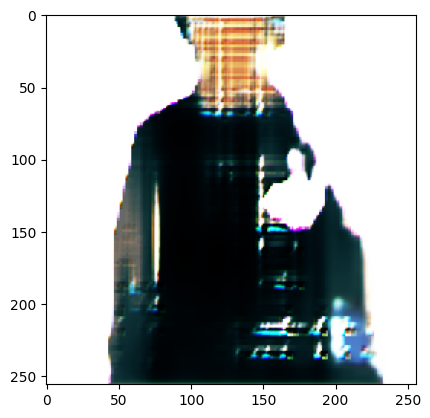

1/1 [==============================] - 0s 18ms/step
D Real: 0.026583760976791382, D Fake: 0.07906314730644226, G All: 4.180897235870361
1/1 [==============================] - 0s 18ms/step
D Real: 1.752699375152588, D Fake: 0.14729467034339905, G All: 3.953068256378174
1/1 [==============================] - 0s 19ms/step
D Real: 0.05679266154766083, D Fake: 0.17310459911823273, G All: 2.9941511154174805
1/1 [==============================] - 0s 18ms/step
D Real: 0.03638231009244919, D Fake: 0.06100202724337578, G All: 3.5161566734313965
1/1 [==============================] - 0s 18ms/step
D Real: 0.05306113511323929, D Fake: 0.05887995660305023, G All: 3.7061619758605957
1/1 [==============================] - 0s 20ms/step
D Real: 0.04576193913817406, D Fake: 0.12039835751056671, G All: 3.6150035858154297
1/1 [==============================] - 0s 19ms/step
D Real: 0.051815107464790344, D Fake: 0.03195887431502342, G All: 3.5158679485321045
1/1 [==============================] - 0s 19ms/ste

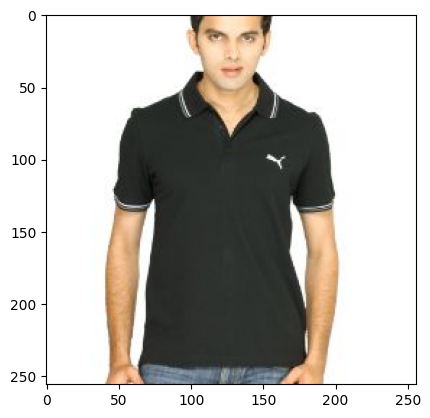

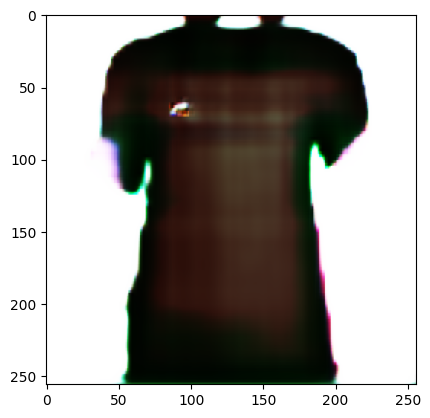

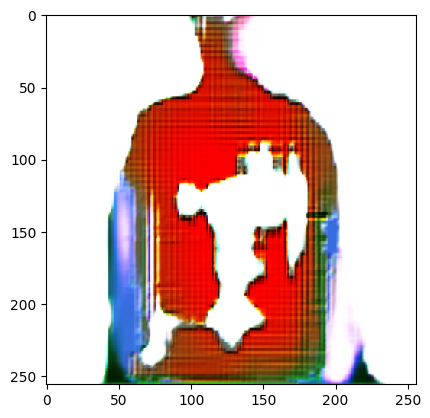

1/1 [==============================] - 0s 20ms/step
D Real: 0.5745012760162354, D Fake: 0.050051700323820114, G All: 5.631520748138428
1/1 [==============================] - 0s 22ms/step
D Real: 0.20254682004451752, D Fake: 0.04073842987418175, G All: 6.36417293548584
1/1 [==============================] - 0s 23ms/step
D Real: 1.5241320133209229, D Fake: 0.0237446092069149, G All: 5.873788833618164
1/1 [==============================] - 0s 22ms/step
D Real: 1.3633184432983398, D Fake: 0.035264402627944946, G All: 4.7426605224609375
1/1 [==============================] - 0s 22ms/step
D Real: 0.036990247666835785, D Fake: 0.036530088633298874, G All: 4.2130913734436035
1/1 [==============================] - 0s 22ms/step
D Real: 0.042635150253772736, D Fake: 0.040039148181676865, G All: 3.1535162925720215
1/1 [==============================] - 0s 21ms/step
D Real: 0.05142980068922043, D Fake: 0.11036060750484467, G All: 3.7162227630615234
1/1 [==============================] - 0s 20ms/ste

In [ ]:
#if training new model:
model = Model_GAN()
model.GAN.D.summary()
model.GAN.G.summary()

print("We're off! See you in a while!")
#model.GAN.steps = 165001
while(model.GAN.steps < 900000):

    #print("\n\n\n\nRound " + str(model.GAN.steps) + ":")
    model.train()
    if model.GAN.steps % 500 == 0:
        print("\nRound: " + str(model.GAN.steps))

    if model.GAN.steps % 1000 == 0:
        print("\n\n\n\nRound " + str(model.GAN.steps) + ":")
        model.eval2(int(model.GAN.steps / 1000))


# Test de génération

Pour générer une image à l'aide du modèle,charger les poids du générateur à partir de "gen.h5". Le faire à l'aide de la fonction load_model

1/1 [==============================] - 0s 196ms/step


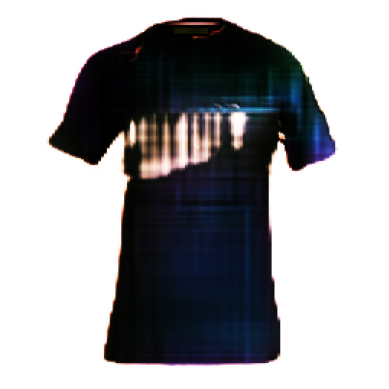

In [ ]:
from keras.layers import Input
from keras.models import load_model

# Instancier la classe GAN
gan_instance = GAN()

# Construire le modèle génératif (sans spécifier la forme des données en entrée)
generator_model = gan_instance.generator()

# Charger les poids du modèle
generator_model.load_weights("/content/drive/MyDrive/GAN_mardi/Models/gen413.h5")

# Générer une image avec le modèle chargé
generated_image = generator_model.predict(noise(1))  # Génère une seule image

# Afficher l'image générée
plt.imshow(generated_image[0])
plt.axis('off')  # Pour désactiver les axes
plt.show()

# Fermeture de l'instance Google Collab

In [ ]:
from google.colab import runtime
runtime.unassign()